In [ ]:
import os
import warnings

import numpy as np
import pandas as pd
import scipy

In [ ]:
warnings.filterwarnings("ignore")

In [ ]:
import seaborn as sns

sns.set_style("white")

In [ ]:
from signature_validation.plotting.plotting import (
    boxplot_with_pvalue,
    default_cmap,
    genes_heatmap,
    grouped_boxplot_with_pvalue,
    plot_waterfall,
)
from signature_validation.ssgsea_calc.ssgsea_calc import (
    GeneSet,
    gmt_genes_alt_names,
    ssgsea_formula,
)
from signature_validation.utils.utils import (
    get_expression_table,
    get_gspread,
    median_scale,
    prepare_sample_annot,
    process_generic_dataset,
    read_dataset,
    read_expressions,
    to_common_samples,
)

# Signature validation: Senescent cells induced in vitro

## read anno

In [ ]:
cells_clean = read_dataset("Cell_senescence_Annotation.tsv")

In [8]:
sen_cells_annot = cells_clean.copy()
sen_cells_annot = sen_cells_annot.reset_index(drop=True)

In [ ]:
sen_cells_annot = prepare_sample_annot(sen_cells_annot)
sen_cells_annot["Senescence"] = [
    (
        "Not_senescent"
        if sen_cells_annot[sen_cells_annot.index == x]["Senescence_type"].get(x)
        == "Not_senescent"
        else "Senescent"
    )
    for x in sen_cells_annot.index
]
sen_cells_annot = sen_cells_annot.loc[
    ~sen_cells_annot.Dataset.isin(["GSE121276", "GSE121277"])
]
sen_cells_annot = sen_cells_annot.loc[~sen_cells_annot.Dataset.isin(["GSE151745"])]

In [ ]:
sen_cells_annot["Cell_type"] = (
    sen_cells_annot["Cell_type"]
    .replace("Fibroblast_line", "Fibroblasts")
    .replace("Lung_Adenocarcinoma", "LUAD")
    .replace("Pancreatic_Ductal_Adenocarcinoma", "PDAC")
)

In [ ]:
sen_cells_annot["Senescence_type"][
    [
        "SRX5794324",
        "SRX5794325",
        "SRX5794329",
        "SRX5794330",
        "SRX5794331",
        "SRX5794353",
        "SRX5794354",
    ]
] = "IR-induced_senescence"
sen_cells_annot["Senescence_type"][
    ["SRX5794341", "SRX5794342", "SRX5794349", "SRX5794350"]
] = "Doxorubicin-induced_senescence"
sen_cells_annot["Senescence_type"][
    [
        "SRX1595734",
        "SRX1595736",
        "SRX5794345",
        "SRX5794346",
        "SRX3482858",
        "SRX3482859",
        "SRX3482860",
        "SRX3482861",
    ]
] = "Ras-induced_senescence"
sen_cells_annot["Senescence_type"][
    [
        "SRX2693186",
        "SRX5794335",
        "SRX5794336",
        "SRX5794359",
        "SRX5794360",
        "SRX3603334",
        "SRX3603335",
        "SRX3603336",
    ]
] = "Replicative_senescence"
sen_cells_annot["Senescence_type"][["SRX3092173"]] = "SMARKB1_KO-induced_senescence"
sen_cells_annot["Senescence_type"][["SRX3092175"]] = "AURK_inhibitor-induced_senescence"
sen_cells_annot["Senescence_type"][["SRX3092176"]] = "Etoposide-induced_senescence"
sen_cells_annot["Senescence_type"][
    ["SRX5624081", "SRX5624082"]
] = "H2AZ_KO-induced_senescence"

## anno stats

In [ ]:
sen_cells_annot["Senescence"].value_counts()

Senescent        48
Not_senescent    32
Name: Senescence, dtype: int64

In [ ]:
sen_cells_annot[["Senescence", "Senescence_type"]].value_counts(sort=False)

Senescence     Senescence_type                  
Not_senescent  AURK_inhibitor-induced_senescence     1
               Doxorubicin-induced_senescence        4
               Etoposide-induced_senescence          1
               H2AZ_KO-induced_senescence            2
               IR-induced_senescence                 7
               Ras-induced_senescence                8
               Replicative_senescence                8
               SMARKB1_KO-induced_senescence         1
Senescent      AURK_inhibitor-induced_senescence     6
               Doxorubicin-induced_senescence        4
               Etoposide-induced_senescence          2
               H2AZ_KO-induced_senescence            2
               IR-induced_senescence                10
               Ras-induced_senescence               12
               Replicative_senescence               11
               SMARKB1_KO-induced_senescence         1
dtype: int64

In [ ]:
sen_cells_annot["Cell_type"].value_counts()

Fibroblasts    53
Endothelium    11
LUAD           10
PDAC            4
Melanoma        2
Name: Cell_type, dtype: int64

In [ ]:
sen_cells_annot["Dataset"].value_counts()

GSE130727    37
GSE102639    12
GSE108278    12
GSE109700     9
GSE78138      4
GSE129182     4
GSE97265      2
Name: Dataset, dtype: int64

In [ ]:
sen_cells_annot[["Dataset", "Senescence"]].value_counts(sort=False)

Dataset    Senescence   
GSE102639  Not_senescent     3
           Senescent         9
GSE108278  Not_senescent     4
           Senescent         8
GSE109700  Not_senescent     3
           Senescent         6
GSE129182  Not_senescent     2
           Senescent         2
GSE130727  Not_senescent    17
           Senescent        20
GSE78138   Not_senescent     2
           Senescent         2
GSE97265   Not_senescent     1
           Senescent         1
dtype: int64

In [18]:
sen_cells_annot.head()

,Readcounts,Senescence_type,Run,Sample,Dataset,Cell_type,Cell_type_details,Extended_details,Stimulation,Therapy,...,Adverse_event,Diagnosis_comment,Stage,Combo_class,Measurement_method,Race/Ethnicity,UMI (Only for target),Deconvolution_cell_type,Filter_tag,Senescence
SRX1595734,26263667.0,Ras-induced_senescence,SRR3180966,SRX1595734,GSE78138,Fibroblasts,line,IMR-90,Without_stimulation,Without_therapy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fibroblast_line,NaN,Not_senescent
SRX1595735,21486856.0,Ras-induced_senescence,SRR3180967,SRX1595735,GSE78138,Fibroblasts,line,IMR-90,Without_stimulation,Without_therapy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fibroblast_line,NaN,Senescent
SRX1595736,15280651.0,Ras-induced_senescence,SRR3180968,SRX1595736,GSE78138,Fibroblasts,line,IMR-90,4-hydroxytamoxifen (4-OHT),Without_therapy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fibroblast_line,NaN,Not_senescent
SRX1595737,32836018.0,Ras-induced_senescence,SRR3180969,SRX1595737,GSE78138,Fibroblasts,line,IMR-90,4-hydroxytamoxifen (4-OHT),Without_therapy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fibroblast_line,NaN,Senescent
SRX2693186,43708457.0,Replicative_senescence,SRR5398440,SRX2693186,GSE97265,Fibroblasts,line F50; Primary human adult fibroblasts,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Fibroblast_line,NaN,Not_senescent


In [19]:
sen_cells_annot.shape

(80, 51)

## read expressions

In [20]:
sen_cells_expr = read_expressions(sen_cells_annot)

In [ ]:
sen_cells_expr = np.log2(sen_cells_expr + 1)

## define custom signature

In [ ]:
# current signature
signature_of_interest = [
    "CDKN2A",
    "CDKN1A",
    "CDKN2B",
    "GLB1",
    "SERPINE1",
    "DPP4",
    # 'NOX4',
    "CEBPB",
    # 'BHLHE40',
    "BCL2L1",
    "BCL2L2",
    "TNFRSF10D",
    # 'CAV1',
    "ITGB3",
    "IGFBP3",
    "MMP3",
    "CCL2",
    "IL6",
    "CXCL8",
    "CXCL1",
    "IL1B",
    "TGFB1",
    "GDF15",
    "IGFBP7",
    "PLAU",
    "STAT1",
    "IGFBP2",
    "ATF3",
]

# add here a custon signature name
signature_name = "Senescence_up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation itself

In [ ]:
# define celltypes of interest
categories = ["Fibroblasts", "Endothelium", "LUAD", "PDAC", "Melanoma"]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, sen_cells_annot.loc[sen_cells_annot["Cell_type"].isin([i])]]
    )
# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

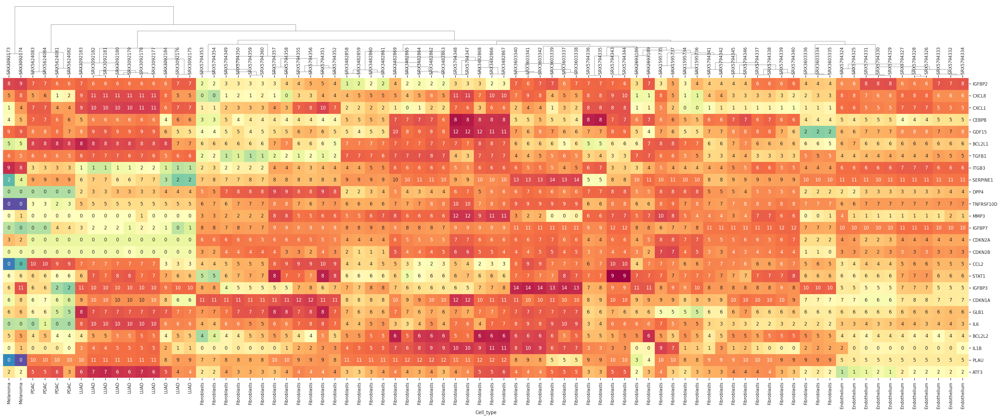

In [ ]:
# A simple heatmap with log2 TPM of all cells of current celltype
c = ["Fibroblasts", "Endothelium", "LUAD", "PDAC", "Melanoma"]
subsampling_lab = annot[annot["Cell_type"].isin(c)].index

genes_heatmap(
    sen_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)["Cell_type"],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color="blue",
    figsize=(45, 15),
    font_scale=1,
    show_indices=True,
    col_cluster=True,
    col_dendrogram=True,
    row_dendrogram=False,
)
plt.show()

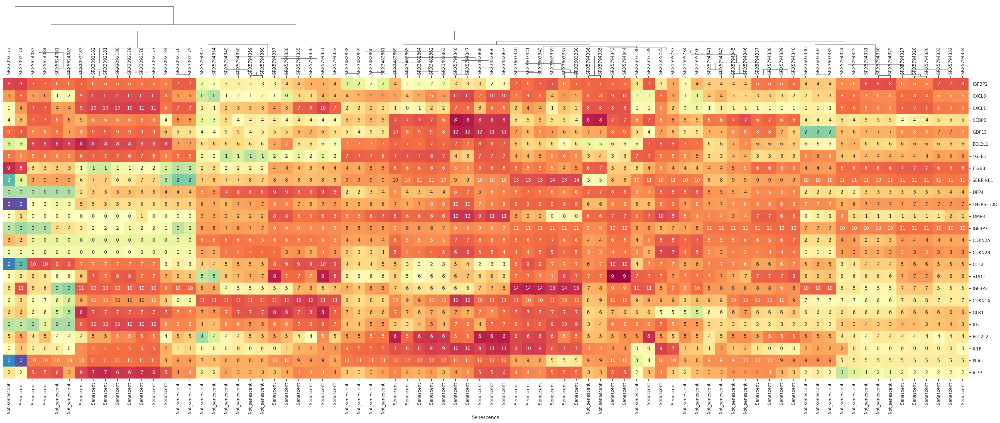

In [ ]:
# A simple heatmap with log2 TPM of all cells of current celltype
c = ["Fibroblasts", "Endothelium", "LUAD", "PDAC", "Melanoma"]
subsampling_lab = annot[annot["Cell_type"].isin(c)].index

genes_heatmap(
    sen_cells_expr[subsampling_lab],
    annot.reindex(subsampling_lab)["Senescence"],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color="blue",
    figsize=(45, 15),
    font_scale=1,
    show_indices=True,
    col_cluster=True,
    col_dendrogram=True,
    row_dendrogram=False,
)
plt.show()

In [ ]:
sns.reset_defaults()
sns.set_style("white")

### Train dataset

A half of samples (37 out of 75) is from GSE130727, dataset used by Casella et al. to comprise their signature. 
Because I use this signature in my comparision, I took GSE130727 as train and all other datasets as test.
Unfortunately, all endothelium samples are in train dataset and all tumor line samples are in test,
but we have little data, and I don't see, how to split it correctly

In [ ]:
annot_tr = annot.loc[annot.Dataset.isin(["GSE130727"])]

In [ ]:
annot_tr[["Cell_type", "Senescence"]].value_counts(sort=False)

Cell_type    Senescence   
Fibroblasts  Not_senescent    12
             Senescent        14
Endothelium  Not_senescent     5
             Senescent         6
dtype: int64

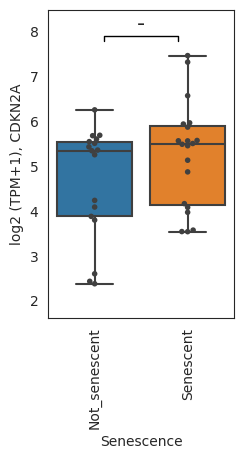

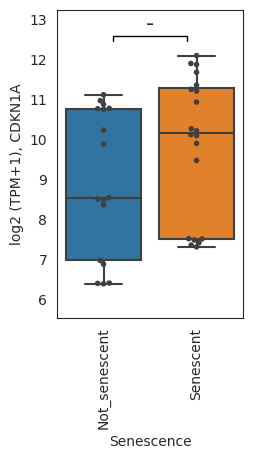

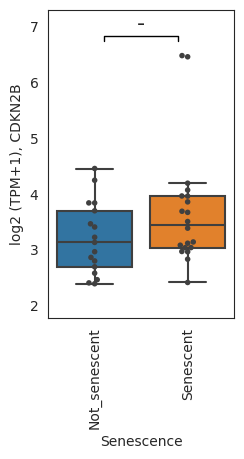

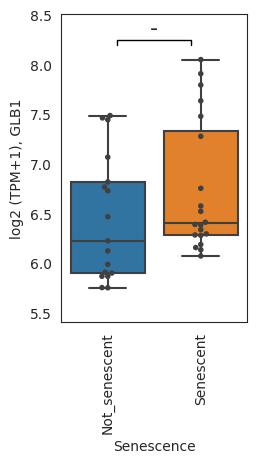

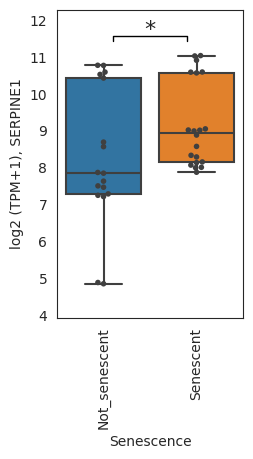

...

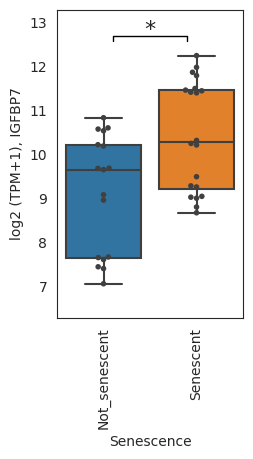

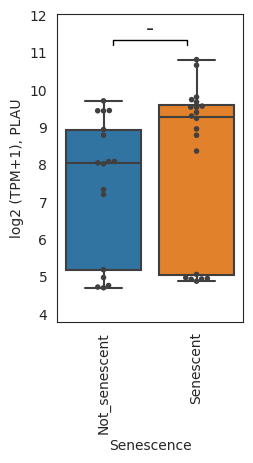

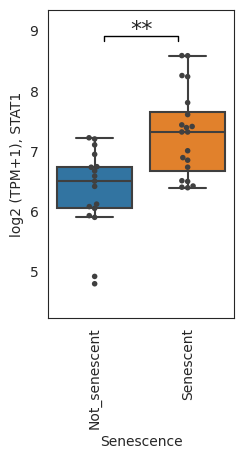

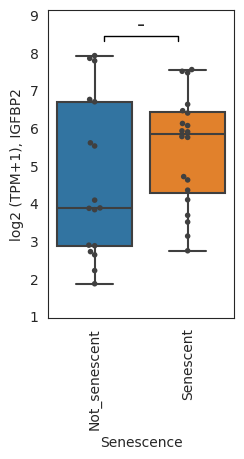

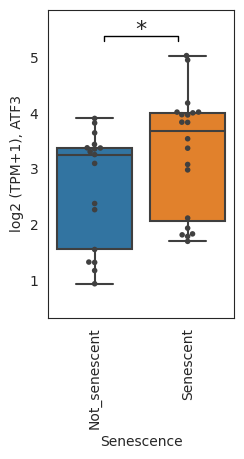

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ["Not_senescent", "Senescent"]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        sen_cells_expr.loc[gene],
        annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
        order=categories,
        s=4,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

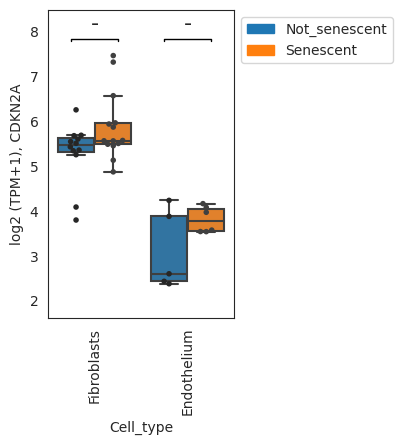

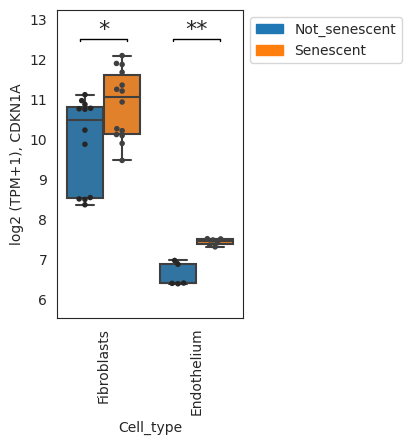

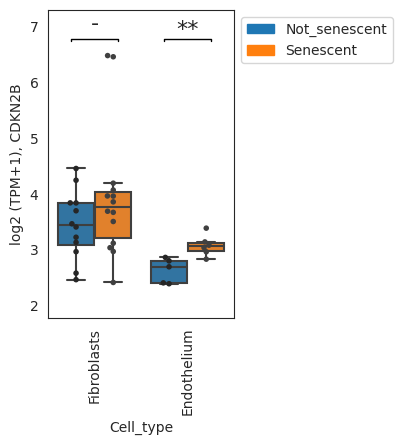

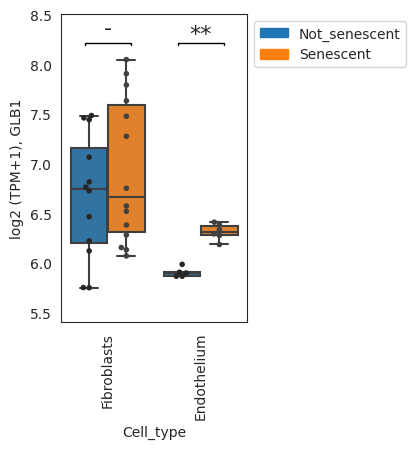

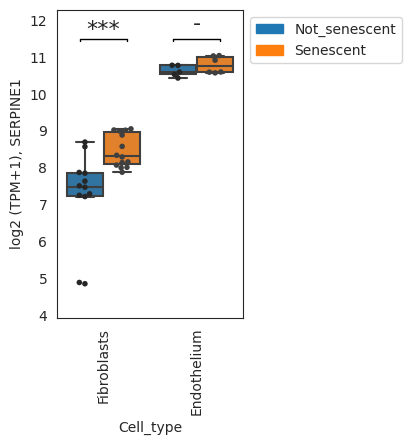

...

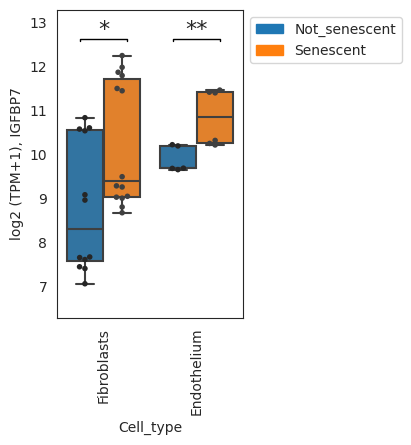

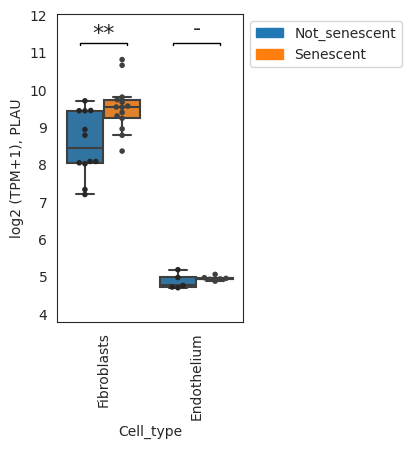

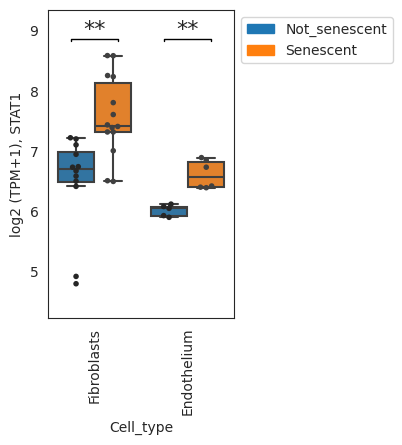

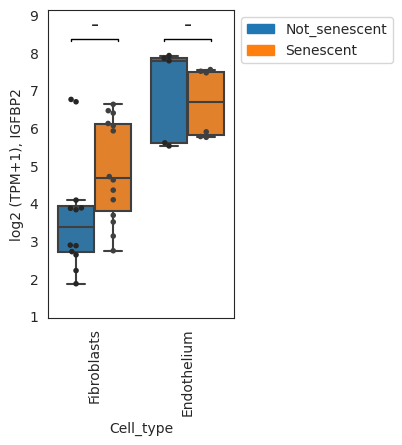

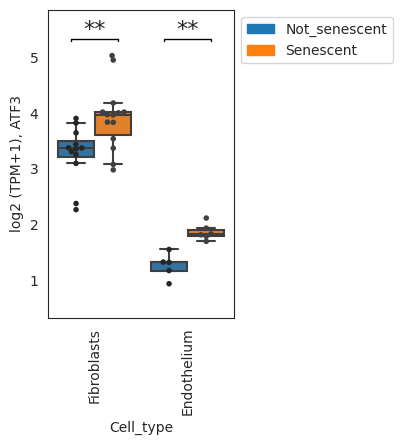

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Fibroblasts",
    "Endothelium",
]

for gene in signature_of_interest:
    grouped_boxplot_with_pvalue(
        sen_cells_expr.loc[gene],
        annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        hue=annot_tr[annot_tr["Cell_type"].isin(categories)]["Senescence"],
        hue_order=["Not_senescent", "Senescent"],
        s=4,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

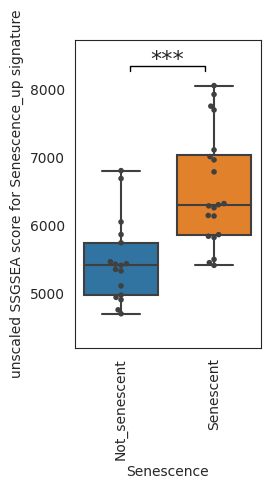

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()

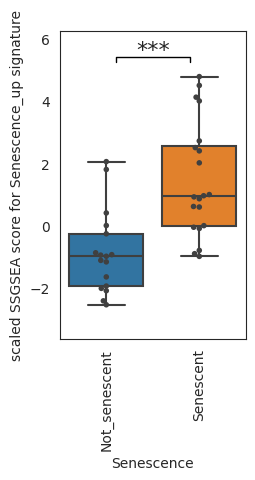

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
# plt.savefig("/uftp/users/msavchenko/figures/Senescence_signature_train_merged.svg", format="svg")
plt.show()

Suppl figure 3C

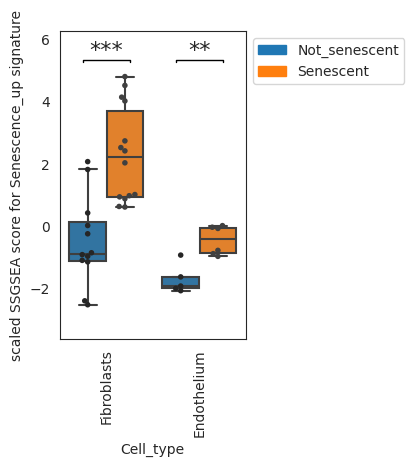

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    "Endothelium",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_train.svg", format="svg"
)
plt.show()

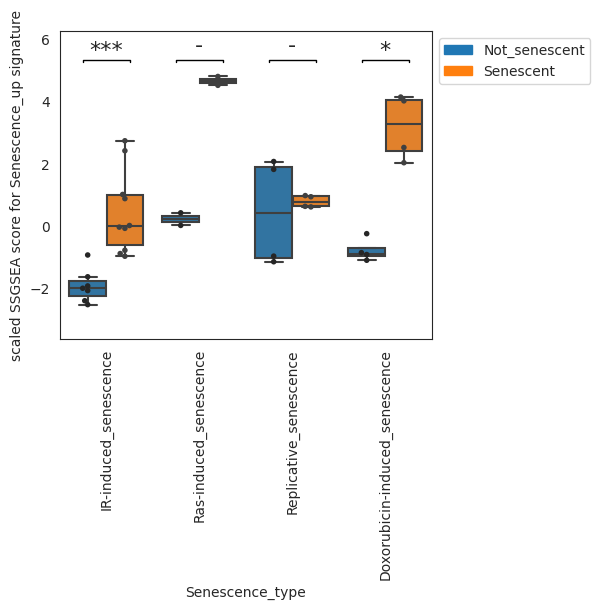

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    "IR-induced_senescence",
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    "Doxorubicin-induced_senescence",
    #'Etoposide-induced_senescence',
    #'H2AZ_KO-induced_senescence',
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_train_senescence_types.svg",
    format="svg",
)

plt.show()

#### other signatures to compare with

In [ ]:
signature_of_interest = """ALDH1A3	CCND1	CD44	CDKN1A	CDKN1C	CDKN2A	CDKN2B	CDKN2D	CITED2	CLTB	COL1A2	CREG1	CRYAB	CXCL14	CYP1B1	EIF2S2	ESM1	F3	FILIP1L	FN1	GSN	GUK1	HBS1L	HPS5	HSPA2	HTATIP2	IFI16	IFNG	IGFBP1	IGFBP2	IGFBP3	IGFBP4	IGFBP5	IGFBP6	IGFBP7	IGSF3	ING1	IRF5	IRF7	ISG15	MAP1LC3B	MAP2K3	MDM2	MMP1	NDN	NME2	NRG1	OPTN	PEA15	RAB13	RAB31	RAB5B	RABGGTA	RAC1	RBL2	RGL2	RHOB	RRAS	S100A11	SERPINB2	SERPINE1	SMPD1	SMURF2	SOD1	SPARC	STAT1	TES	TFAP2A	TGFB1I1	THBS1	TNFAIP2	TNFAIP3	TP53	TSPYL5	VIM""".split(
    "\t"
)
# OR
# signature_of_interest = ['EPX', 'RNASE2', 'IL5RA', 'SIGLEC8', 'ADGRE1', 'LGALS12']

# add here a custon signature name
signature_name = "Fridman_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

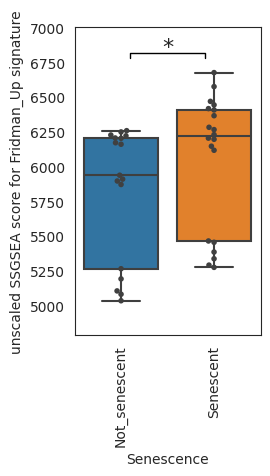

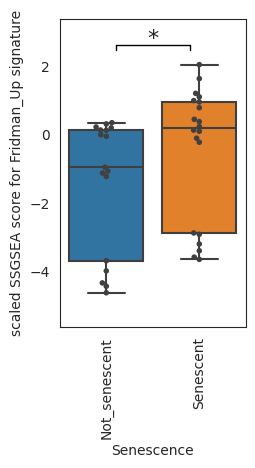

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

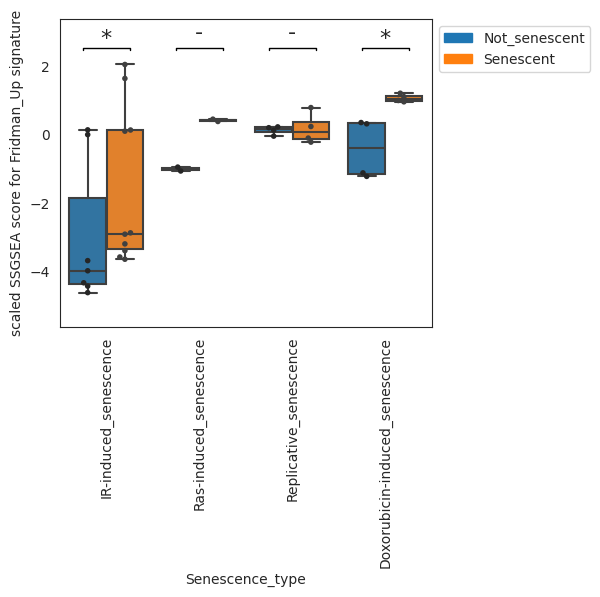

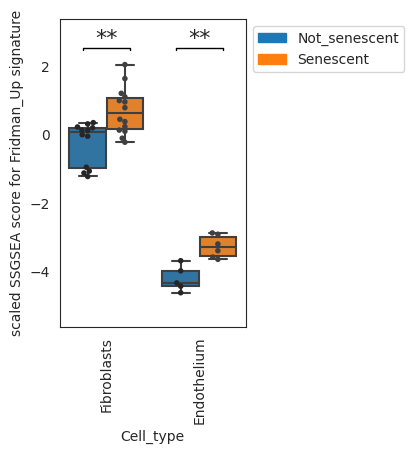

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    "IR-induced_senescence",
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    "Doxorubicin-induced_senescence",
    #'Etoposide-induced_senescence',
    #'H2AZ_KO-induced_senescence',
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()
categories = [
    "Fibroblasts",
    "Endothelium",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ARRDC4	BLCAP	CCND3	CHPF2	CLDN1	CLSTN2	DHRS7	DIO2	ELMOD1	FAM234B	FILIP1L	GPR155	H2AFJ	JCAD	KIAA1671	LRP10	NCSTN	PAM	PDLIM1	PLOD1	POFUT2	PTCHD4	RND3	SAMD9L	SARAF	SLC16A14	SLC9A7	SLCO2B1	SMCO3	SRPX	SRPX2	STAT1	TAP1	TMEM159	TMEM30A	TMEM59	TNFRSF10C	TNFSF13B	WDR63	WDR78""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Casella_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

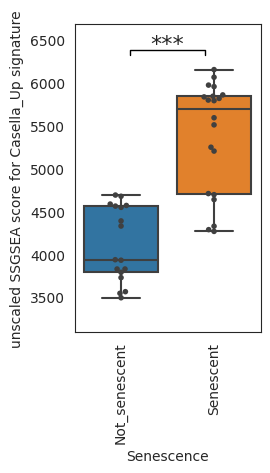

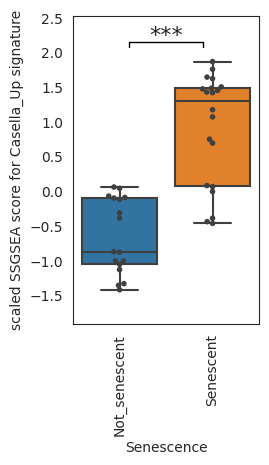

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

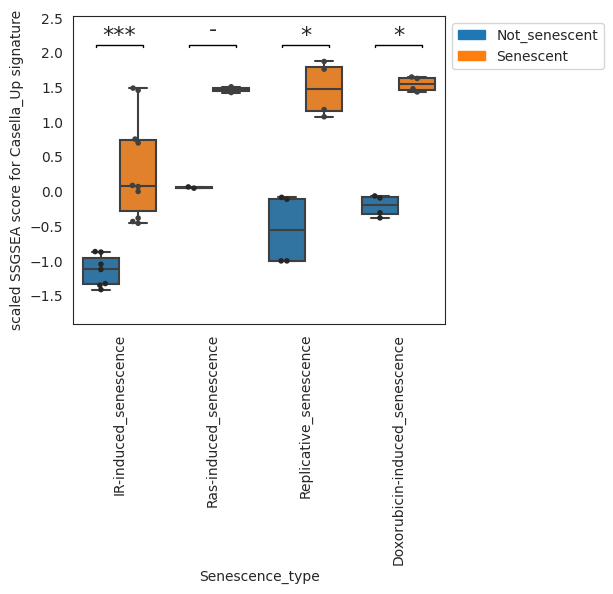

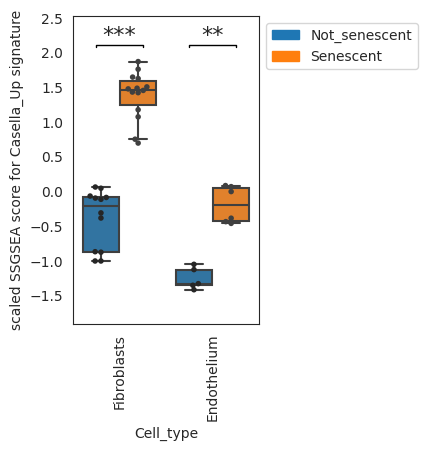

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    "IR-induced_senescence",
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    "Doxorubicin-induced_senescence",
    #'Etoposide-induced_senescence',
    #'H2AZ_KO-induced_senescence',
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()
categories = [
    "Fibroblasts",
    "Endothelium",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ACADVL	ADPGK	B4GALT7	BCL2L2	CCND1	CHMP5	DDA1	DGKA	DYNLT3	FAM214B	GBE1	GDNF	KLC1	MT-CYB	NOL3	P4HA2	PDLIM4	PLK3	PLXNA3	POFUT2	RAI14	SCOC	SLC10A3	SLC16A3	SUSD6	TAF13	TMEM87B	TOLLIP	TSPAN13	UFM1	ZBTB7A	ZNHIT1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Hernandez-Segura_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

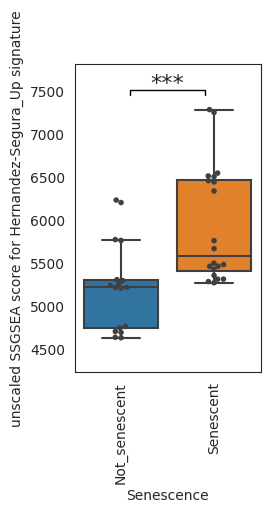

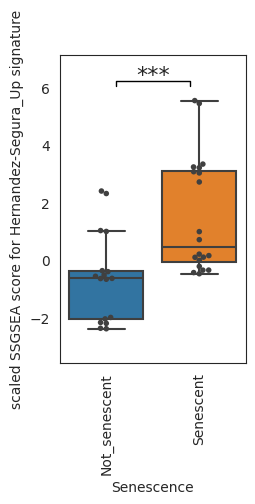

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

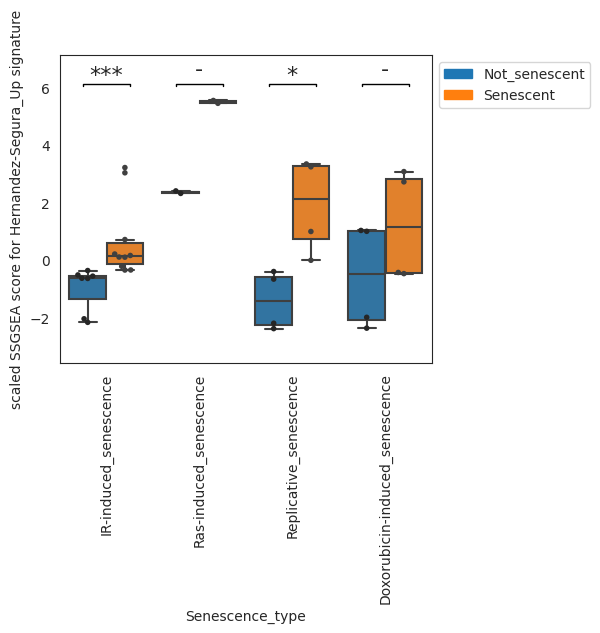

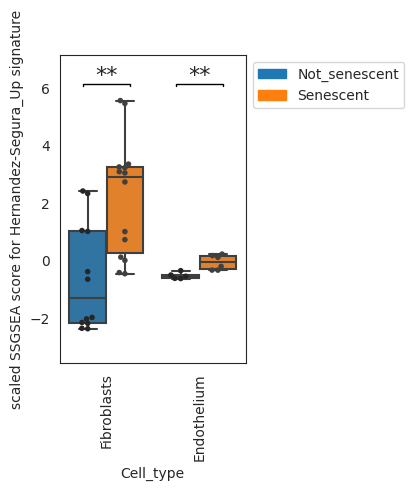

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    "IR-induced_senescence",
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    "Doxorubicin-induced_senescence",
    #'Etoposide-induced_senescence',
    #'H2AZ_KO-induced_senescence',
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()
categories = [
    "Fibroblasts",
    "Endothelium",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """APOL1	GBP4	COL17A1	GNG11	BIRC3	CTSS	EPSTI1	S1PR3	PMAIP1	TNFAIP3	APOL3	DUSP6	LCP1	ATF3	RSPO3	IDO1	LGALS9	CD163L1	MLKL	MYD88	BATF2	OASL	RTP4	C3	ISG20	CXCL2	ICAM1	IFI27	IL1B	GCA	IL32	IL1A	CD82	MMP12	IL1RN	HERC5	TNFAIP6	TNFRSF1B	PLAU	IFI30	CLDN1	CCDC80	NEGR1	ODZ2	GMPR	ITGB3	SCN3A	CYP1A1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Purcell_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

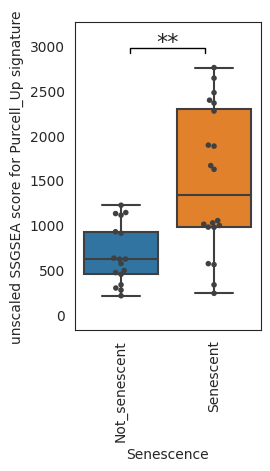

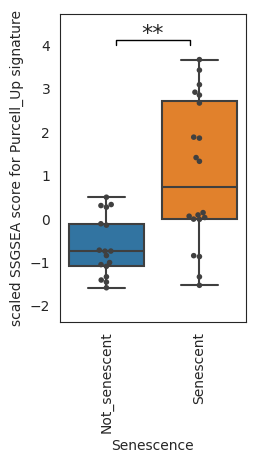

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

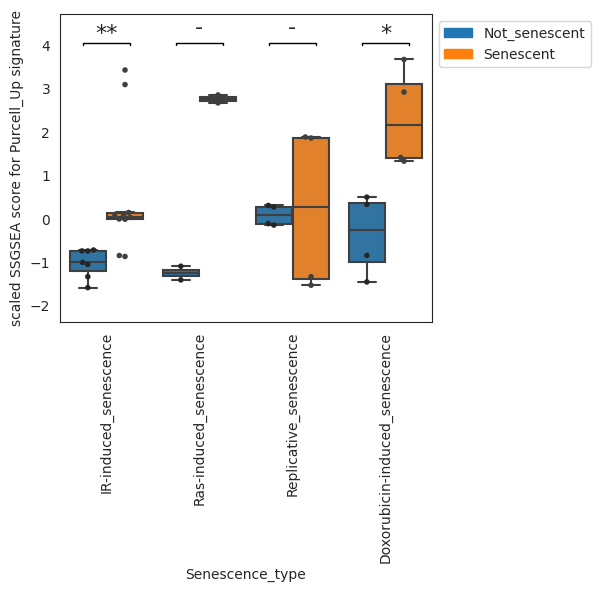

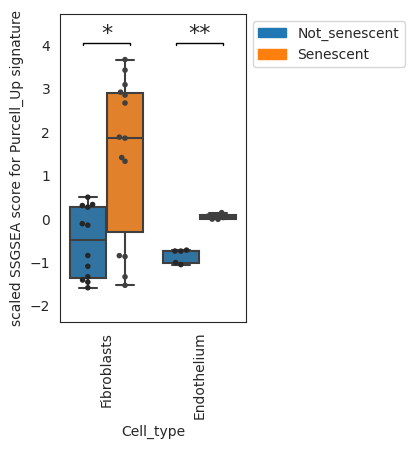

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    "IR-induced_senescence",
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    "Doxorubicin-induced_senescence",
    #'Etoposide-induced_senescence',
    #'H2AZ_KO-induced_senescence',
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot_tr["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()
categories = [
    "Fibroblasts",
    "Endothelium",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_tr[annot_tr["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_tr[annot["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

### Test datasets

In [ ]:
annot_test = annot.loc[~annot.Dataset.isin(["GSE130727"])]

In [ ]:
annot_test[["Dataset", "Senescence"]].value_counts(sort=False)

Dataset    Senescence   
GSE102639  Not_senescent    3
           Senescent        9
GSE108278  Not_senescent    4
           Senescent        8
GSE109700  Not_senescent    3
           Senescent        6
GSE129182  Not_senescent    2
           Senescent        2
GSE78138   Not_senescent    2
           Senescent        2
GSE97265   Not_senescent    1
           Senescent        1
dtype: int64

In [ ]:
# current signature
signature_of_interest = [
    "CDKN2A",
    "CDKN1A",
    "CDKN2B",
    "GLB1",
    "SERPINE1",
    "DPP4",
    # 'NOX4',
    "CEBPB",
    # 'BHLHE40',
    "BCL2L1",
    "BCL2L2",
    "TNFRSF10D",
    # 'CAV1',
    "ITGB3",
    "IGFBP3",
    "MMP3",
    "CCL2",
    "IL6",
    "CXCL8",
    "CXCL1",
    "IL1B",
    "TGFB1",
    "GDF15",
    "IGFBP7",
    "PLAU",
    "STAT1",
    "IGFBP2",
    "ATF3",
]

# add here a custon signature name
signature_name = "Senescence_up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

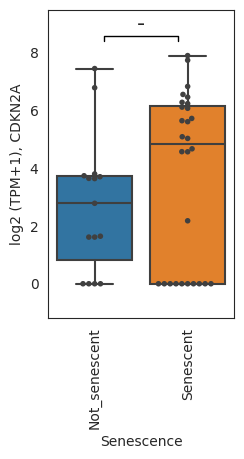

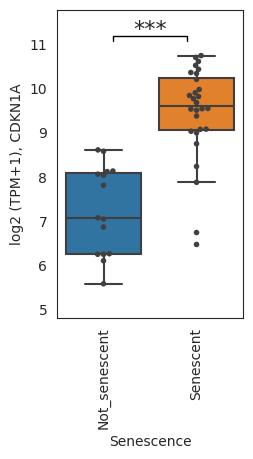

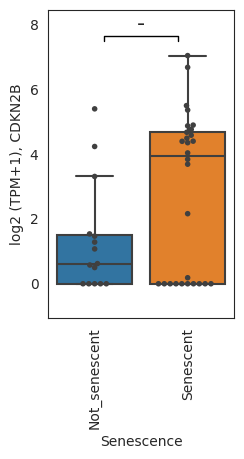

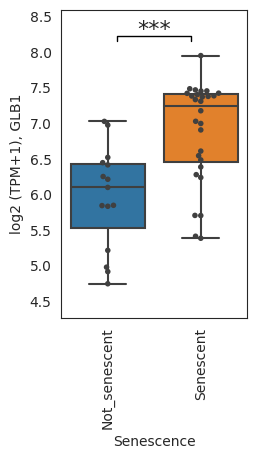

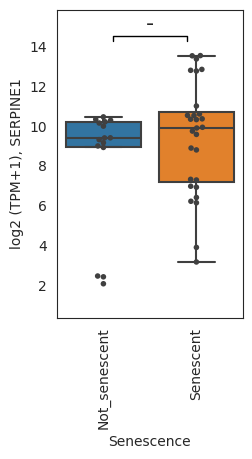

...

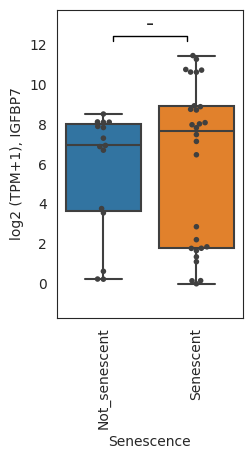

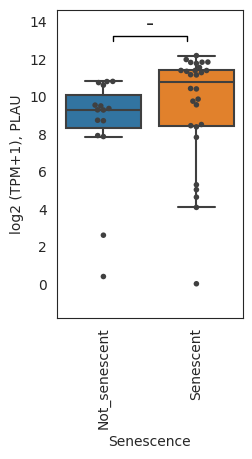

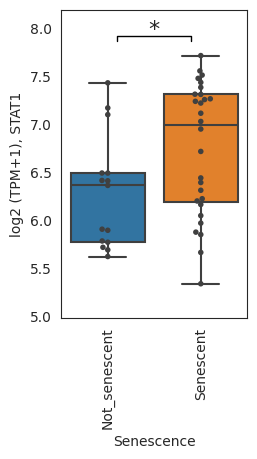

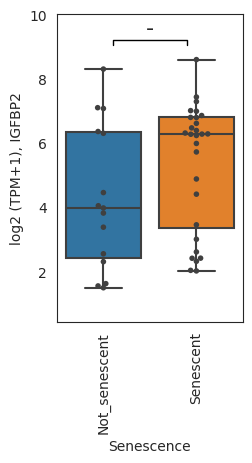

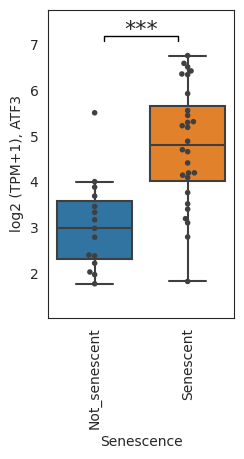

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = ["Not_senescent", "Senescent"]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        sen_cells_expr.loc[gene],
        annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
        order=categories,
        s=4,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

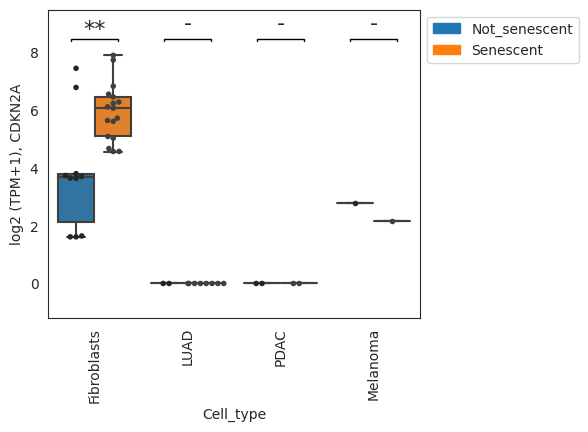

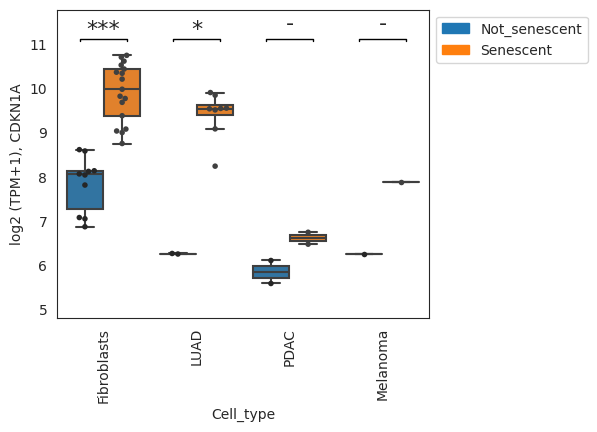

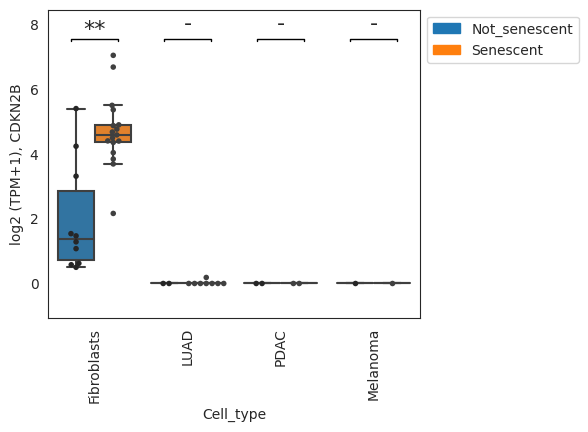

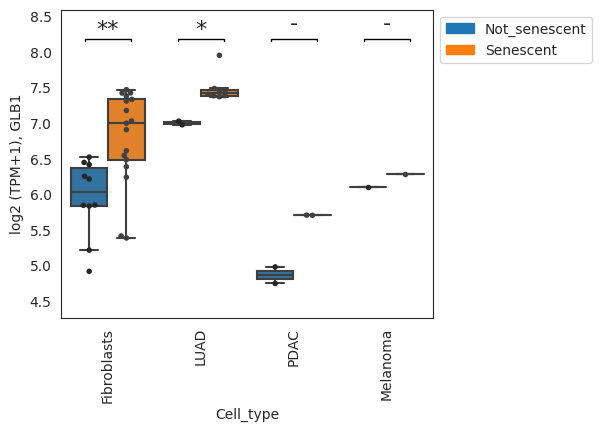

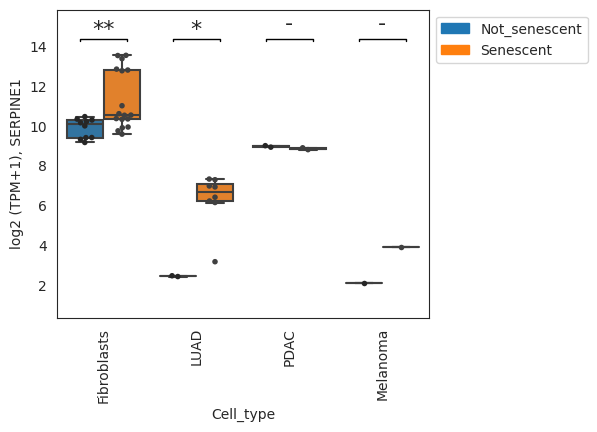

...

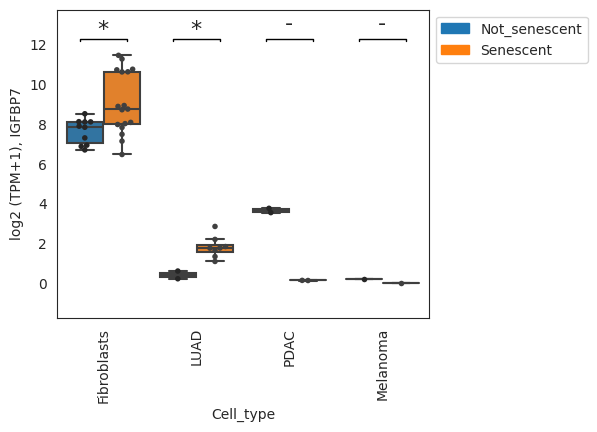

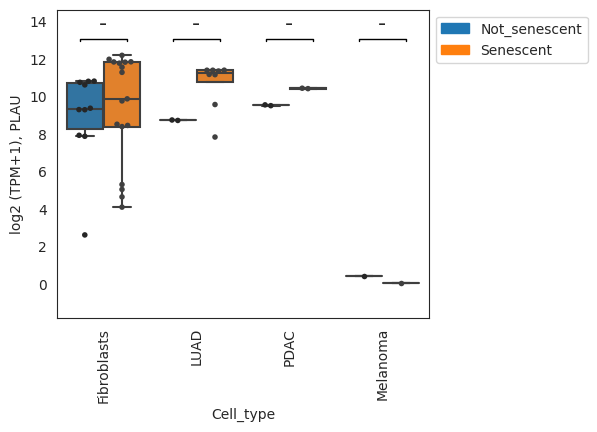

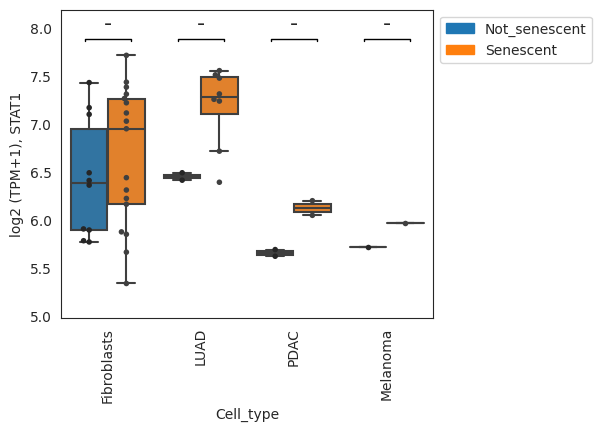

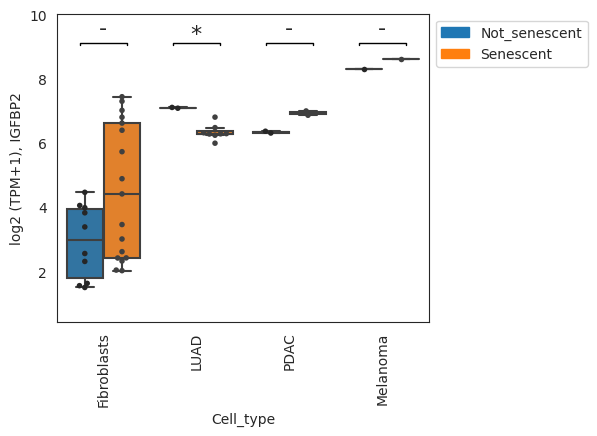

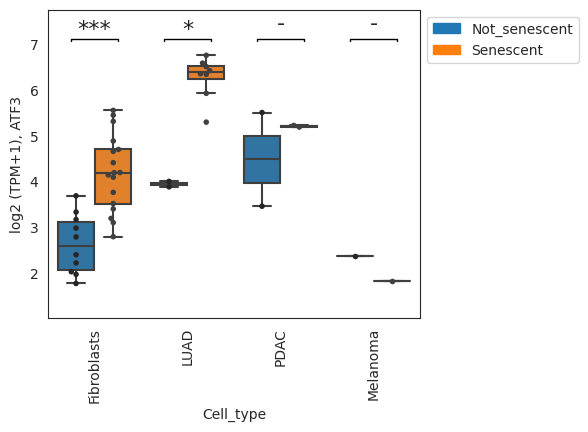

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    "Melanoma",
]

for gene in signature_of_interest:
    grouped_boxplot_with_pvalue(
        sen_cells_expr.loc[gene],
        annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
        hue_order=["Not_senescent", "Senescent"],
        s=4,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

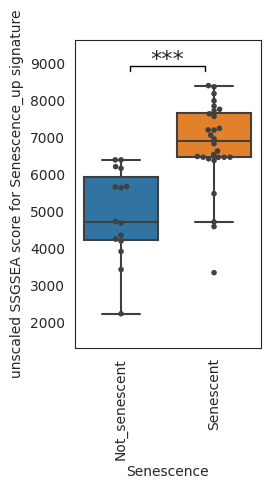

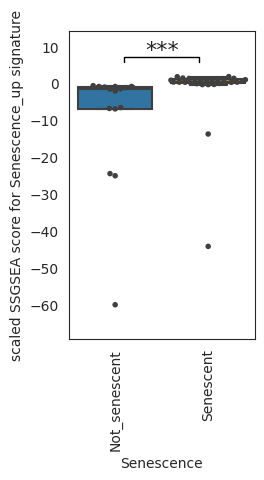

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

Figure 5C

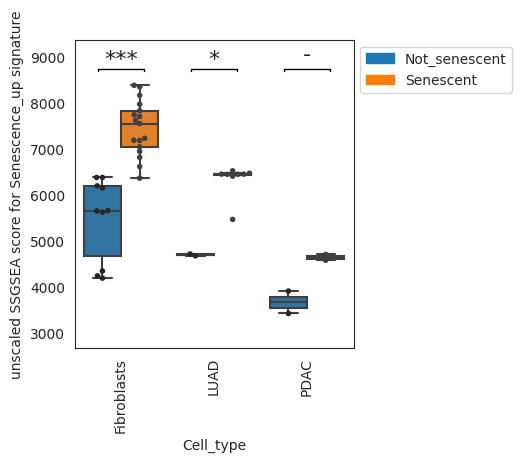

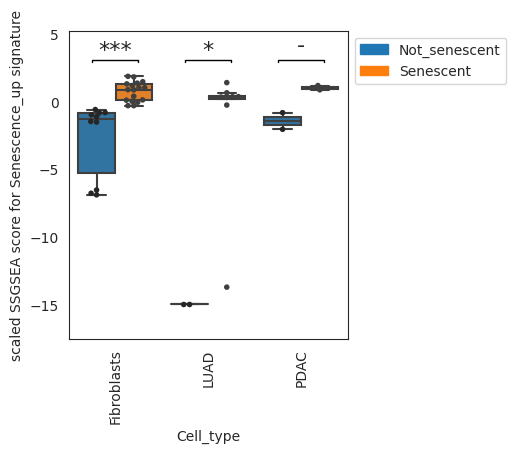

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    #'Melanoma'
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name].clip(-15, 6),
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_test.svg", format="svg"
)
plt.show()

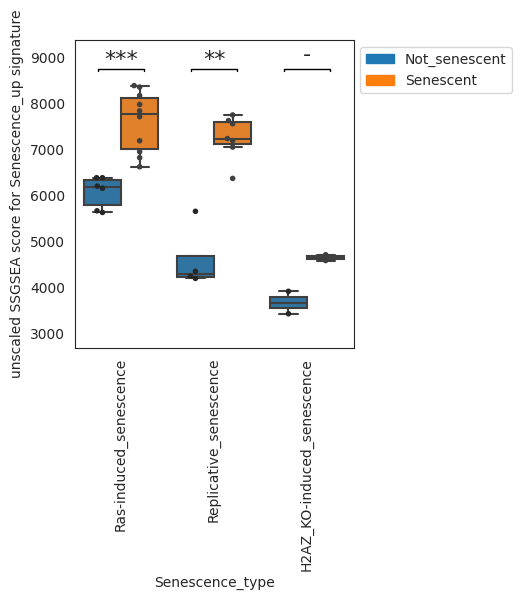

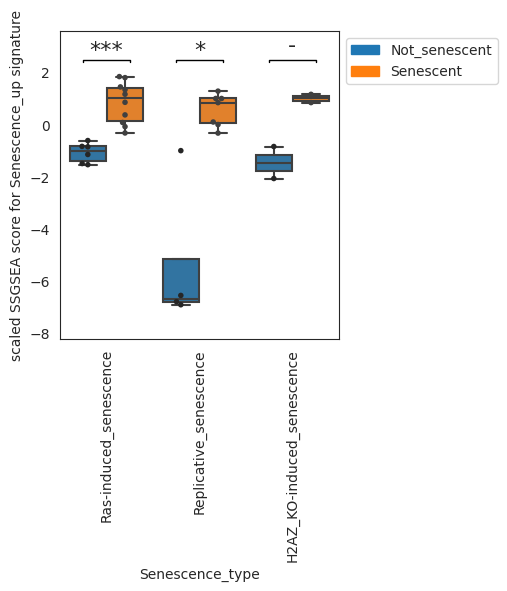

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    #'IR-induced_senescence',
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    #'Doxorubicin-induced_senescence',
    #'Etoposide-induced_senescence',
    "H2AZ_KO-induced_senescence",
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_test_senescence_types.svg",
    format="svg",
)
plt.show()

#### other signatures to compare with

In [ ]:
signature_of_interest = """ALDH1A3	CCND1	CD44	CDKN1A	CDKN1C	CDKN2A	CDKN2B	CDKN2D	CITED2	CLTB	COL1A2	CREG1	CRYAB	CXCL14	CYP1B1	EIF2S2	ESM1	F3	FILIP1L	FN1	GSN	GUK1	HBS1L	HPS5	HSPA2	HTATIP2	IFI16	IFNG	IGFBP1	IGFBP2	IGFBP3	IGFBP4	IGFBP5	IGFBP6	IGFBP7	IGSF3	ING1	IRF5	IRF7	ISG15	MAP1LC3B	MAP2K3	MDM2	MMP1	NDN	NME2	NRG1	OPTN	PEA15	RAB13	RAB31	RAB5B	RABGGTA	RAC1	RBL2	RGL2	RHOB	RRAS	S100A11	SERPINB2	SERPINE1	SMPD1	SMURF2	SOD1	SPARC	STAT1	TES	TFAP2A	TGFB1I1	THBS1	TNFAIP2	TNFAIP3	TP53	TSPYL5	VIM""".split(
    "\t"
)
# OR
# signature_of_interest = ['EPX', 'RNASE2', 'IL5RA', 'SIGLEC8', 'ADGRE1', 'LGALS12']

# add here a custon signature name
signature_name = "Fridman_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

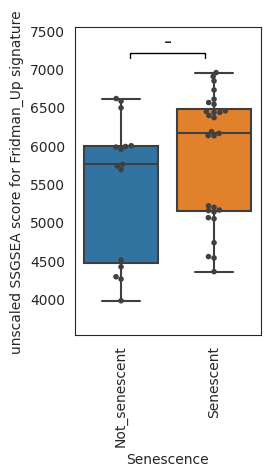

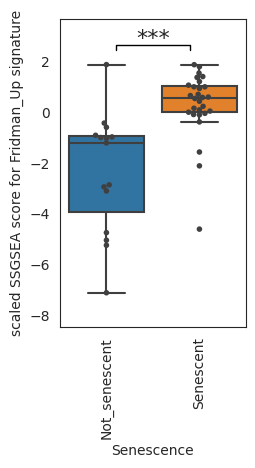

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

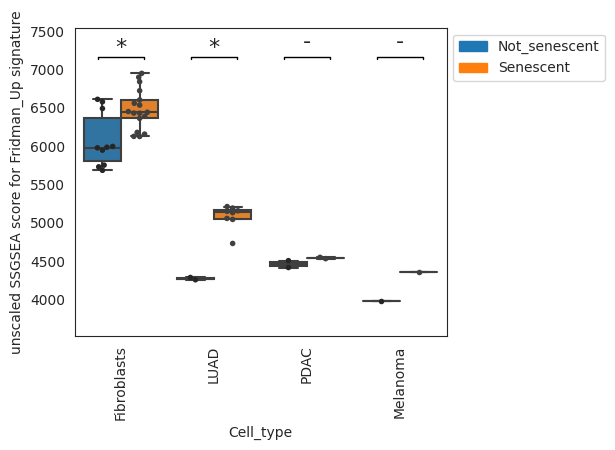

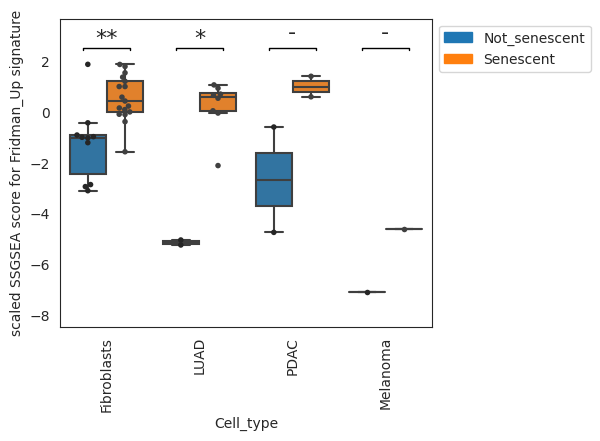

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

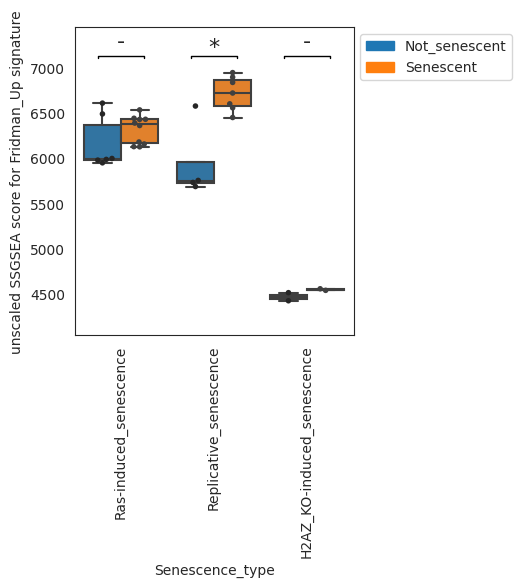

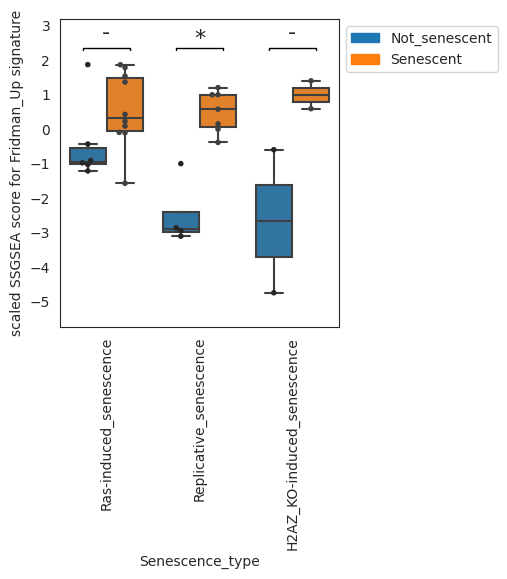

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    #'IR-induced_senescence',
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    #'Doxorubicin-induced_senescence',
    #'Etoposide-induced_senescence',
    "H2AZ_KO-induced_senescence",
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ARRDC4	BLCAP	CCND3	CHPF2	CLDN1	CLSTN2	DHRS7	DIO2	ELMOD1	FAM234B	FILIP1L	GPR155	H2AFJ	JCAD	KIAA1671	LRP10	NCSTN	PAM	PDLIM1	PLOD1	POFUT2	PTCHD4	RND3	SAMD9L	SARAF	SLC16A14	SLC9A7	SLCO2B1	SMCO3	SRPX	SRPX2	STAT1	TAP1	TMEM159	TMEM30A	TMEM59	TNFRSF10C	TNFSF13B	WDR63	WDR78""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Casella_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

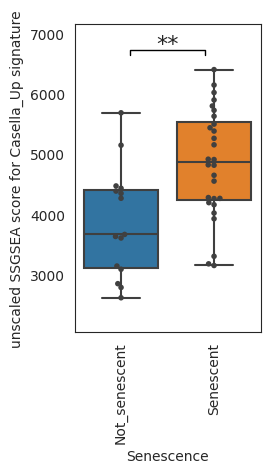

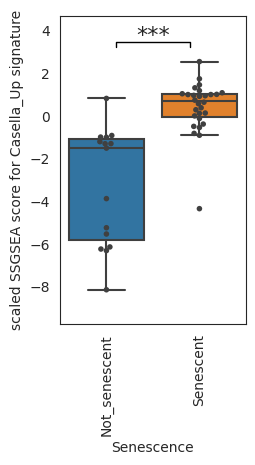

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

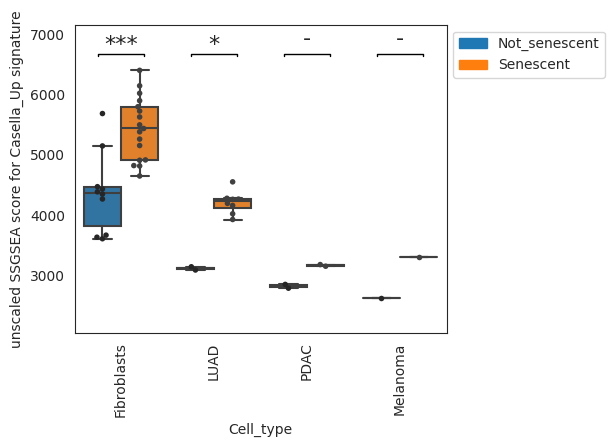

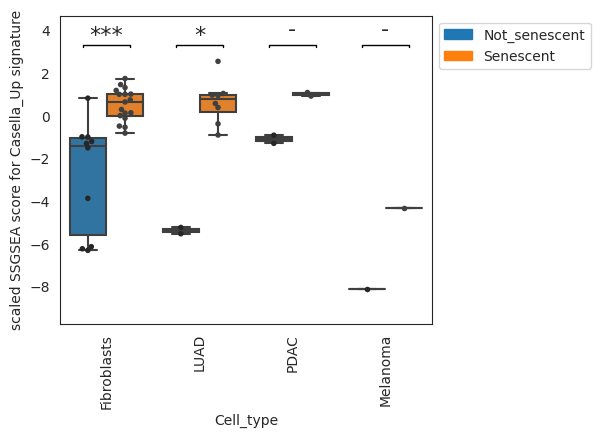

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

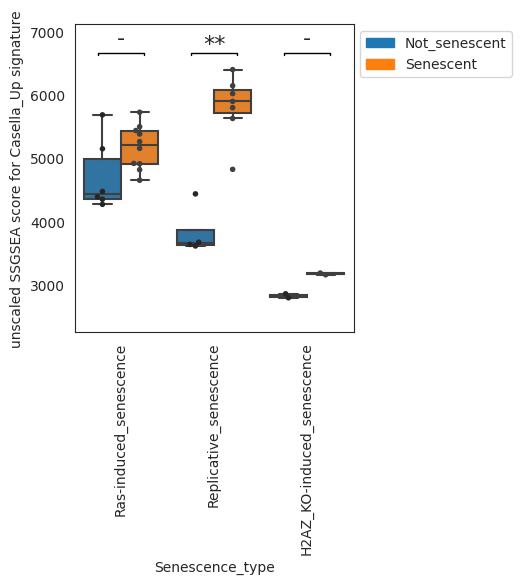

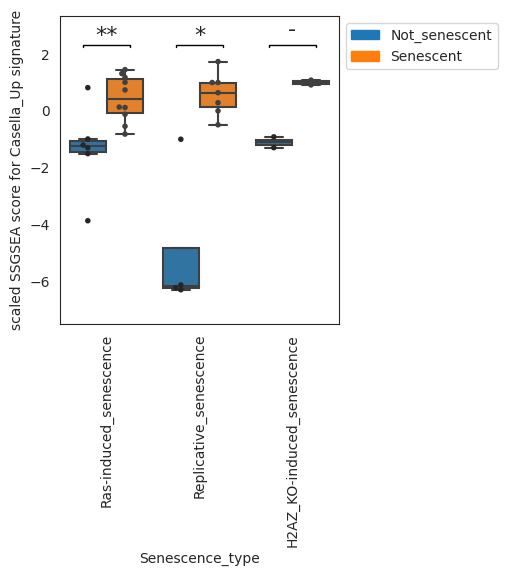

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    #'IR-induced_senescence',
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    #'Doxorubicin-induced_senescence',
    #'Etoposide-induced_senescence',
    "H2AZ_KO-induced_senescence",
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ACADVL	ADPGK	B4GALT7	BCL2L2	CCND1	CHMP5	DDA1	DGKA	DYNLT3	FAM214B	GBE1	GDNF	KLC1	MT-CYB	NOL3	P4HA2	PDLIM4	PLK3	PLXNA3	POFUT2	RAI14	SCOC	SLC10A3	SLC16A3	SUSD6	TAF13	TMEM87B	TOLLIP	TSPAN13	UFM1	ZBTB7A	ZNHIT1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Hernandez-Segura_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

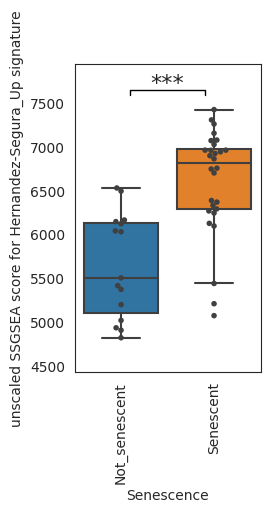

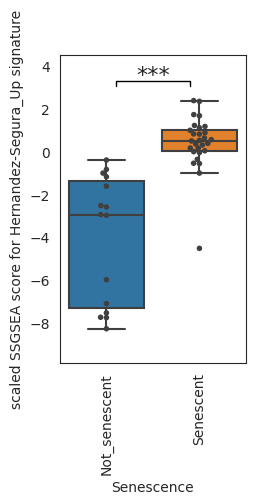

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

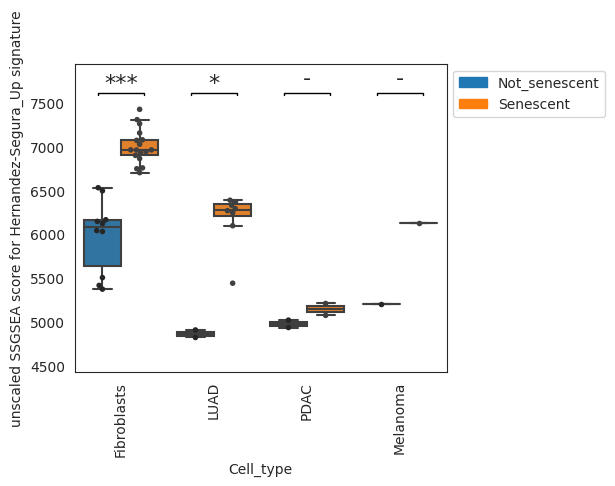

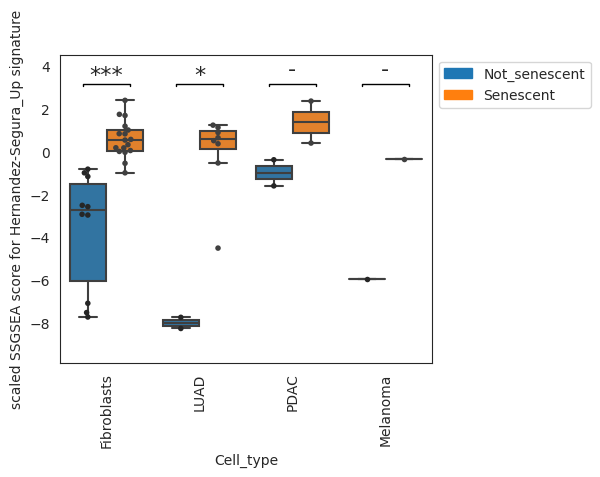

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

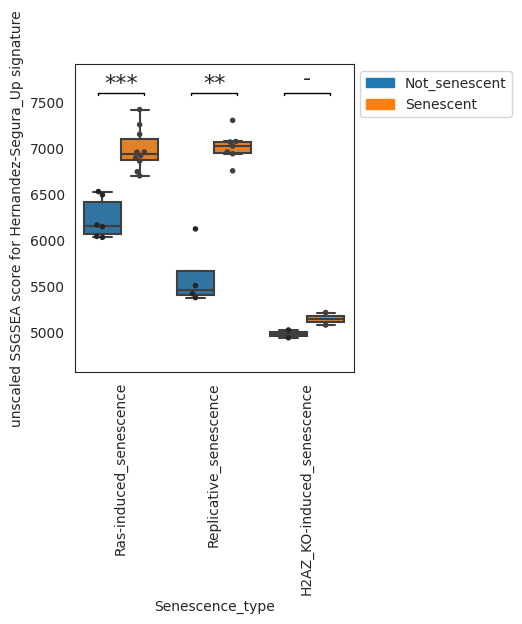

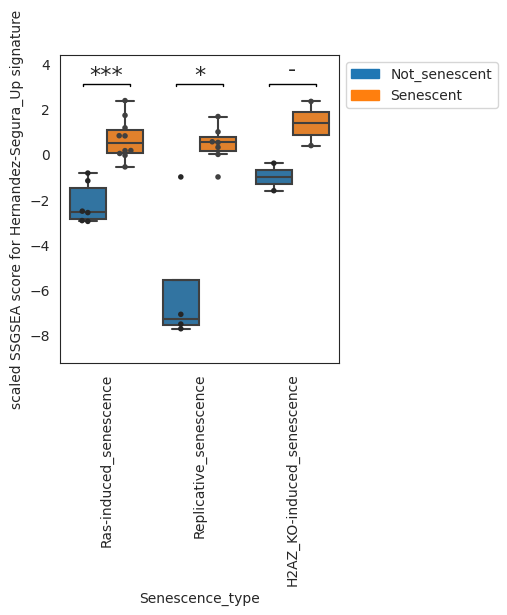

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    #'IR-induced_senescence',
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    #'Doxorubicin-induced_senescence',
    #'Etoposide-induced_senescence',
    "H2AZ_KO-induced_senescence",
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """APOL1	GBP4	COL17A1	GNG11	BIRC3	CTSS	EPSTI1	S1PR3	PMAIP1	TNFAIP3	APOL3	DUSP6	LCP1	ATF3	RSPO3	IDO1	LGALS9	CD163L1	MLKL	MYD88	BATF2	OASL	RTP4	C3	ISG20	CXCL2	ICAM1	IFI27	IL1B	GCA	IL32	IL1A	CD82	MMP12	IL1RN	HERC5	TNFAIP6	TNFRSF1B	PLAU	IFI30	CLDN1	CCDC80	NEGR1	ODZ2	GMPR	ITGB3	SCN3A	CYP1A1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Purcell_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
sen_cells_ssgsea_unscaled = ssgsea_formula(
    sen_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, sen_cells_expr.index, verbose=False),
).T
x = sen_cells_annot.groupby("Dataset")

sen_cells_ssgsea_scaled = {}
for i in x:
    sen_cells_ssgsea_scaled[i[0]] = median_scale(
        sen_cells_ssgsea_unscaled.reindex(i[1].index)
    )

sen_cells_ssgsea_scaled = pd.concat(sen_cells_ssgsea_scaled.values())

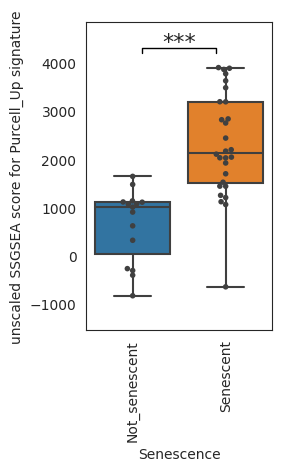

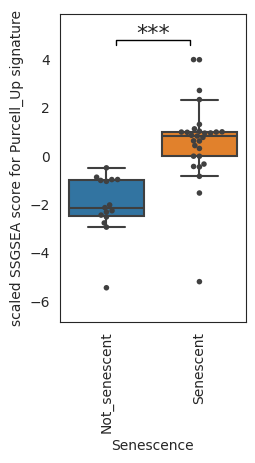

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = ["Not_senescent", "Senescent"]

boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence"].isin(categories)]["Senescence"],
    order=categories,
    s=4,
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

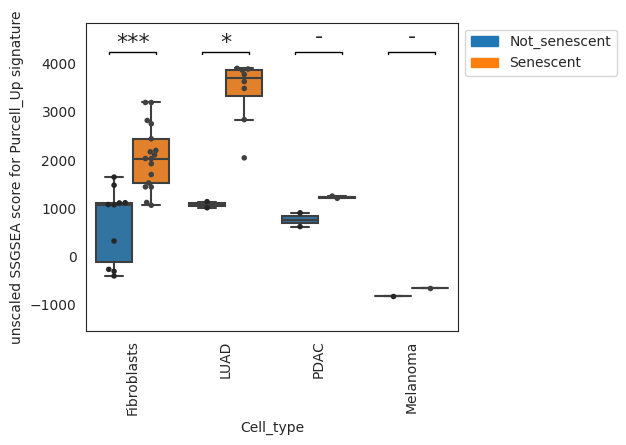

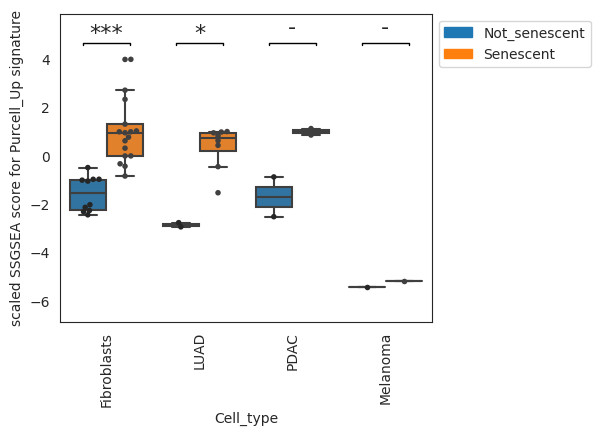

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Fibroblasts",
    #'Endothelium',
    "LUAD",
    "PDAC",
    "Melanoma",
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Cell_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

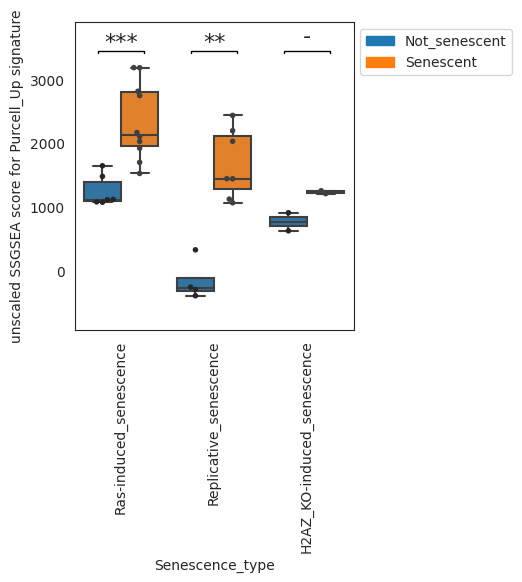

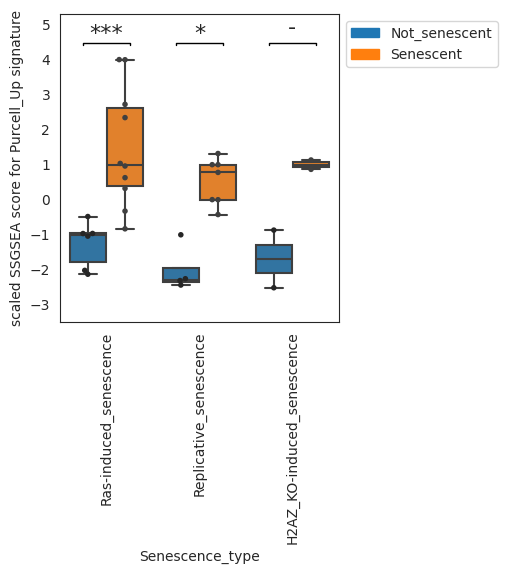

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [  #'Not_senescent',
    #'IR-induced_senescence',
    "Ras-induced_senescence",
    #'AURK_inhibitor-induced_senescence',
    "Replicative_senescence",
    #'Doxorubicin-induced_senescence',
    #'Etoposide-induced_senescence',
    "H2AZ_KO-induced_senescence",
    #'SMARKB1_KO-induced_senescence',
]

grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_unscaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"unscaled SSGSEA score for {signature_name} signature")
plt.show()
grouped_boxplot_with_pvalue(
    sen_cells_ssgsea_scaled[signature_name],
    annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence_type"],
    order=categories,
    s=4,
    hue=annot_test[annot_test["Senescence_type"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
)

plt.xticks(rotation=90)
plt.ylabel(f"scaled SSGSEA score for {signature_name} signature")
plt.show()

#### MSigDB signatures

In [ ]:
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests


def process_generic_dataset(df_scores, metadata, datasets):
    """
    Обрабатывает общий набор данных и вычисляет среднее значение, стандартное отклонение и p-value
    для сравнения между группами данных.

    Параметры:
        - df_scores (DataFrame): Датафрейм со значениями скоров для каждого сэмпла (строки) и сигнатуры (колонки).
        - metadata (Series): Серия с метаданными, определяющими группы сэмплов. В строках должны быть сэмплы, в значениях категории, всего может быть лишь 2 категории.
        - datasets (Series): Серия с датасетами для каждого сэмпла
    Возвращает:
        - out (DataFrame): Датафрейм со средними значениями скоров для каждой группы и сигнатуры.
        - out_stdev (DataFrame): Датафрейм со стандартным отклонением разницы скоров между группами в датасете для каждой сигнатуры.
        - out_mw_corrected (DataFrame): Датафрейм с поправленными значениями p-value для сравнения между группами.

    """
    df_scores, metadata = to_common_samples((df_scores.dropna(), metadata.dropna()))
    unique_groups = metadata.unique()
    num_groups = len(unique_groups)

    out = {group: {} for group in unique_groups}
    out_stdev = dict()  # dataset: {} for dataset in datasets.unique()
    out_mw = {group: {} for group in unique_groups}
    dataset_mean = {dataset: {} for dataset in datasets.unique()}

    for column in df_scores.columns:
        for group in unique_groups:
            group_data = df_scores[column].loc[metadata == group]

            out[group][column] = group_data.mean()
            # out_stdev[group][column] = group_data.std()

            for other_group in unique_groups:
                if other_group != group:
                    other_group_data = df_scores[column].loc[metadata == other_group]
                    _, pv = mannwhitneyu(
                        group_data, other_group_data, alternative="two-sided"
                    )
                    out_mw[group][column] = pv

            for dataset in datasets.unique():
                dataset_group_data = group_data.loc[datasets == dataset]
                dataset_mean[dataset][group] = dataset_group_data.mean()
        dataset_mean = pd.DataFrame(dataset_mean)
        groups = dataset_mean.index
        main_column = unique_groups[0]
        dataset_difference = (
            dataset_mean.loc[[main_column]].iloc[0]
            - dataset_mean.loc[[i for i in groups if i != main_column]].iloc[0]
        )
        out_stdev[column] = dataset_difference.std()
    out_mw = pd.DataFrame(out_mw)
    out_mw["{} vs {}".format(unique_groups[0], unique_groups[1])] = out_mw.T.mean()
    out_mw = out_mw.drop(columns=unique_groups)
    _, out_mw_flat, _, _ = multipletests(out_mw[out_mw.columns[0]], method="fdr_bh")
    out_mw_corrected = pd.DataFrame(
        data=out_mw_flat, index=out_mw.index, columns=out_mw.columns
    )

    return pd.DataFrame(out), pd.Series(out_stdev), out_mw_corrected


def plot_waterfall(
    df_means,
    df_p_values,
    df_stdev,
    main_column=None,
    title=None,
    labels=None,
    errorbar=True,
    save=True,
    path_to_save="~/waterfall.",
    format="svg",
):
    """
    Строит waterfall-график для разницы между средними значениями скоров.

    Параметры:
        - df_means (DataFrame): Датафрейм со средними значениями скоров для каждой группы (колонки) и сигнатуры (строки).
        - df_p_values (DataFrame): Датафрейм с поправленными значениями p-value для сравнения между группами. Сигнатуры в строках, колонка одна.
        - df_stdev (Series): Серия со стандартным отклонением разницы скоров между группами в датасете для каждой сигнатуры.
        - main_column (str): Название колонки, из которой будут вычитать другую колонку. Например, если main_column это наличие таргета, то будем смотреть на вычитание наличия из отсутствия, и наоборот.
        - title (str): Заголовок графика.
        - labels (Series): Серия с названиями для каждой сигнатуры, если хотим добавить другие названия.
        - save (bull): Сохранять ли плот. Default True.
        - path_to_save (str): Путь для сохранения файла, если не указан, сохраняет в "~/waterfall_plot.svg"
        - format (str): Формат сохранения файла. Default svg.

    """

    # Разница между значениями столбцов
    groups = df_means.columns
    dif = (
        df_means.T.loc[[main_column]].iloc[0]
        - df_means.T.loc[[i for i in groups if i != main_column]].iloc[0]
    )
    # Сортировка разницы по убыванию
    dif = dif.sort_values(ascending=False)

    # Получение интервалов доверия
    lower_error = df_stdev * 0
    upper_error = df_stdev
    for i in upper_error.index:
        if dif[i] < 0:
            lower_error[i] = upper_error[i]
            upper_error[i] = 0
    upper_error = upper_error.where(upper_error <= 500, np.nan)

    # Построение waterfall-графика
    sns.set_style("ticks")
    plt.rcParams.update({"font.size": 13})
    p = ["#a8e6cf" if x > 0 else "#ff8b94" for x in dif.values]
    fig, ax = plt.subplots(figsize=(11, 6))
    if errorbar == True:
        ax.bar(
            range(len(dif)),
            dif,
            color=p,
            yerr=[lower_error.loc[dif.index], upper_error.loc[dif.index]],
            error_kw={"ecolor": "lightgray"},
        )
    else:
        ax.bar(range(len(dif)), dif, color=p)
    if not labels:
        labels = pd.Series(index=dif.index, data=dif.index)
    plt.xticks(range(len(dif)), labels=labels.loc[dif.index], rotation=90)
    ax.set_xlabel("Signatures")
    ax.set_ylabel("Difference")
    ax.set_title(title)

    # Добавление значений p-value
    for i, value in enumerate(dif.values):
        p_value = df_p_values.loc[dif.index[i]][0]
        if p_value <= 0.05:
            if p_value <= 0.001:
                pv = "***"
            elif p_value <= 0.01:
                pv = "**"
            else:
                pv = "*"
        else:
            pv = "n/s"
        if value < 0:
            y = 1
        else:
            y = value + 1
        if pv != "n/s":
            ax.annotate(pv, (i, y), ha="center", va="center", size=10, c="black")
        else:
            ax.annotate(pv, (i, y), ha="center", va="bottom", size=8, c="black")
    plt.ylim(dif.min() - 3.5, dif.max() + 8.5)

    if title:
        plt.title(title)
    if save:
        plt.rcParams["svg.fonttype"] = "none"
        if "." + format in path_to_save.split("/")[-1]:
            path_to_save = path_to_save
        else:
            path_to_save = path_to_save + format
        plt.savefig(path_to_save, format=format, dpi=300)
    plt.show()

In [ ]:
gmt = read_dataset("genesets_msigdb_senescence.gmt")
gmt = {
    j.name: GeneSet(j.name, j.link, set(j[1:].dropna().values))
    for i, j in gmt.iterrows()
}

In [ ]:
df_sen = ssgsea_formula(
    sen_cells_expr[annot_test.index], gmt_genes_alt_names(gmt, sen_cells_expr.index)
)
df_sen = df_sen.T

In [ ]:
x = annot_test.groupby("Dataset")

df_sen_scaled = {}
for i in x:
    df_sen_scaled[i[0]] = median_scale(df_sen.reindex(i[1].index))

df_sen_scaled = pd.concat(df_sen_scaled.values())

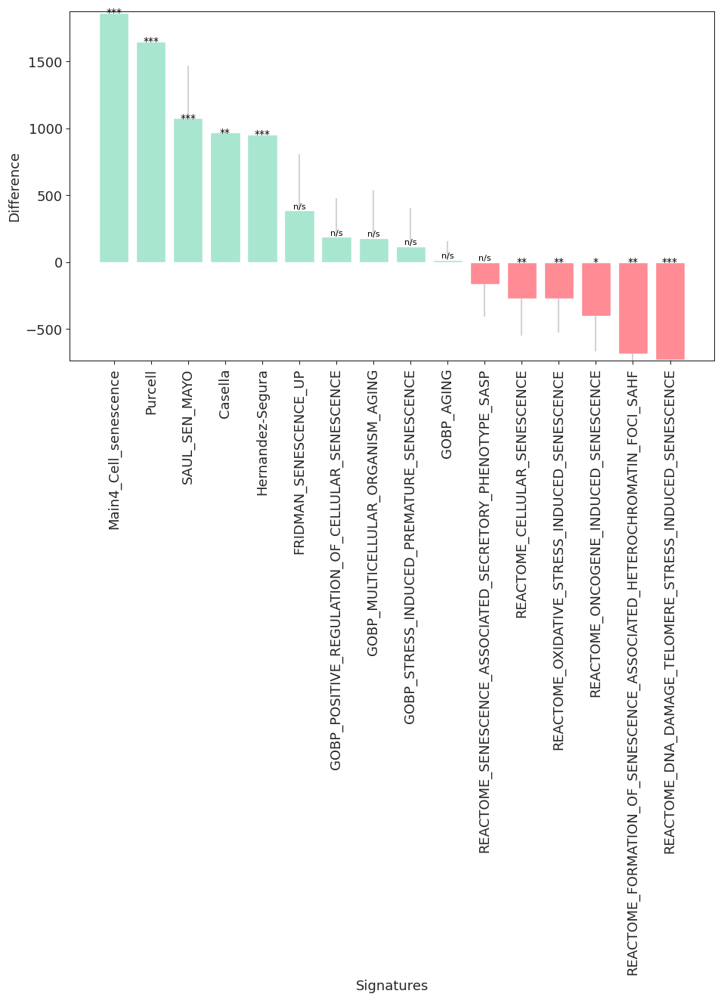

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_sen, annot_test.Senescence, annot_test.Dataset
)
plot_waterfall(
    out, out_mw_corrected, out_stdev, main_column="Senescent", save=False
)  # path_to_save= 'figures/senescence_waterfall_unscaled.svg'

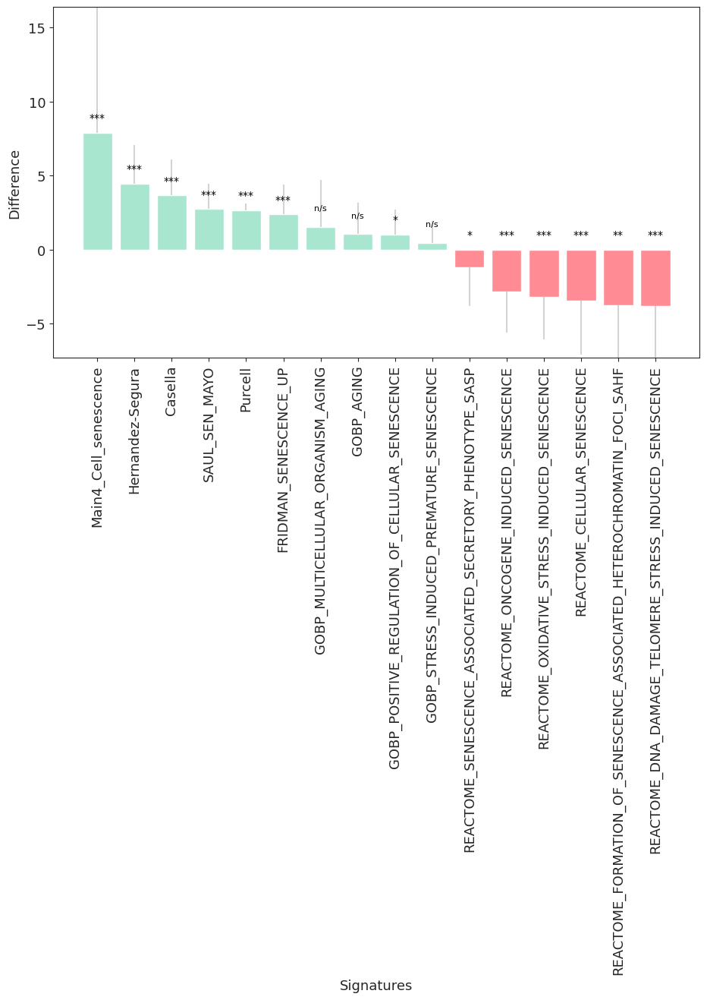

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_sen_scaled, annot_test.Senescence, annot_test.Dataset
)
plot_waterfall(
    out, out_mw_corrected, out_stdev, main_column="Senescent", save=False
)  # path_to_save= 'figures/senescence_waterfall_scaled.svg'

Figure 5G

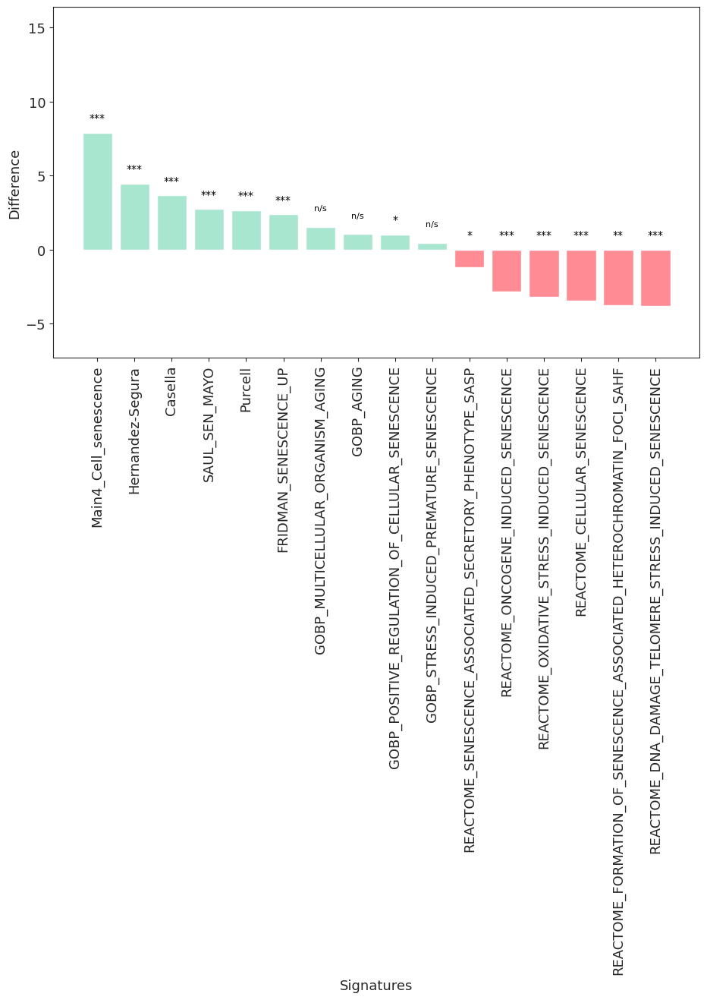

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_sen_scaled, annot_test.Senescence, annot_test.Dataset
)
plot_waterfall(
    out,
    out_mw_corrected,
    out_stdev,
    main_column="Senescent",
    errorbar=False,
    path_to_save="/uftp/users/msavchenko/figures/senescence_waterfall_scaled_no_error_bars.svg",
)

In [ ]:
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_sen_scaled, annot_test.Senescence, annot_test.Dataset
)
gene_count = pd.DataFrame(columns=["Difference", "n_genes"])
gene_count["Difference"] = out.Senescent - out.Not_senescent
for i in gmt.keys():
    gene_count["n_genes"][i] = len(gmt[i].genes)
out, out_stdev, out_mw_corrected = process_generic_dataset(
    df_sen, annot_test.Senescence, annot_test.Dataset
)
gene_count["Difference_unscaled"] = out.Senescent - out.Not_senescent

In [ ]:
gene_count["Source"] = ""
gene_count["Source"]["FRIDMAN_SENESCENCE_UP"] = "Literature"
gene_count["Source"]["GOBP_AGING"] = "Pathway"
gene_count["Source"]["GOBP_MULTICELLULAR_ORGANISM_AGING"] = "Pathway"
gene_count["Source"]["GOBP_POSITIVE_REGULATION_OF_CELLULAR_SENESCENCE"] = "Pathway"
gene_count["Source"]["GOBP_STRESS_INDUCED_PREMATURE_SENESCENCE"] = "Pathway"
gene_count["Source"]["REACTOME_CELLULAR_SENESCENCE"] = "Pathway"
gene_count["Source"][
    "REACTOME_DNA_DAMAGE_TELOMERE_STRESS_INDUCED_SENESCENCE"
] = "Pathway"
gene_count["Source"][
    "REACTOME_FORMATION_OF_SENESCENCE_ASSOCIATED_HETEROCHROMATIN_FOCI_SAHF"
] = "Pathway"
gene_count["Source"]["REACTOME_ONCOGENE_INDUCED_SENESCENCE"] = "Pathway"
gene_count["Source"]["REACTOME_OXIDATIVE_STRESS_INDUCED_SENESCENCE"] = "Pathway"
gene_count["Source"][
    "REACTOME_SENESCENCE_ASSOCIATED_SECRETORY_PHENOTYPE_SASP"
] = "Pathway"
gene_count["Source"]["SAUL_SEN_MAYO"] = "One_tissue_type"
gene_count["Source"]["Main4_Cell_senescence"] = "BG_signature"
gene_count["Source"]["Hernandez-Segura"] = "Several_lines_of_different_cell_types"
gene_count["Source"]["Casella"] = "Several_lines_of_different_cell_types"
gene_count["Source"]["Purcell"] = "One_cell_line"

In [158]:
gene_count

,Difference,n_genes,Difference_unscaled,Source
FRIDMAN_SENESCENCE_UP,2.385202,77,385.757445,Literature
GOBP_AGING,1.049983,169,15.380252,Pathway
GOBP_MULTICELLULAR_ORGANISM_AGING,1.545709,26,179.179797,Pathway
GOBP_POSITIVE_REGULATION_OF_CELLULAR_SENESCENCE,1.020592,19,187.274739,Pathway
GOBP_STRESS_INDUCED_PREMATURE_SENESCENCE,0.459187,8,117.070661,Pathway
REACTOME_CELLULAR_SENESCENCE,-3.466410,198,-272.923985,Pathway
REACTOME_DNA_DAMAGE_TELOMERE_STRESS_INDUCED_SENESCENCE,-3.806043,80,-734.909712,Pathway
REACTOME_FORMATION_OF_SENESCENCE_ASSOCIATED_HETEROCHROMATIN_FOCI_SAHF,-3.773212,17,-688.964469,Pathway
REACTOME_ONCOGENE_INDUCED_SENESCENCE,-2.832776,35,-401.379676,Pathway
REACTOME_OXIDATIVE_STRESS_INDUCED_SENESCENCE,-3.221865,126,-274.045441,Pathway


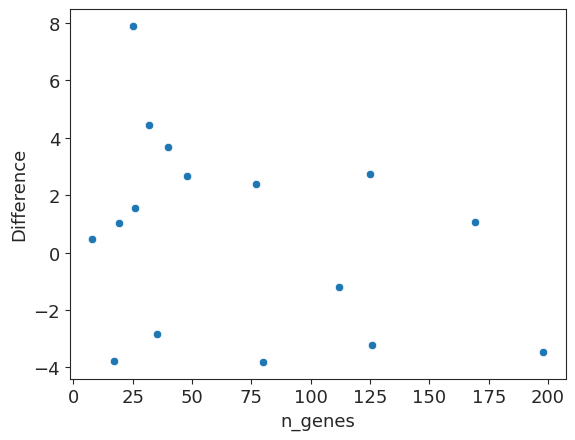

In [ ]:
sns.scatterplot(x="n_genes", y="Difference", data=gene_count)
plt.rcParams["svg.fonttype"] = "none"
# plt.savefig("/uftp/users/msavchenko/figures/Senescence_signature_comparison_length.svg", format="svg")
plt.show()

Suppl figure 3B

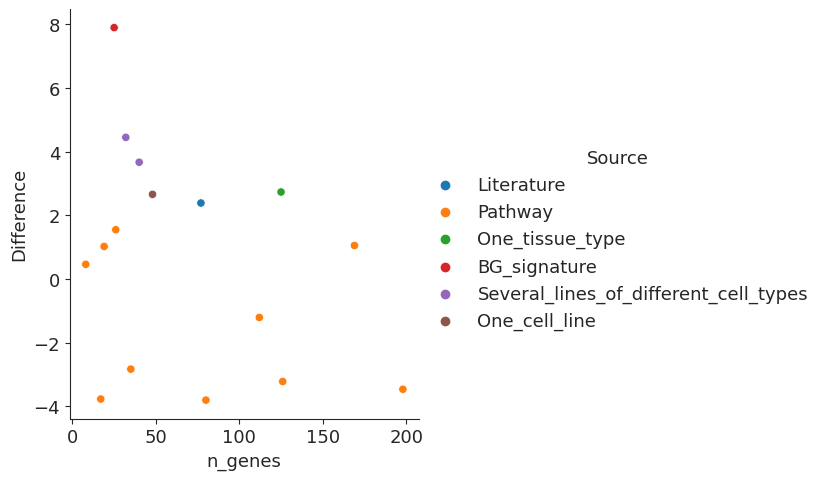

In [ ]:
sns.relplot(
    data=gene_count,
    x="n_genes",
    y="Difference",
    hue="Source",  # size="Difference_unscaled",
)
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_comparison_length.svg",
    format="svg",
)
plt.show()

In [ ]:
# out, out_stdev, out_mw_corrected = process_generic_dataset(df_sen_scaled, annot_test.Senescence, annot_test.Dataset)
# out_source, out_stdev_source, out_mw_corrected_source = process_generic_dataset(out, gene_count.Source, gene_count.Source)
# plot_waterfall(out_source, out_mw_corrected_source, out_stdev_source, main_column='Senescent', save=False) #path_to_save= 'figures/senescence_waterfall_scaled_source.svg'

In [ ]:
sen_signatures = {}
for i in gmt.keys():
    df = pd.DataFrame(columns=["ssGSEA", "Senescence", "Signature"])
    df.ssGSEA = df_sen_scaled[i]
    df.Senescence = annot.Senescence
    df.Signature = i
    df.index = df.index.astype(str) + i
    sen_signatures[i] = df
sen_signatures = pd.concat(sen_signatures.values())
sen_signatures

,ssGSEA,Senescence,Signature
SRX3092184FRIDMAN_SENESCENCE_UP,-1.447234,Senescent,FRIDMAN_SENESCENCE_UP
SRX3092183FRIDMAN_SENESCENCE_UP,1.225678,Senescent,FRIDMAN_SENESCENCE_UP
SRX3092182FRIDMAN_SENESCENCE_UP,0.774322,Senescent,FRIDMAN_SENESCENCE_UP
SRX3092181FRIDMAN_SENESCENCE_UP,0.580479,Senescent,FRIDMAN_SENESCENCE_UP
SRX3092180FRIDMAN_SENESCENCE_UP,0.032581,Senescent,FRIDMAN_SENESCENCE_UP
...,...,...,...
SRX1595735Purcell,2.342207,Senescent,Purcell
SRX1595736Purcell,-0.962184,Not_senescent,Purcell
SRX1595737Purcell,0.962184,Senescent,Purcell
SRX2693186Purcell,-1.000000,Not_senescent,Purcell


Suppl figure 3J

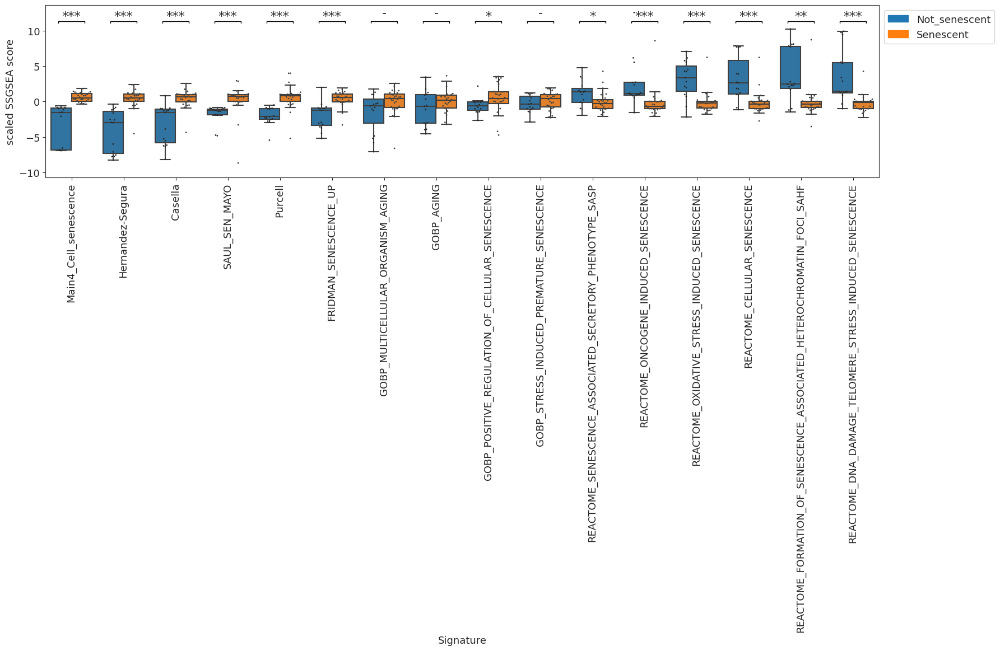

In [ ]:
# boxplot depicting signature SSGSEA score in signatures of interest

categories = gene_count.sort_values("Difference", ascending=False).index

grouped_boxplot_with_pvalue(
    sen_signatures["ssGSEA"],
    sen_signatures[sen_signatures["Signature"].isin(categories)]["Signature"],
    order=categories,
    s=2,
    hue=sen_signatures[sen_signatures["Signature"].isin(categories)]["Senescence"],
    hue_order=["Not_senescent", "Senescent"],
    y_min=-8,
    y_max=10,
)

plt.xticks(rotation=90)
plt.ylabel("scaled SSGSEA score")
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_comparison_grouped.svg",
    format="svg",
)
plt.show()

# Signature validation: Sorted cells and cell lines, public

## read anno

In [ ]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(
    Path("/uftp2/Databases/sorted_cell_databases/").iterdir(), key=os.path.getmtime
)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [ ]:
cells_clean = read_dataset(
    "/uftp2/Databases/sorted_cell_databases/march2022/cells_clean_annotation.tsv"
)

In [ ]:
cells_clean = cells_clean[
    (~cells_clean.index.str.contains("RNA"))
    & (~cells_clean.index.str.contains("WES"))
    & (~cells_clean.index.str.contains("210514_NovaA"))
]

In [178]:
cells_clean.head()

,Readcounts,Sample,Dataset,Cell_type,Cell_type_details,Extended_details,Stimulation,Therapy,Modification,Material_type,Diagnosis,Sorting_markers,Comment,Cell_origin,Who_checks,Deconvolution_cell_type,Decision
SRX2378883,7762698.0,SRX2378883,GSE90569,CD4_T_cells,Tregs,2h of activation,"antiCD3, antiCD28, IL2, TGFb and ATRA",Without_therapy,Without_modification,polyA RNA,Healthy,CD4+ CD25-,"Check expressions, whether it's a good idea to...",Umbilican_cord_blood,dafenteva,CD4_T_cells,good
SRX2200829,5942869.0,SRX2200829,GSE87505,T_cells,NaN,cryopreserved PBMC,Without_treatment,No_data,Without_modification,polyA RNA,Healthy,CD3+ CD4+ !(CCR7+ CD45RA+),Whether it's memory cells,PBMC,vbelyaeva,T_cells,ok
SRX3263523,13447321.0,SRX3263523,GSE104744,Monocytes,NaN,derived from stage IV Melanoma patients,Without_treatment,immune therapy,Without_modification,polyA RNA,Melanoma,CD14+,NaN,Whole Blood,ddyikanov,Monocytes,good
SRX4525762,9250040.0,SRX4525762,GSE118373,Hepatic_progenitor_cells,Hepatic progenitor cells,NaN,Treatment protocol: acetone fixation/cresyl vi...,No_data,Without_modification,polyA RNA,Chronic_viral_hepatitis_C,NaN,Treatment protocol: acetone fixation/cresyl vi...,Liver,dafenteva,Hepatic_progenitor_cells,good
SRX4797320,9112747.0,SRX4797320,GSE112101,B_cells,NaN,NaN,22.7 mcM_Methylprednisolone_6h,NaN,NaN,polyA RNA,Healthy,CD45+ CD19+ CD3–,NaN,PBMC,dafenteva,B_cells,good


NB: Клеточный тип из описания датасета обозначен в колонке Cell_type, однако бывает, 
    что более подробное описание образца содержится в колонке Cell_type_details. 
    Также есть колонка Deconvolution_cell_type, 
    в которой значению в колонке Cell_type по возможности сопоставляется такой клеточный тип, 
    для которого сейчас существует модель (https://bostongene.atlassian.net/wiki/spaces/TD/pages/3626696724/bulk+RNA-seq)

In [ ]:
cells_clean = cells_clean[["Cell_type", "Dataset", "Sample", "Cell_origin"]]

In [180]:
public_cells_annot = cells_clean.copy()
public_cells_annot = public_cells_annot.reset_index(drop=True)

In [ ]:
# split celltypes in case there are multiple celltypes per sample

celltypes_split = pd.DataFrame()

for i, j in public_cells_annot.dropna(subset=["Cell_type"]).iterrows():
    if ";" in j["Cell_type"]:
        ct = j["Cell_type"].split(";")
        new_row = j.copy()
        for c in ct:
            new_row["Cell_type"] = c
            celltypes_split = celltypes_split.append(new_row, ignore_index=True)
        public_cells_annot.drop(i, inplace=True)

public_cells_annot = public_cells_annot.append(celltypes_split)

In [182]:
public_cells_annot.index = public_cells_annot.Sample

In [ ]:
# TAM
public_cells_annot["Cell_type"] = [
    (
        public_cells_annot[public_cells_annot.index == x]["Cell_type"]
        .replace("Macrophages", "TAM")
        .get(x)
        if x
        in [
            "SRX4495404",
            "ERX1270123",
            "ERX1270124",
            "ERX1270125",
            "ERX1270126",
            "ERX1270127",
            "ERX1270128",
            "ERX1270130",
        ]
        else public_cells_annot[public_cells_annot.index == x]["Cell_type"].get(x)
    )
    for x in public_cells_annot.index
]

In [ ]:
# Mast cells
cells_annot = get_gspread("Cells", "Cells")
cells_annot = cells_annot.loc[cells_annot.Cell_type.str.contains("Mast_cells")]
cells_annot = prepare_sample_annot(cells_annot)
cells_annot = cells_annot[["Cell_type", "Dataset", "Cell_origin"]]
cells_to_check_annot = get_gspread("Annotation calculated", "Cells_to_check")
cells_to_check_annot = cells_to_check_annot.loc[
    cells_to_check_annot.Cell_type.str.contains("Mast_cells")
]
cells_to_check_annot = prepare_sample_annot(cells_to_check_annot)
cells_to_check_annot = cells_to_check_annot[["Cell_type", "Dataset", "Cell_origin"]]
public_cells_annot = pd.concat([public_cells_annot, cells_annot, cells_to_check_annot])
public_cells_annot = public_cells_annot.loc[
    ~public_cells_annot.index.isin(
        [
            "SRX5026003",
            "SRX5026001",
            "SRX5026000",
            "SRX5026002",
            "SRX5025998",
            "SRX5025999",
            "SRX9977242",
            "SRX9977243",
        ]
    )
]  # bad samples

In [ ]:
# Epithelium
cells_annot = get_gspread("Cells", "Cells")
cells_annot = cells_annot.loc[cells_annot.Cell_type.str.contains("Epithelium")]
cells_annot = cells_annot.loc[~cells_annot["Readcounts"].isin([""])]
cells_annot = cells_annot.loc[~cells_annot["QC_score"].isin([""])]
cells_annot = prepare_sample_annot(cells_annot)
cells_annot = cells_annot[["Cell_type", "Dataset", "Cell_origin"]]
cells_annot = cells_annot.loc[
    ~cells_annot.index.isin(
        [
            "SRX3862287",
            "SRX1023930",
            "SRX1023931",
            "SRX1023932",
            "SRX3862298",
            "SRX3862286",
            "SRX4794853",
            "SRX4794854",
            "SRX4794855",
            "SRX4794856",
            "SRX4794857",
            "SRX3862299",
            "SRX3862345",
            "SRX4123705",
            "SRX3862310",
            "SRX3862344",
            "SRX3862323",
            "SRX3832322",
            "SRX3862311",
        ]
    )
]  # bad samples
public_cells_annot = pd.concat([public_cells_annot, cells_annot])

## anno stats

In [ ]:
pd.options.display.max_rows = len(public_cells_annot["Cell_type"].value_counts())
public_cells_annot["Cell_type"].value_counts()

CD4_T_cells                           1266
Macrophages                            519
CD8_T_cells                            453
Monocytes                              435
Fibroblasts                            418
Endothelium                            322
NK_cells                               202
Neutrophils                            199
Cardio_myofibroblasts                  197
Macrophages_M1                         189
Monocytic_DC                           169
T_cells                                148
Memory_CD4_T_cells                     129
Non_plasma_B_cells                     128
Tregs                                  120
Hepatocytes                            113
B_cells                                109
Dendritic_cells                         86
CD4_T_helpers                           73
Epithelium                              63
PDC                                     58
Myeloid_cells                           54
Mast_cells                              51
Follicular_

In [187]:
pd.options.display.max_rows = 20

In [188]:
public_cells_annot.head()

,Cell_type,Dataset,Sample,Cell_origin
SRX2378883,CD4_T_cells,GSE90569,SRX2378883,Umbilican_cord_blood
SRX2200829,T_cells,GSE87505,SRX2200829,PBMC
SRX3263523,Monocytes,GSE104744,SRX3263523,Whole Blood
SRX4525762,Hepatic_progenitor_cells,GSE118373,SRX4525762,Liver
SRX4797320,B_cells,GSE112101,SRX4797320,PBMC


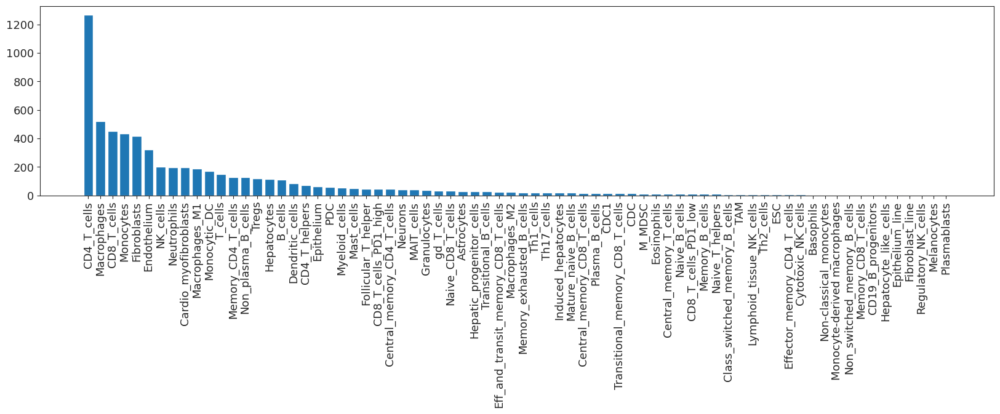

In [ ]:
# a little bit of statistics
# example: which cell types do we have in lab_cells_annot?
plt.figure(figsize=(20, 4))
x = public_cells_annot["Cell_type"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

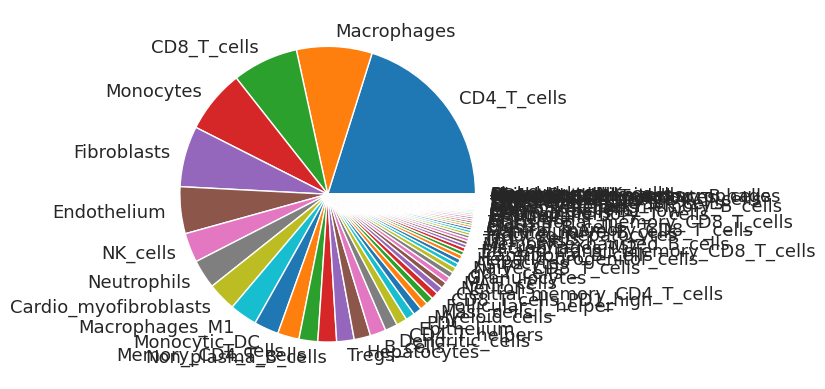

In [190]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [191]:
public_cells_expr = read_expressions(public_cells_annot)

In [ ]:
public_cells_expr = np.log2(public_cells_expr + 1)

## define custom signature

In [ ]:
# current signature
signature_of_interest = [
    "CDKN2A",
    "CDKN1A",
    "CDKN2B",
    "GLB1",
    "SERPINE1",
    "DPP4",
    # 'NOX4',
    "CEBPB",
    # 'BHLHE40',
    "BCL2L1",
    "BCL2L2",
    "TNFRSF10D",
    # 'CAV1',
    "ITGB3",
    "IGFBP3",
    "MMP3",
    "CCL2",
    "IL6",
    "CXCL8",
    "CXCL1",
    "IL1B",
    "TGFB1",
    "GDF15",
    "IGFBP7",
    "PLAU",
    "STAT1",
    "IGFBP2",
    "ATF3",
]

# add here a custon signature name
signature_name = "Senescence_up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation itself

In [ ]:
# define celltypes of interest
categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, public_cells_annot.loc[public_cells_annot["Cell_type"].isin([i])]]
    )
annot = annot.loc[
    ~annot.index.isin(
        ["SRX6369364", "SRX7052817", "SRX3361935", "SRX3208751", "SRX3208713"]
    )
]  # dirty samples
annot1 = sen_cells_annot
annot1["Cell_type"] = annot1["Senescence"]
# annot1 = annot1.loc[~annot1.Dataset.isin(['GSE130727'])]
annot = pd.concat([annot1, annot])
annot = annot[~annot.index.duplicated()]
# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(
    annot["Cell_type"], categories=categories, ordered=True
)
annot = annot.sort_values("Cell_type")

In [ ]:
subsampling_public = [
    i[1].sample(np.min([5, i[1].shape[0]])).index.tolist()
    for i in annot.groupby("Cell_type")
]

In [196]:
subsampling_public = [item for sublist in subsampling_public for item in sublist]

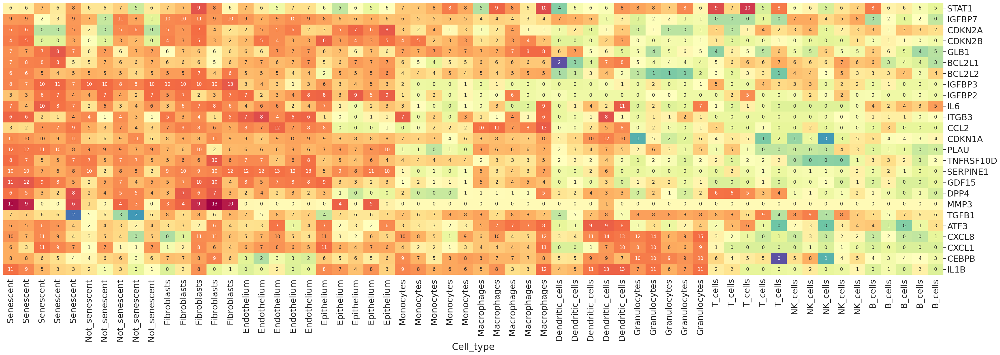

In [ ]:
# A simple heatmap with log2 TPM of subsampled cells from celltypes of interest
genes_heatmap(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ][subsampling_public],
    annot.reindex(subsampling_public)["Cell_type"],
    signature_of_interest,
    show_expression=True,
    highlight_genes=[],
    gene_highlight_lw=1,
    highlight_columns=[],
    col_highlight_color="blue",
    figsize=(45, 15),
    font_scale=2,
    show_indices=False,
    col_cluster=False,
    col_dendrogram=False,
    row_dendrogram=False,
)
plt.show()

In [ ]:
sns.reset_defaults()
sns.set_style("white")

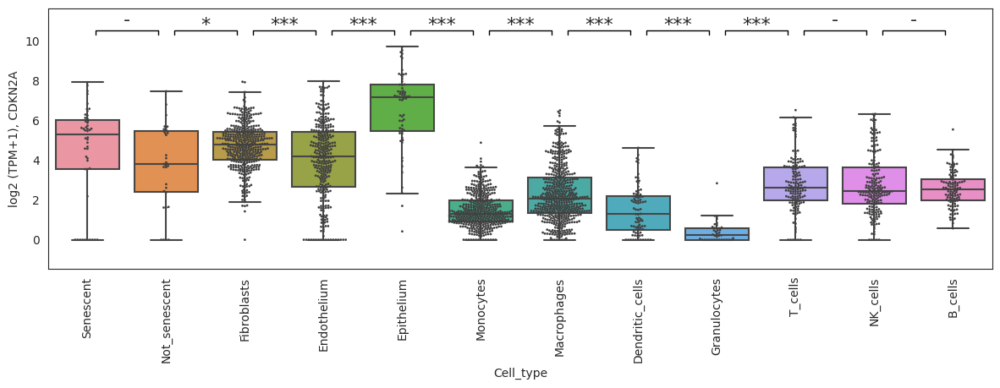

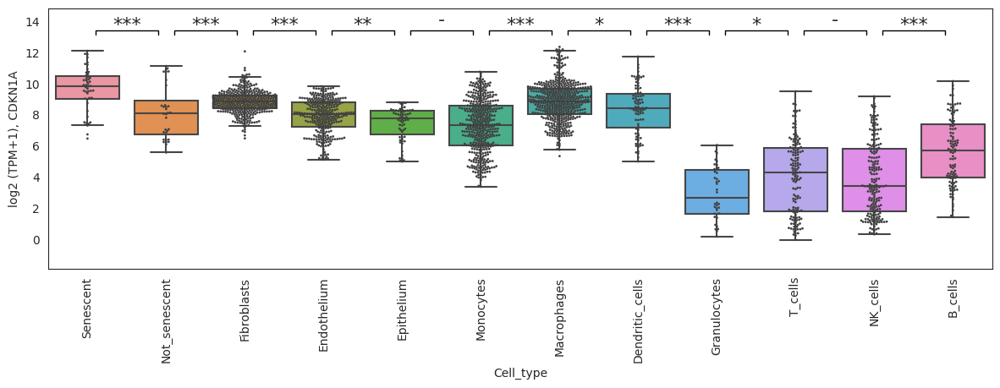

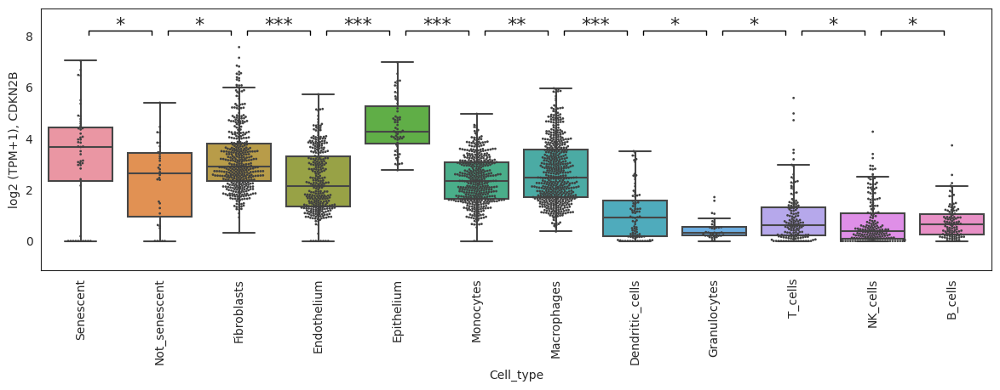

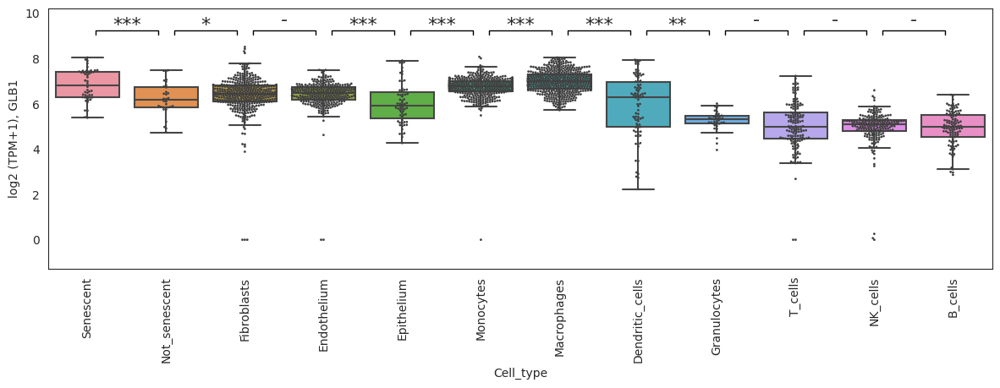

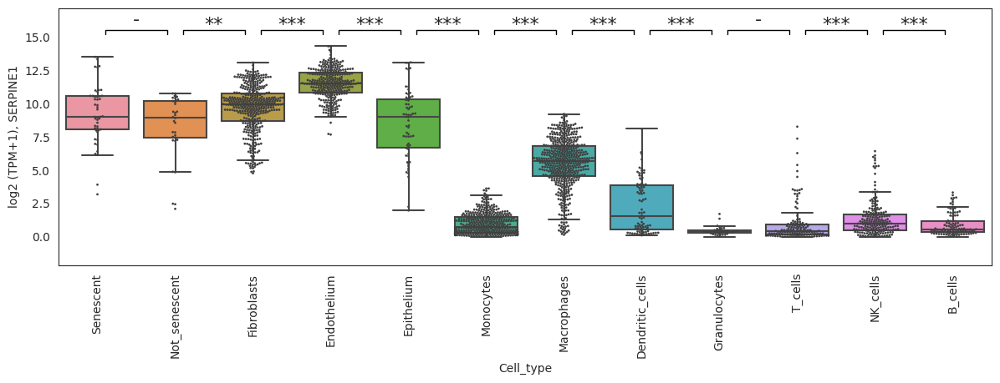

...

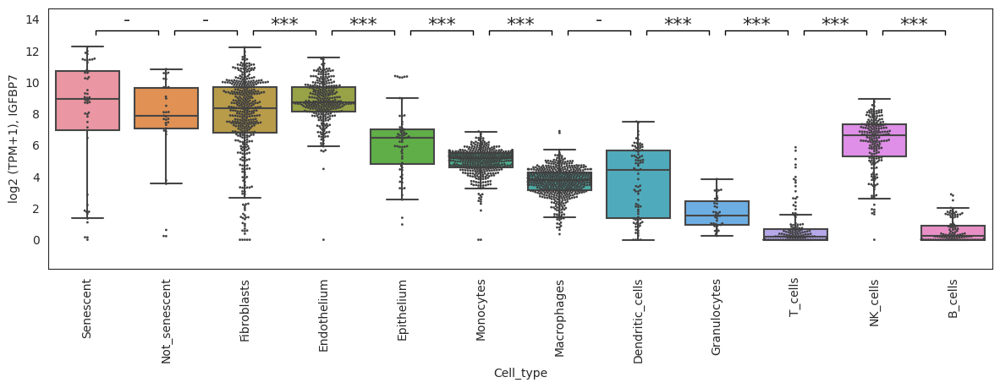

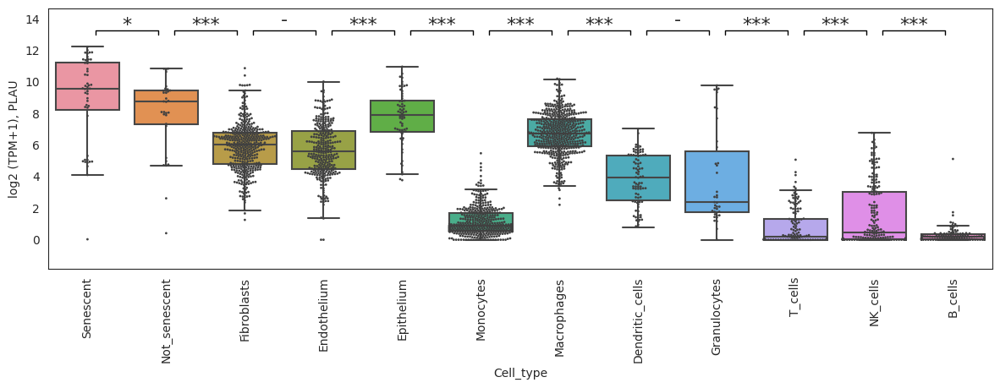

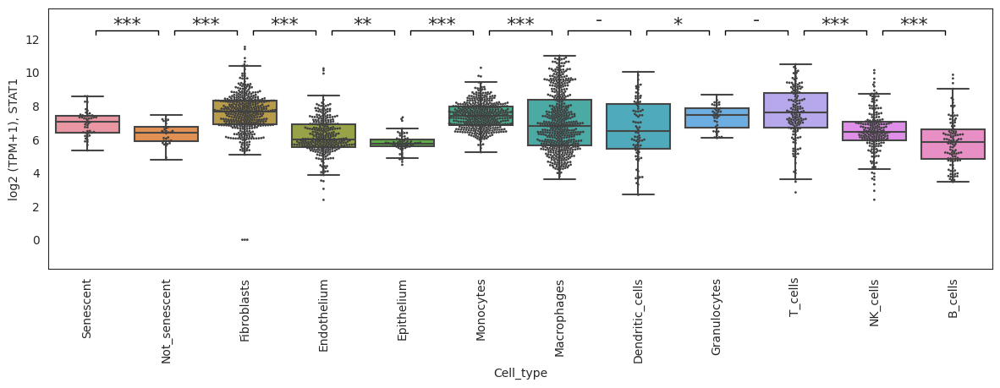

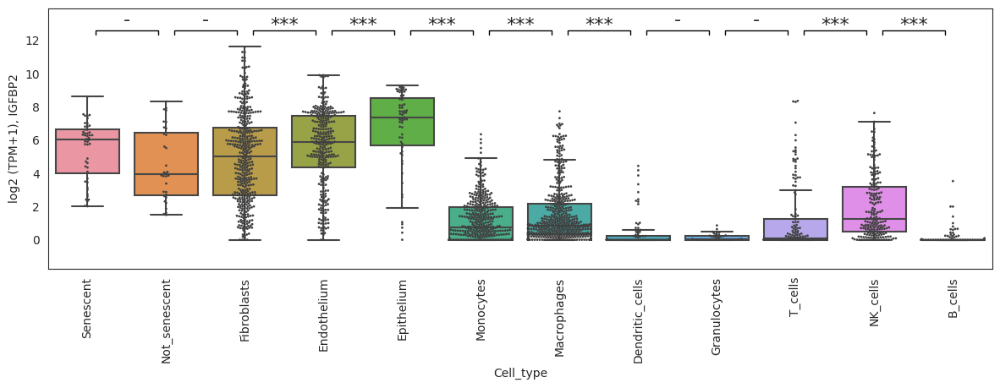

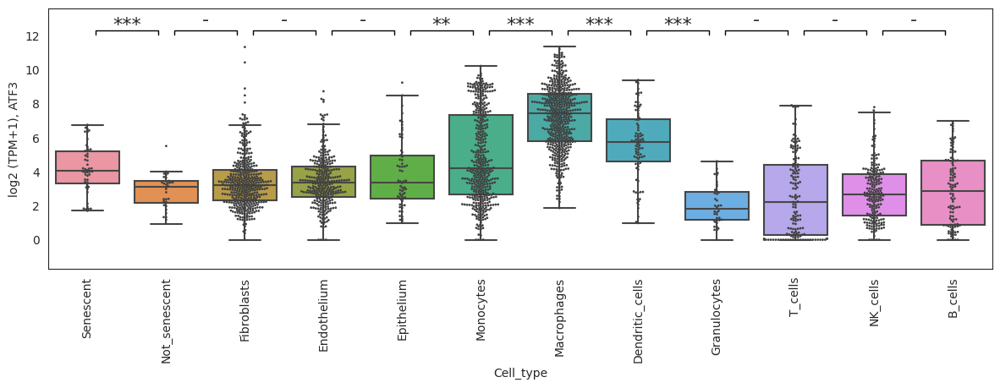

In [ ]:
# boxplots depicting signature genes expression in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        pd.concat([public_cells_expr, sen_cells_expr], axis=1)
        .loc[
            :,
            ~pd.concat(
                [public_cells_expr, sen_cells_expr], axis=1
            ).columns.duplicated(),
        ]
        .loc[gene],
        annot[annot["Cell_type"].isin(categories)]["Cell_type"],
        order=categories,
        s=2,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ],
    gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False),
).T

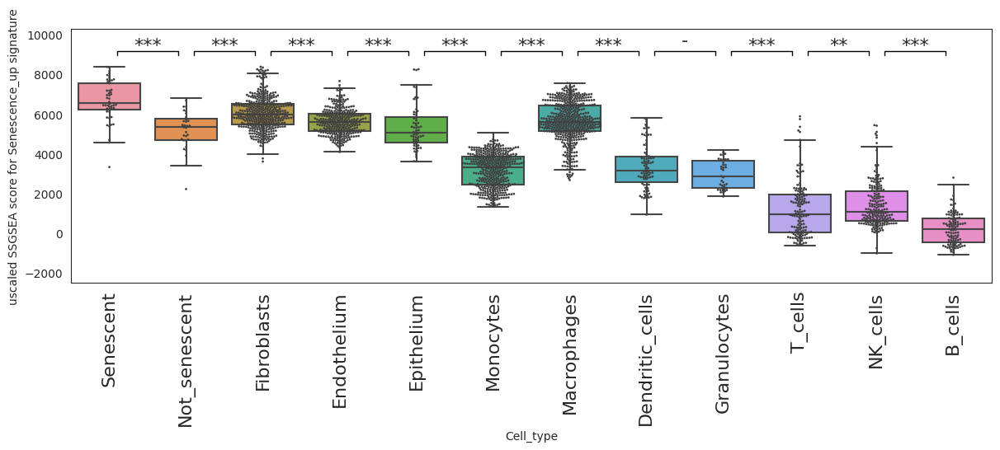

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=2,
    p_fontsize=16,
)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

#### other signatures to compare with

In [ ]:
signature_of_interest = """ALDH1A3	CCND1	CD44	CDKN1A	CDKN1C	CDKN2A	CDKN2B	CDKN2D	CITED2	CLTB	COL1A2	CREG1	CRYAB	CXCL14	CYP1B1	EIF2S2	ESM1	F3	FILIP1L	FN1	GSN	GUK1	HBS1L	HPS5	HSPA2	HTATIP2	IFI16	IFNG	IGFBP1	IGFBP2	IGFBP3	IGFBP4	IGFBP5	IGFBP6	IGFBP7	IGSF3	ING1	IRF5	IRF7	ISG15	MAP1LC3B	MAP2K3	MDM2	MMP1	NDN	NME2	NRG1	OPTN	PEA15	RAB13	RAB31	RAB5B	RABGGTA	RAC1	RBL2	RGL2	RHOB	RRAS	S100A11	SERPINB2	SERPINE1	SMPD1	SMURF2	SOD1	SPARC	STAT1	TES	TFAP2A	TGFB1I1	THBS1	TNFAIP2	TNFAIP3	TP53	TSPYL5	VIM""".split(
    "\t"
)
# OR
# signature_of_interest = ['EPX', 'RNASE2', 'IL5RA', 'SIGLEC8', 'ADGRE1', 'LGALS12']

# add here a custon signature name
signature_name = "Fridman_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ],
    gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False),
).T

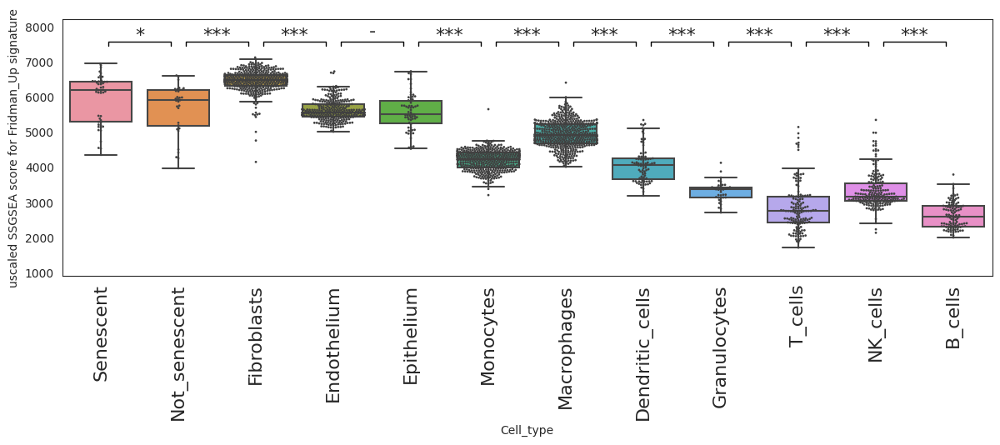

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=2,
    p_fontsize=16,
)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ARRDC4	BLCAP	CCND3	CHPF2	CLDN1	CLSTN2	DHRS7	DIO2	ELMOD1	FAM234B	FILIP1L	GPR155	H2AFJ	JCAD	KIAA1671	LRP10	NCSTN	PAM	PDLIM1	PLOD1	POFUT2	PTCHD4	RND3	SAMD9L	SARAF	SLC16A14	SLC9A7	SLCO2B1	SMCO3	SRPX	SRPX2	STAT1	TAP1	TMEM159	TMEM30A	TMEM59	TNFRSF10C	TNFSF13B	WDR63	WDR78""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Casella_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ],
    gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False),
).T

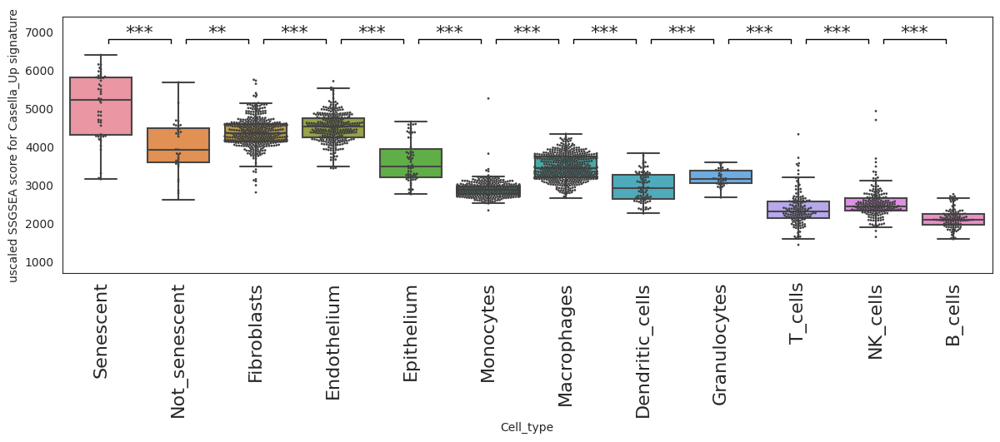

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=2,
    p_fontsize=16,
)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """ACADVL	ADPGK	B4GALT7	BCL2L2	CCND1	CHMP5	DDA1	DGKA	DYNLT3	FAM214B	GBE1	GDNF	KLC1	MT-CYB	NOL3	P4HA2	PDLIM4	PLK3	PLXNA3	POFUT2	RAI14	SCOC	SLC10A3	SLC16A3	SUSD6	TAF13	TMEM87B	TOLLIP	TSPAN13	UFM1	ZBTB7A	ZNHIT1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Hernandez-Segura_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ],
    gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False),
).T

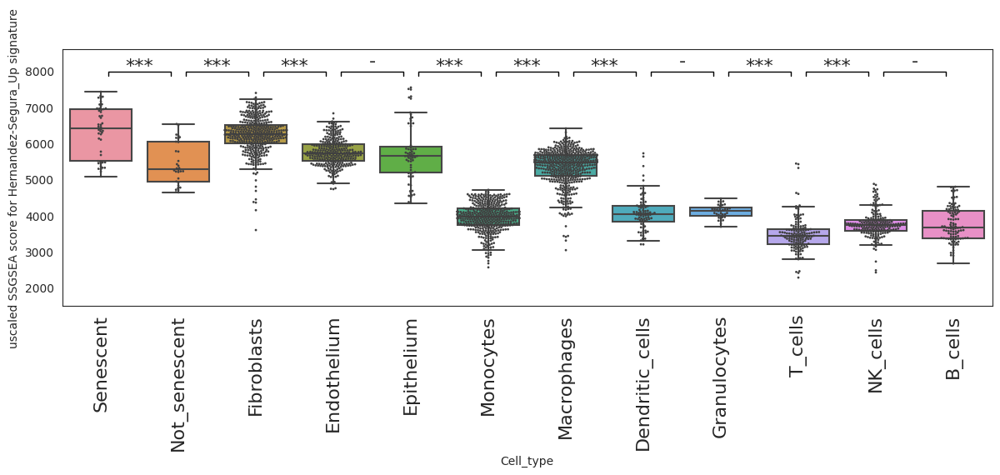

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=2,
    p_fontsize=16,
)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

In [ ]:
signature_of_interest = """APOL1	GBP4	COL17A1	GNG11	BIRC3	CTSS	EPSTI1	S1PR3	PMAIP1	TNFAIP3	APOL3	DUSP6	LCP1	ATF3	RSPO3	IDO1	LGALS9	CD163L1	MLKL	MYD88	BATF2	OASL	RTP4	C3	ISG20	CXCL2	ICAM1	IFI27	IL1B	GCA	IL32	IL1A	CD82	MMP12	IL1RN	HERC5	TNFAIP6	TNFRSF1B	PLAU	IFI30	CLDN1	CCDC80	NEGR1	ODZ2	GMPR	ITGB3	SCN3A	CYP1A1""".split(
    "\t"
)
# OR
# signature_of_interest = ['IGLL3P', 'IGKC']

# add here a custon signature name (as a first input)
signature_name = "Purcell_Up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

In [ ]:
public_cells_ssgsea_unscaled = ssgsea_formula(
    pd.concat([public_cells_expr, sen_cells_expr], axis=1).loc[
        :, ~pd.concat([public_cells_expr, sen_cells_expr], axis=1).columns.duplicated()
    ],
    gmt_genes_alt_names(geneset_of_interest, public_cells_expr.index, verbose=False),
).T

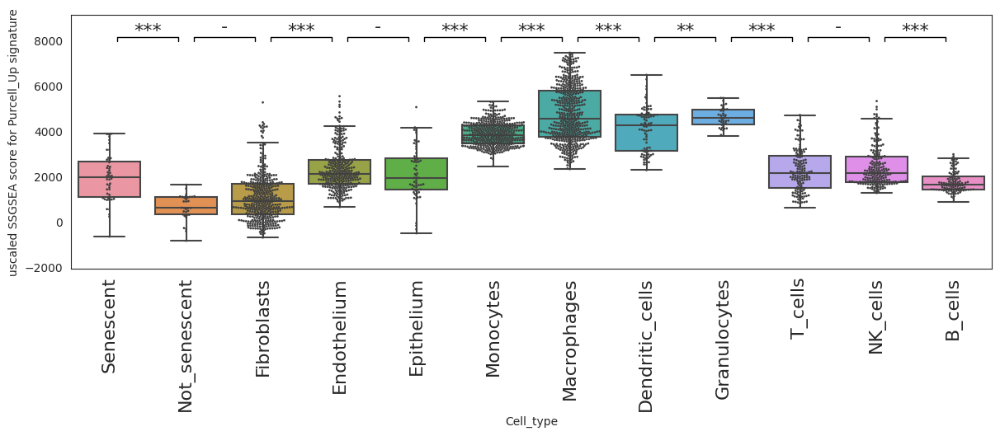

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Senescent",
    "Not_senescent",
    "Fibroblasts",
    "Endothelium",
    "Epithelium",
    "Monocytes",
    "Macrophages",
    "Dendritic_cells",
    "Granulocytes",
    "T_cells",
    "NK_cells",
    "B_cells",
]

boxplot_with_pvalue(
    public_cells_ssgsea_unscaled[signature_name],
    annot[annot["Cell_type"].isin(categories)]["Cell_type"],
    order=categories,
    s=2,
    p_fontsize=16,
)

plt.xticks(rotation=90, fontsize=16)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: Cancer cell lines

## read anno

In [ ]:
# Here we check which version of annotation is the newest - oldest directories go first
paths = sorted(
    Path("/uftp2/Databases/sorted_cell_databases/").iterdir(), key=os.path.getmtime
)
paths

[PosixPath('/uftp2/Databases/sorted_cell_databases/jan2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/march2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/june2022'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/jan2023'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/current_version'),
 PosixPath('/uftp2/Databases/sorted_cell_databases/March2024')]

In [ ]:
cells_clean = read_dataset(
    "/uftp2/Databases/sorted_cell_databases/current_version/cancer_cell_lines_all_annotation.tsv"
)

In [ ]:
cells_clean = cells_clean[["Tumor_type", "Dataset", "Sample", "Therapy"]]

In [219]:
cancer_cells_annot = cells_clean.copy()

## anno stats

In [ ]:
pd.options.display.max_rows = len(cancer_cells_annot["Tumor_type"].value_counts())
cancer_cells_annot["Tumor_type"].value_counts()

Lung_Adenocarcinoma                                  886
Prostate_Cancer                                      553
Pancreatic_Ductal_Adenocarcinoma                     269
Melanoma                                             247
Invasive_Breast_Carcinoma                            188
Acute_Myeloid_Leukemia                               186
EBV-B_cells                                          185
Large_Cell_Lung_Carcinoma                            181
Diffuse_Large_B_Cell_Lymphoma                        176
Mantle_Cell_Lymphoma                                 167
Cutaneous_Melanoma                                   126
Squamous_Cell_Carcinoma_of_the_Head_and_Neck         121
Chronic_Lymphocytic_Leukemia                         114
Colon_Adenocarinoma                                  102
Breast_Adenocarcinoma                                 95
Colon_Carinoma                                        94
Breast_Neoplasm                                       87
Glioblastoma                   

In [221]:
pd.options.display.max_rows = 20

In [222]:
cancer_cells_annot.head()

,Tumor_type,Dataset,Sample,Therapy
SRX4143039,Small_Cell_Lung_Carcinoma,GSE115122,SRX4143039,Without_therapy
SRX2495594,Diffuse_Large_B_Cell_Lymphoma,GSE93675,SRX2495594,Without_therapy
SRX3506075,Lung_Adenocarcinoma,GSE108464,SRX3506075,Without_therapy
SRX2314325,Diffuse_Large_B_Cell_Lymphoma,GSE89339,SRX2314325,Without_therapy
SRX2035865,Multiple_Myeloma,GSE85840,SRX2035865,Without_therapy


In [223]:
pd.crosstab(cancer_cells_annot.Tumor_type, cancer_cells_annot.Therapy)

Therapy,BRAFi,BRAFi+MEKi,BTK inhibitor (Ibrutinib),Day_10_of_PBS,Day_10_of_Ribavarin_80mg/kg/twice daily intraperitoneally,Lck inhibitor,No_data,Without_therapy,previously treated for non-Hodgkin lymphoma (NHL),"rituximab dosed 25 mg/kg, three times a week over 21 days."
Tumor_type,,,,,,,,,,
Acute_Erythroid_Leukemia,0,0,0,0,0,0,6,0,0,0
Acute_Lymphoblastic_Leukemia,0,0,0,0,0,0,0,42,0,0
Acute_Monocytic_Leukemia,0,0,0,0,0,0,0,20,0,0
Acute_Myeloid_Leukemia,0,0,0,0,0,0,0,186,0,0
Adenosquamous_Cell_Lung_Carcinoma,0,0,0,0,0,0,0,4,0,0
...,...,...,...,...,...,...,...,...,...,...
hESC,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 1,0,0,0,0,0,0,1,0,0,0
mesenchymal stem cells day 3,0,0,0,0,0,0,1,0,0,0


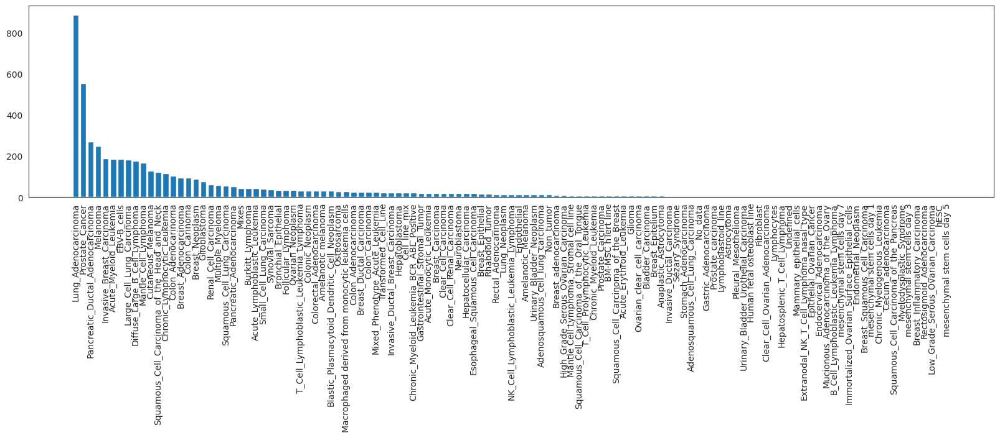

In [ ]:
# a little bit of statistics
# example: which cell types do we have in cancer_cells_annot?
plt.figure(figsize=(20, 4))
x = cancer_cells_annot["Tumor_type"].value_counts().sort_values(ascending=False)
plt.bar(range(len(x)), x)
plt.xticks(range(len(x)), x.index, rotation=90)
plt.show()

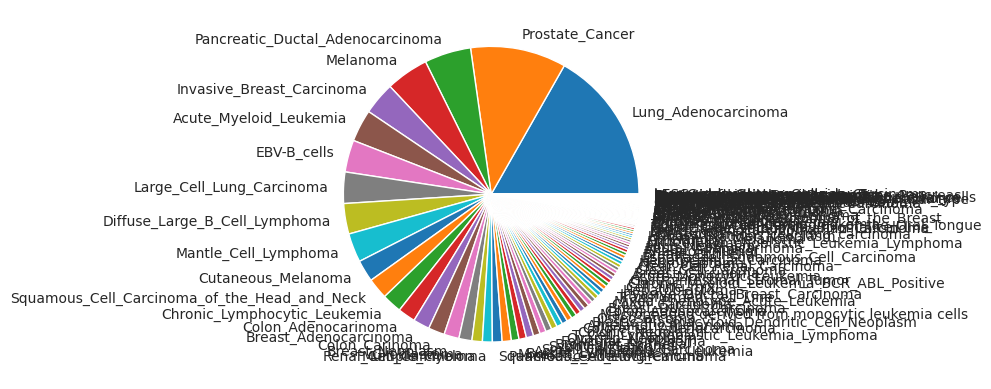

In [225]:
plt.pie(x, labels=x.index)
plt.show()

## read expressions

In [226]:
cancer_cells_expr = read_expressions(cancer_cells_annot)

In [ ]:
cancer_cells_expr = np.log2(cancer_cells_expr + 1)

## define custom signature

In [ ]:
# current signature
signature_of_interest = [
    "CDKN2A",
    "CDKN1A",
    "CDKN2B",
    "GLB1",
    "SERPINE1",
    "DPP4",
    # 'NOX4',
    "CEBPB",
    # 'BHLHE40',
    "BCL2L1",
    "BCL2L2",
    "TNFRSF10D",
    # 'CAV1',
    "ITGB3",
    "IGFBP3",
    "MMP3",
    "CCL2",
    "IL6",
    "CXCL8",
    "CXCL1",
    "IL1B",
    "TGFB1",
    "GDF15",
    "IGFBP7",
    "PLAU",
    "STAT1",
    "IGFBP2",
    "ATF3",
]

# add here a custon signature name
signature_name = "Senescence_up"
geneset_of_interest = {
    signature_name: GeneSet(signature_name, "", signature_of_interest)
}

## Validation itself

In [ ]:
# define diagnoses of interest
categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

# dataframe subsetting
annot = pd.DataFrame()
for i in categories:
    annot = pd.concat(
        [annot, cancer_cells_annot.loc[cancer_cells_annot["Tumor_type"].isin([i])]]
    )

# for sorting in the required order, could be skipped if the sorting is not needed
annot.Cell_type = pd.Categorical(annot.Tumor_type, categories=categories, ordered=True)
annot = annot.sort_values("Tumor_type")

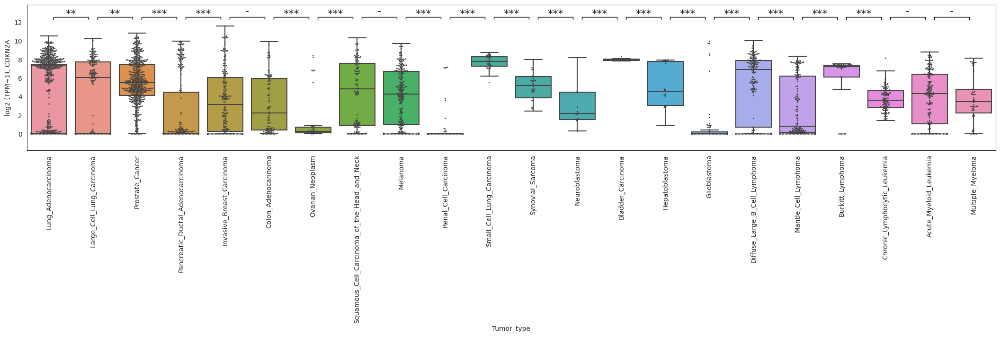

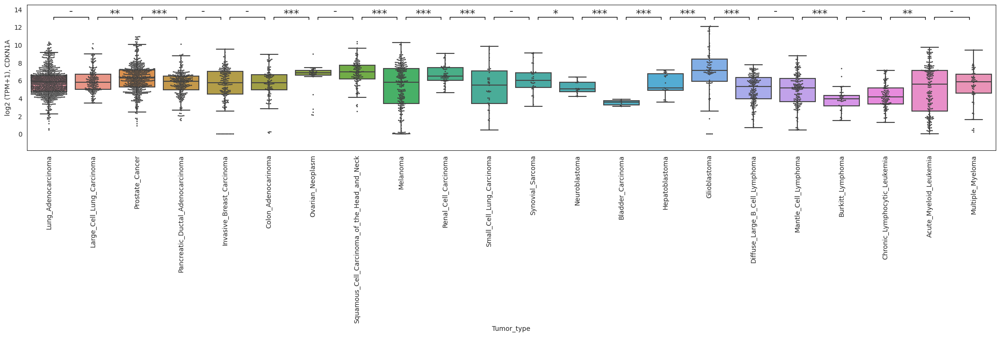

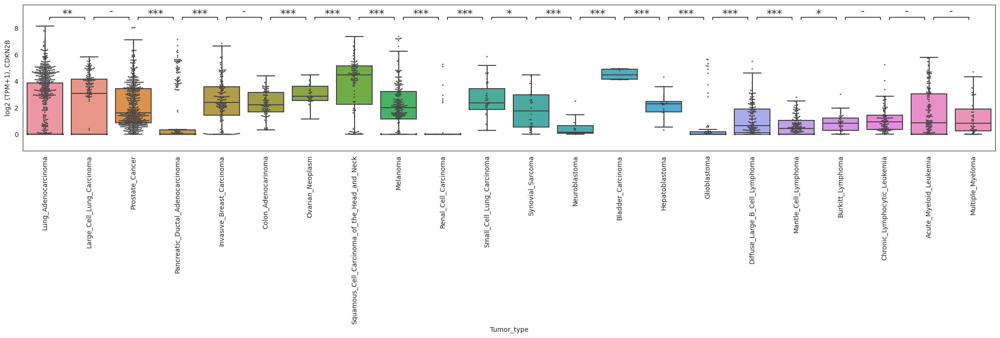

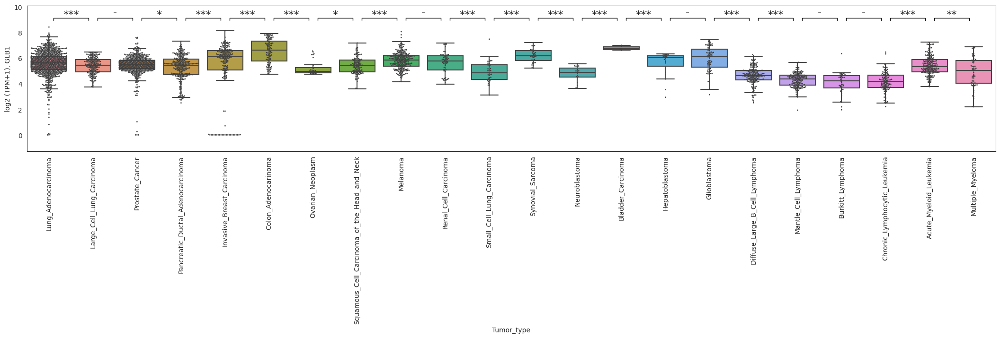

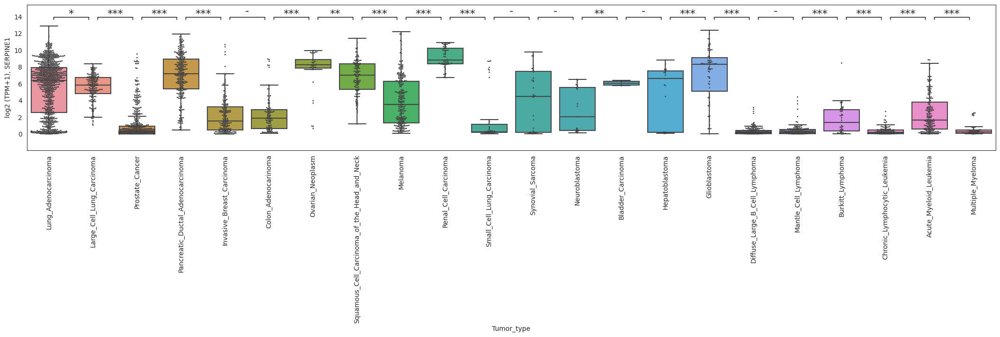

...

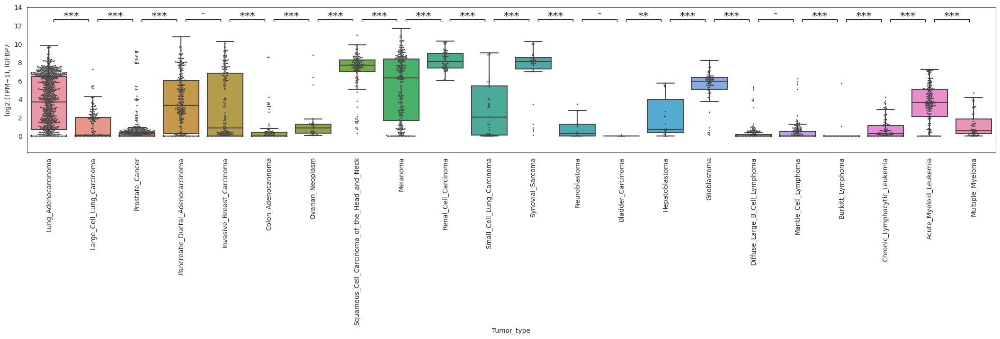

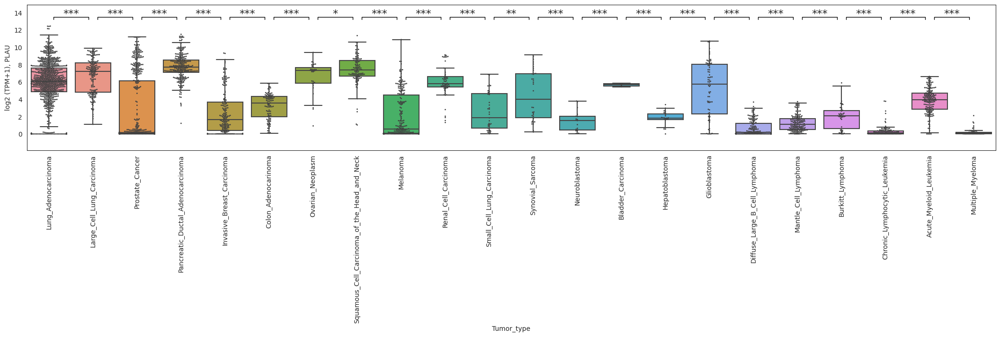

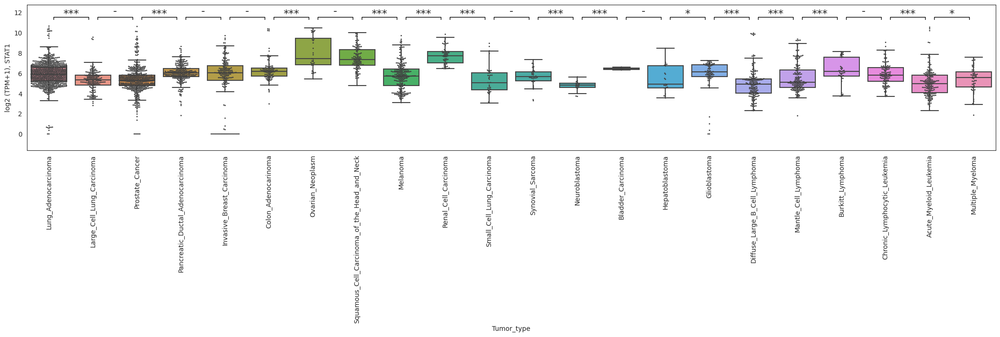

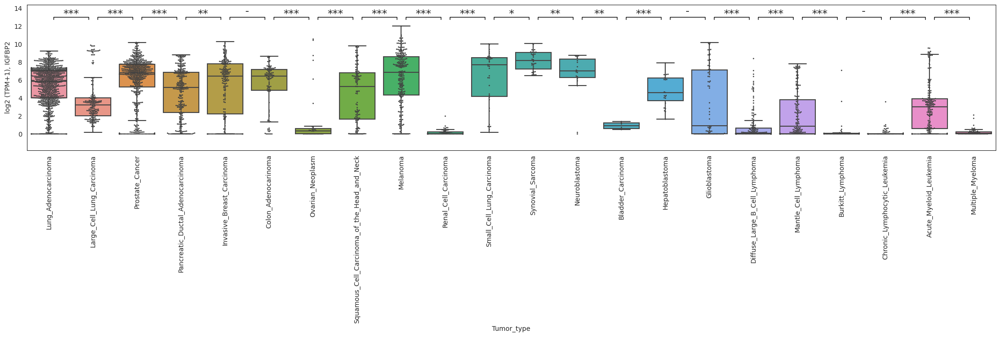

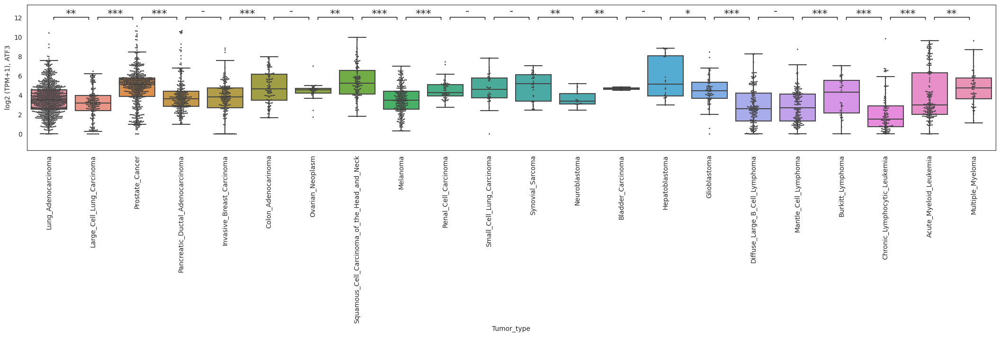

In [ ]:
# boxplots depicting signature genes expression in diagnoses of interest

categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Neuroblastoma",
    "Bladder_Carcinoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

for gene in signature_of_interest:
    boxplot_with_pvalue(
        cancer_cells_expr.loc[gene],
        annot[annot["Tumor_type"].isin(categories)]["Tumor_type"],
        order=categories,
        s=2,
    )
    plt.ylabel(f"log2 (TPM+1), {gene}")
    plt.xticks(rotation=90)
    plt.show()

In [ ]:
cancer_cells_ssgsea_unscaled = ssgsea_formula(
    cancer_cells_expr,
    gmt_genes_alt_names(geneset_of_interest, cancer_cells_expr.index, verbose=False),
).T

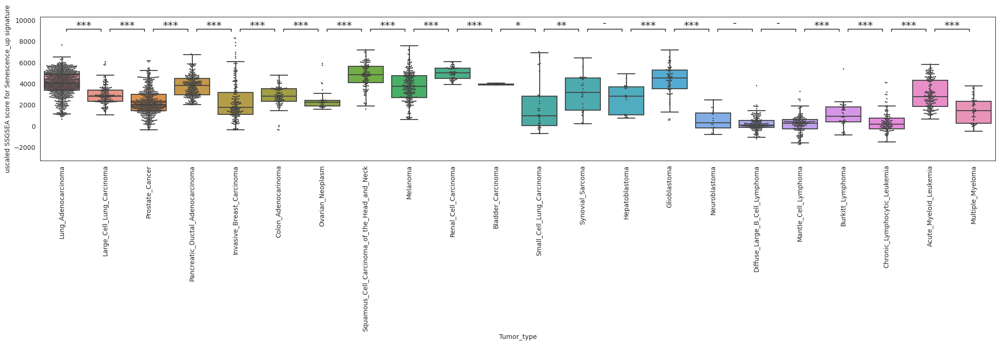

In [ ]:
# boxplot depicting signature SSGSEA score in celltypes of interest

categories = [
    "Lung_Adenocarcinoma",
    "Large_Cell_Lung_Carcinoma",
    "Prostate_Cancer",
    "Pancreatic_Ductal_Adenocarcinoma",
    "Invasive_Breast_Carcinoma",
    "Colon_Adenocarinoma",
    "Ovarian_Neoplasm",
    "Squamous_Cell_Carcinoma_of_the_Head_and_Neck",
    "Melanoma",
    "Renal_Cell_Carcinoma",
    "Bladder_Carcinoma",
    "Small_Cell_Lung_Carcinoma",
    "Synovial_Sarcoma",
    "Hepatoblastoma",
    "Glioblastoma",
    "Neuroblastoma",
    "Diffuse_Large_B_Cell_Lymphoma",
    "Mantle_Cell_Lymphoma",
    "Burkitt_Lymphoma",
    "Chronic_Lymphocytic_Leukemia",
    "Acute_Myeloid_Leukemia",
    "Multiple_Myeloma",
]

boxplot_with_pvalue(
    cancer_cells_ssgsea_unscaled[signature_name],
    annot[annot["Tumor_type"].isin(categories)]["Tumor_type"],
    order=categories,
    s=2,
)

plt.xticks(rotation=90)
plt.ylabel(f"uscaled SSGSEA score for {signature_name} signature")
plt.show()

# Signature validation: pancan data (TCGA)

In [ ]:
# list all cohorts with expressions available
os.listdir("/uftp/mvp-data/cohorts/")

['LUAD',
 'Meningioma',
 'KIRC',
 'TCGA-Oligodendroglioma',
 'PAAD',
 'MCL',
 'OV',
 'ALCL',
 'Leiomyosarcoma',
 'AITL',
 'LUSC',
 'TCGA-ESGA_AC',
 'MESO',
 'LIHC',
 'TCGA-COREAD',
 'PanSolid',
 'THCA',
 'TCGA-CESC_SCC',
 'Multiple_Myeloma',
 'SKCM',
 'TGCT',
 'TCGA-Glioblastoma',
 'CHOL',
 'KIRP',
 'AML',
 'Liposarcoma',
 'TCGA-HNE_SCC',
 'TCGA-BRCA_LumiNorm',
 'THYM_without_TC',
 'PTCL-NOS',
 'ACC',
 'Pancreatic_NET',
 'PTCL_LN',
 'TCGA-BRCA_Her2',
 'TCGA-BRCA_Basal',
 'CSCC-polyA',
 'DLBCL-polyA',
 'Esthesioneuroblastoma',
 'PanPTCL_LN',
 'FL',
 'KICH',
 'NKTCL',
 'UCEC',
 'TCGA-Astrocytoma',
 'SARC',
 'PTCL_blood',
 'no_cohort_solid',
 'no_cohort_hematological',
 'TCGA-CESC_AC',
 'PanHeme',
 'PRAD',
 'BLCA',
 'UCS',
 'no_cohort',
 'BG_NEC',
 'PCPG',
 'CTCL',
 'THYM',
 'BG_PanSolid',
 'UVM',
 'AdCC',
 'NPC',
 'FL-HCC',
 'BG_FL-HCC']

In [ ]:
# list all cohorts with counts available
os.listdir(
    "/uftp2/Datasets/Xena/TCGA/TCGA_Kallisto_genes_est_counts_without_noncoding/"
)

['remaining_est_counts_sum',
 'CHOL_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PAAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'UVM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THYM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'DLBC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ACC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'STAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'ESCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'CESC_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'COAD_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'MESO_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'KIRP_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'THCA_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'PCPG_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz',
 'SKCM_Kallisto-Xena_genes_est_counts_without_noncoding.tsv.gz'

In [ ]:
# here, we manually select cohorts having both expressions and counts available
cohorts = [
    "TCGA-Astrocytoma",
    "TCGA-BLCA",
    "TCGA-CESC_AC",
    "TCGA-CESC_SCC",
    "TCGA-CHOL",
    "TCGA-DLBC",
    "TCGA-HNE_SCC",
    "TCGA-KICH",
    "TCGA-LIHC",
    "TCGA-OV",
    "TCGA-PAAD",
    "TCGA-PCPG",
    "TCGA-SKCM",
    "TCGA-THCA",
    "TCGA-ACC",
    "TCGA-BRCA_Basal",
    "TCGA-BRCA_Her2",
    "TCGA-BRCA_LumiNorm",
    "TCGA-COREAD",
    "TCGA-ESGA_AC",
    "TCGA-Glioblastoma",
    "TCGA-KIRC",
    "TCGA-KIRP",
    "TCGA-LUAD",
    "TCGA-LUSC",
    "TCGA-MESO",
    "TCGA-Oligodendroglioma",
    "TCGA-PRAD",
    "TCGA-SARC",
    "TCGA-TGCT",
    "TCGA-THYM",
    "TCGA-UCEC",
    "TCGA-UCS",
    "TCGA-UVM",
]

In [ ]:
tcga_expressions = {}
tcga_ssgsea = {}
tcga_ssgsea_unscaled = {}

for cohort in cohorts:
    e = get_expression_table(cohort, log=True).T
    s = ssgsea_formula(
        e, gmt_genes_alt_names(geneset_of_interest, e.index, verbose=False)
    ).T
    tcga_expressions[cohort] = e
    tcga_ssgsea_unscaled[cohort] = s
    tcga_ssgsea[cohort] = median_scale(s)

In [ ]:
tcga_anno = read_dataset("/uftp2/Datasets/TCGA/current_version/data/annotation.tsv")
tcga_expressions = pd.concat(tcga_expressions.values(), axis=1)
tcga_ssgsea = pd.concat(tcga_ssgsea.values())
tcga_ssgsea_unscaled = pd.concat(tcga_ssgsea_unscaled.values())

In [ ]:
from mldeconv.prediction import predict

In [ ]:
with open(
    "/uftp/Deconvolution/product/models/configs/product/model_v1_tumor.yaml", "r"
) as f:
    pred_config = yaml.load(f, Loader=yaml.FullLoader)
tcga_deconv = predict(2 ** (tcga_expressions) - 1, pred_config)
tcga_deconv

2024-06-10 17:15:01.538 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function load took 2.8329 seconds.
2024-06-10 17:15:14.746 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict_l1 took 11.6522 seconds.
2024-06-10 17:15:14.749 | INFO     | mldeconv.cells_utils:timeit_wrapper:676 - Function predict took 13.2109 seconds.


,TCGA-P5-A733-01,TCGA-HT-7601-01,TCGA-WY-A85D-01,TCGA-HT-A618-01,TCGA-DU-6408-01,TCGA-FG-5965-02,TCGA-DU-7306-01,TCGA-DU-6396-01,TCGA-DU-8166-01,TCGA-TQ-A8XE-02,...,TCGA-V4-A9EO-01,TCGA-V4-A9EL-01,TCGA-V4-A9F1-01,TCGA-VD-A8KA-01,TCGA-V4-A9F7-01,TCGA-VD-AA8P-01,TCGA-V4-A9F8-01,TCGA-VD-AA8N-01,TCGA-V4-A9EM-01,TCGA-WC-A87W-01
B_cells,0.036262,0.025204,0.034615,0.025572,0.051125,0.000000,0.044840,0.036465,0.042781,0.000897,...,0.004037,0.048547,0.006727,0.023850,0.005909,0.018844,0.007226,0.041932,0.000969,0.018935
CD4_T_cells,0.003926,0.018993,0.005593,0.007058,0.011974,0.013104,0.006393,0.007030,0.009430,0.009092,...,0.008960,0.000000,0.007857,0.010348,0.008815,0.005920,0.002393,0.030133,0.006065,0.017991
CD8_T_cells,0.004453,0.000000,0.000000,0.000462,0.002604,0.007333,0.001709,0.006053,0.002820,0.000574,...,0.006188,0.120110,0.004490,0.002459,0.002581,0.005057,0.009473,0.033358,0.004739,0.005232
CD8_T_cells_PD1_high,0.001608,0.000000,0.000000,0.000187,0.001071,0.005175,0.000641,0.000000,0.000839,0.000388,...,0.001718,0.059013,0.001763,0.000183,0.000928,0.001442,0.002214,0.009727,0.002134,0.001540
CD8_T_cells_PD1_low,0.002845,0.000000,0.000000,0.000274,0.001533,0.002159,0.001068,0.006053,0.001981,0.000186,...,0.004470,0.061097,0.002727,0.002276,0.001653,0.003615,0.007260,0.023631,0.002605,0.003693
Central_memory_T_helpers,0.000000,0.000000,0.000023,0.000112,0.001405,0.000000,0.001669,0.000820,0.002354,0.001527,...,0.004520,0.000000,0.003792,0.004898,0.001884,0.002596,0.001035,0.010451,0.002358,0.003695
Class_switched_memory_B_cells,0.010286,0.008829,0.000000,0.000000,0.002088,0.000000,0.022257,0.014881,0.007084,0.000352,...,0.000000,0.000000,0.000000,0.007608,0.001184,0.000590,0.000293,0.011756,0.000386,0.000000
Conventional_T_cells,0.005829,0.005647,0.006023,0.007453,0.005210,0.004835,0.006380,0.003645,0.004005,0.005013,...,0.002319,0.009164,0.000580,0.003291,0.002571,0.002295,0.003096,0.006834,0.004997,0.003821
Cytotoxic_NK_cells,0.019466,0.012401,0.020871,0.015112,0.008917,0.010747,0.017017,0.006000,0.006623,0.007636,...,0.001254,0.014693,0.001308,0.002372,0.002251,0.009200,0.009107,0.002010,0.006169,0.005685
Effector_memory_T_helpers,0.003329,0.003069,0.005570,0.003207,0.004637,0.002189,0.003101,0.000401,0.004239,0.003055,...,0.000565,0.000000,0.001067,0.001556,0.001391,0.001680,0.000546,0.002153,0.001731,0.001516


### Check if all genes in signatures are expressed (in progress!)

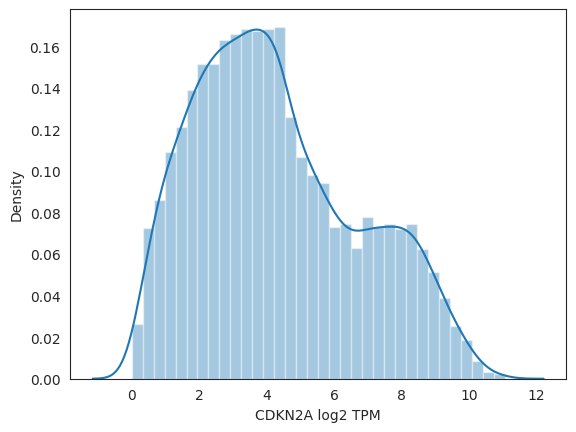

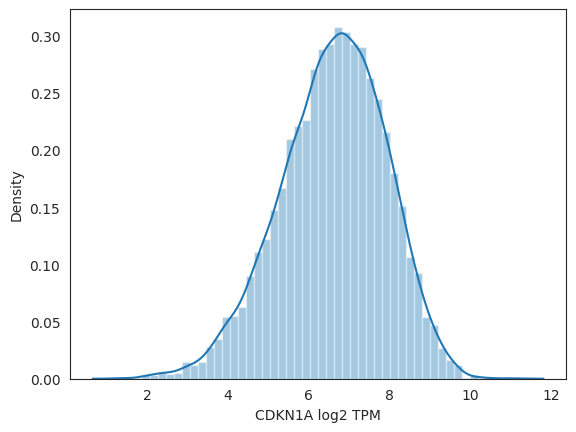

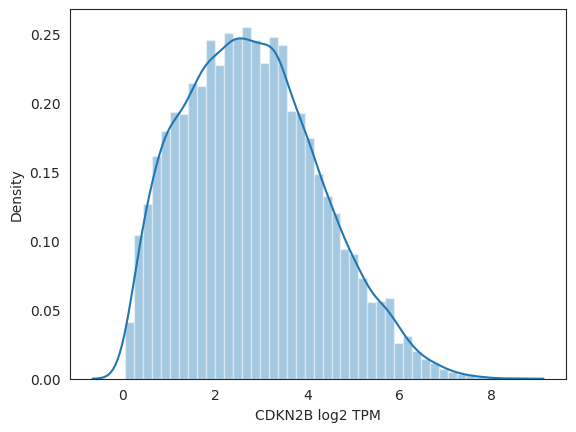

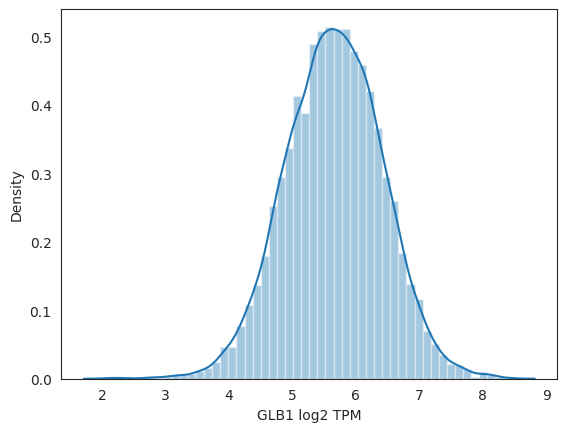

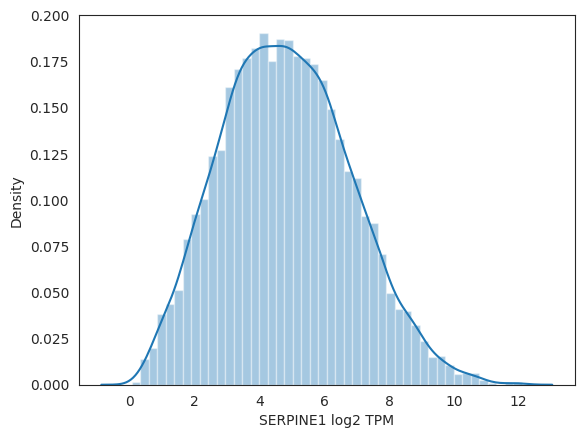

...

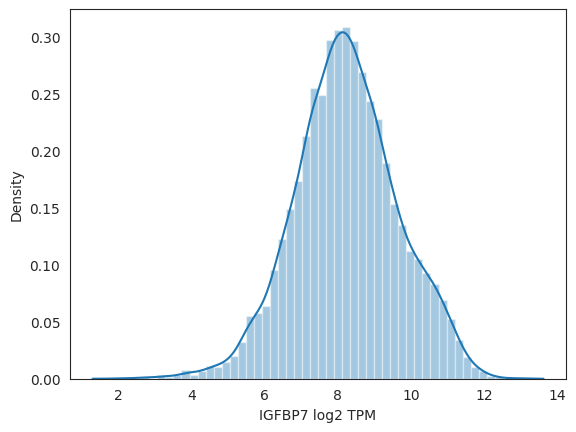

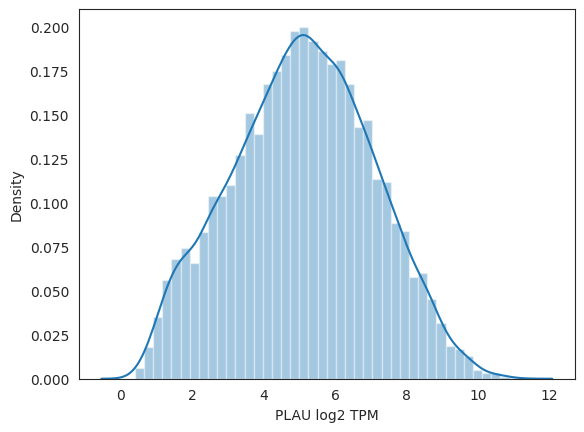

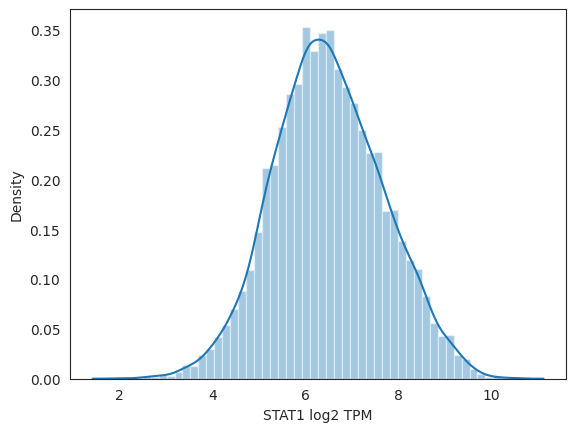

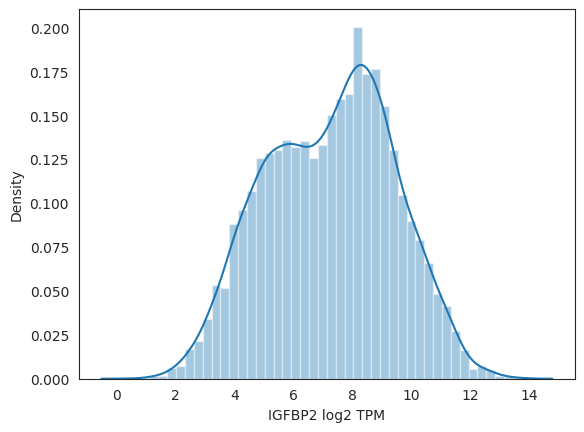

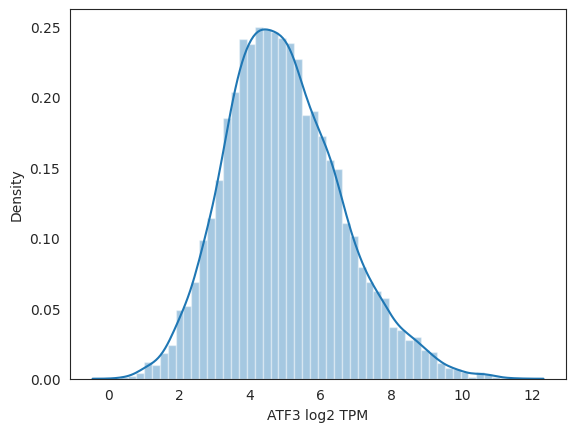

In [ ]:
for gene in signature_of_interest:
    sns.distplot(tcga_expressions.loc[gene])
    plt.xlabel(f"{gene} log2 TPM")
    plt.show()

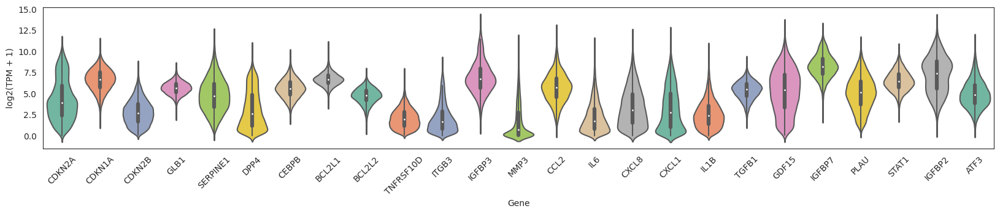

In [ ]:
df = tcga_expressions.loc[signature_of_interest]
data = pd.melt(df.T)
data["KDE"] = "Gene"

plt.figure(figsize=(20, 3))
sns.violinplot(
    x="Gene",
    y="value",
    data=pd.concat([data]),
    palette="Set2",
    split=True,
    scale="count",
    inner="box",
)

plt.ylabel("log2(TPM + 1)")
plt.xticks(rotation=45)
plt.show()

In [ ]:
gmt = read_dataset("genesets_msigdb_senescence.gmt")
gmt = {
    j.name: GeneSet(j.name, j.link, set(j[1:].dropna().values))
    for i, j in gmt.iterrows()
}

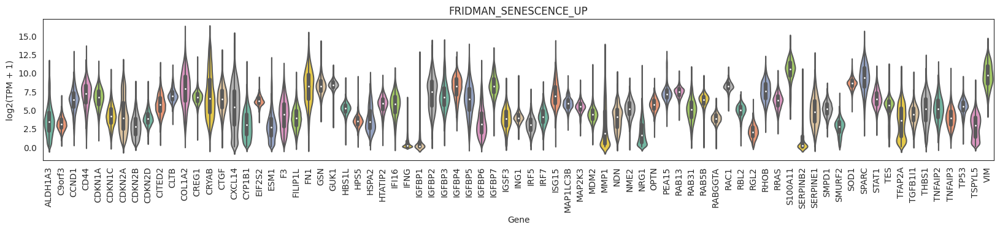

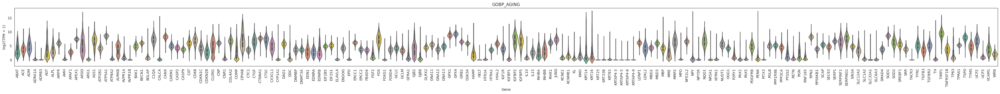

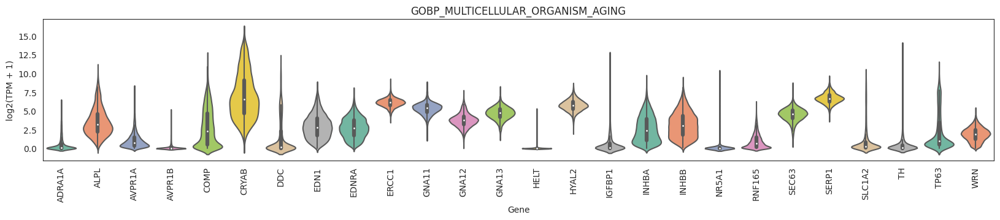

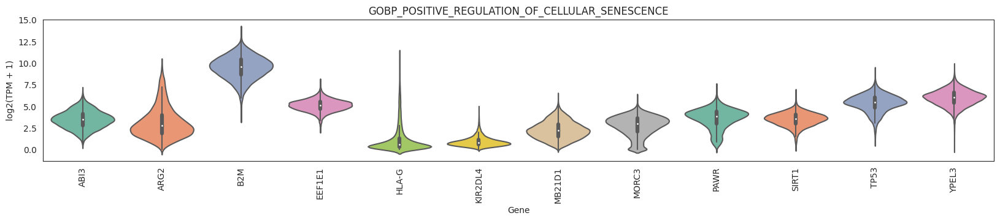

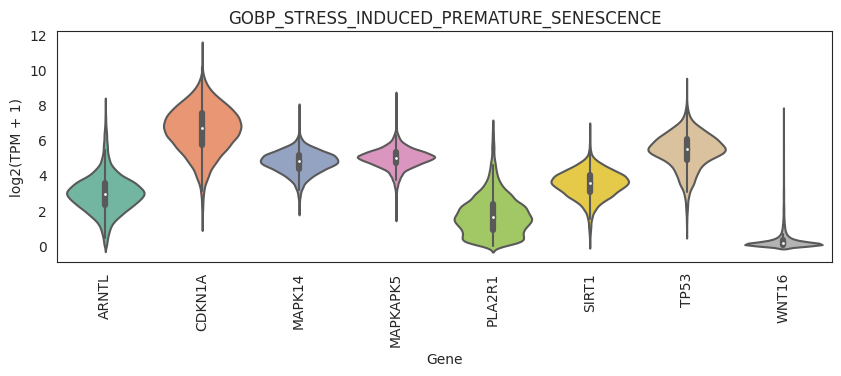

...

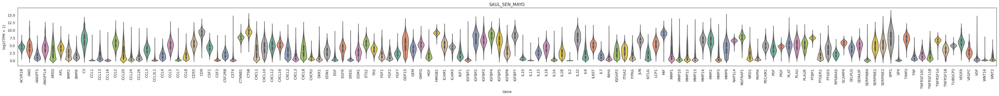

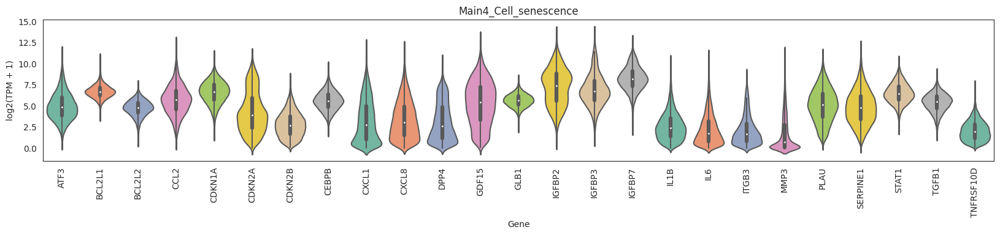

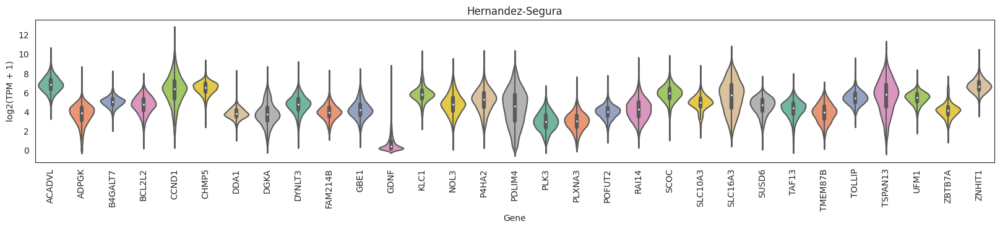

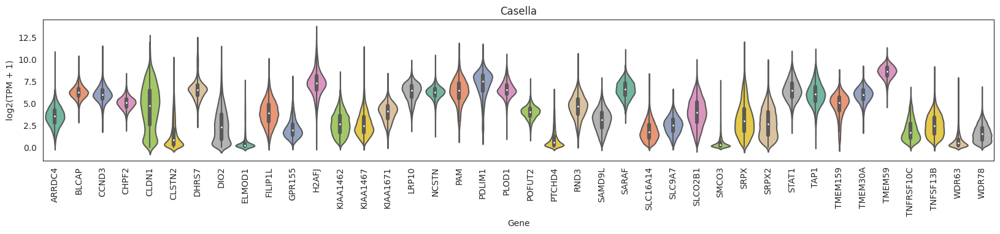

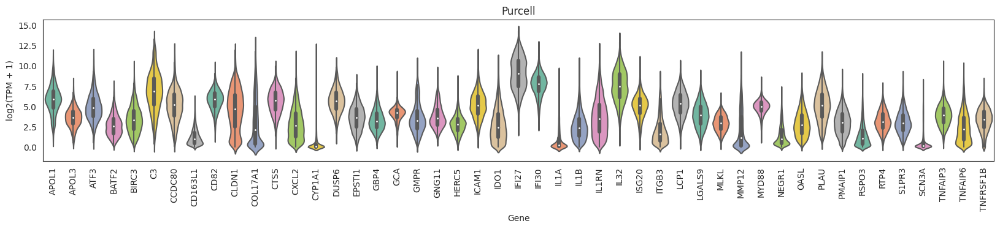

In [ ]:
for i in gmt.keys():
    df = tcga_expressions.loc[
        np.intersect1d(
            list(update_gene_names(gmt[i].genes, tcga_expressions.index).values()),
            tcga_expressions.index,
        )
    ]
    data = pd.melt(df.T)
    data["KDE"] = "Gene"
    if len(gmt[i].genes) <= 10:
        w = 10
    elif len(gmt[i].genes) <= 100:
        w = 20
    else:
        w = 50
    plt.figure(figsize=(w, 3))
    sns.violinplot(
        x="Gene",
        y="value",
        data=pd.concat([data]),
        palette="Set2",
        split=True,
        scale="count",
        inner="box",
    )
    plt.title(i)
    plt.ylabel("log2(TPM + 1)")
    plt.xticks(rotation=90, fontsize=10)
    plt.rcParams["svg.fonttype"] = "none"
    # plt.savefig(f"/uftp/users/msavchenko/figures/Senescence_violin_{i}.svg", format="svg")
    plt.show()

### Check if there are anticorrelating genes

Figure 5A

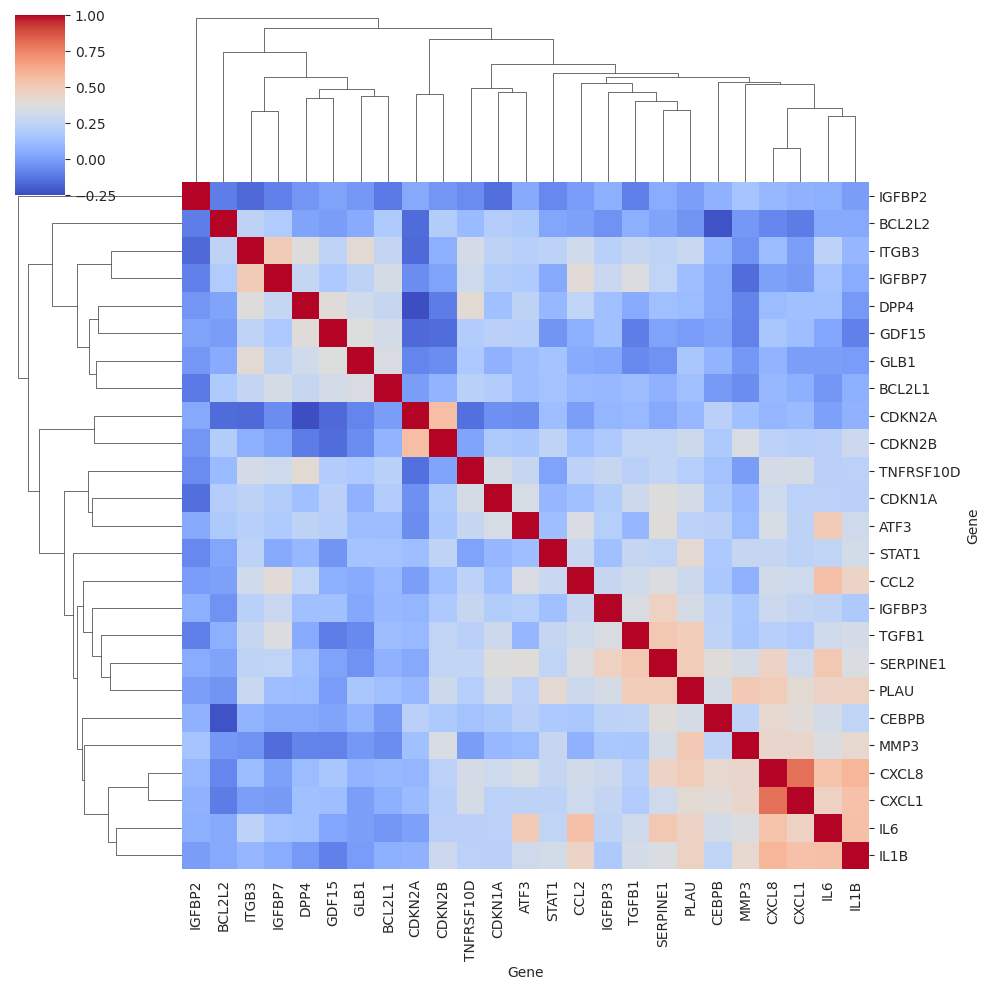

In [ ]:
sns.clustermap(
    tcga_expressions.T[signature_of_interest].corr(method="spearman"),
    figsize=(10, 10),
    cmap=default_cmap,
    annot=False,
    annot_kws={"fontsize": 10},
    vmin=-0.25,
    vmax=1,
)
# plt.title(signature_name, loc='center')
plt.rcParams["svg.fonttype"] = "none"
plt.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signature_correlation_clustermap_PanCan.svg",
    format="svg",
)
plt.show()

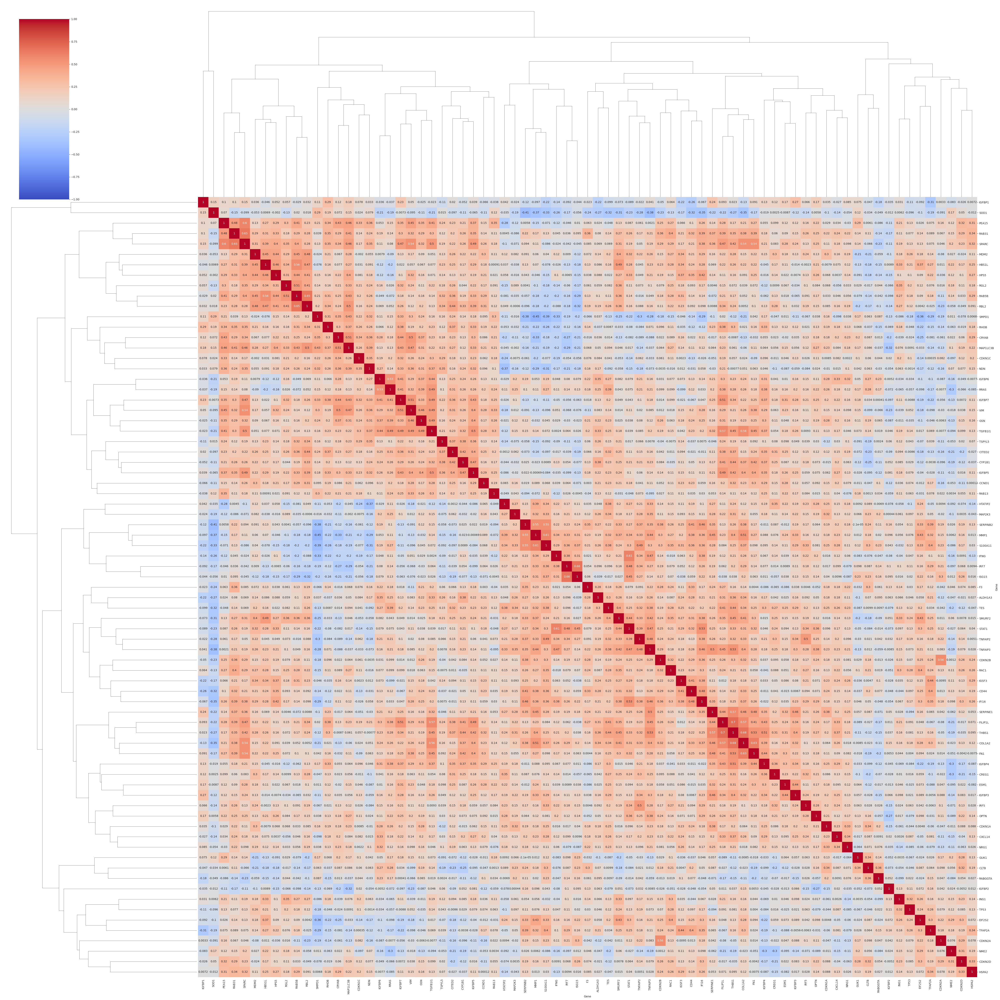

In [ ]:
# Fridman signature
sns.clustermap(
    tcga_expressions.T[
        """ALDH1A3	CCND1	CD44	CDKN1A	CDKN1C	CDKN2A	CDKN2B	CDKN2D	CITED2	CLTB	COL1A2	CREG1	CRYAB	CXCL14	CYP1B1	EIF2S2	ESM1	F3	FILIP1L	FN1	GSN	GUK1	HBS1L	HPS5	HSPA2	HTATIP2	IFI16	IFNG	IGFBP1	IGFBP2	IGFBP3	IGFBP4	IGFBP5	IGFBP6	IGFBP7	IGSF3	ING1	IRF5	IRF7	ISG15	MAP1LC3B	MAP2K3	MDM2	MMP1	NDN	NME2	NRG1	OPTN	PEA15	RAB13	RAB31	RAB5B	RABGGTA	RAC1	RBL2	RGL2	RHOB	RRAS	S100A11	SERPINB2	SERPINE1	SMPD1	SMURF2	SOD1	SPARC	STAT1	TES	TFAP2A	TGFB1I1	THBS1	TNFAIP2	TNFAIP3	TP53	TSPYL5	VIM""".split(
            "\t"
        )
    ].corr(method="spearman"),
    figsize=(50, 50),
    cmap=default_cmap,
    annot=True,
    annot_kws={"fontsize": 10},
    vmin=-1,
    vmax=1,
)
plt.show()

### Correlation with other senescence signatures

In [ ]:
PROCESSES_LIST = []
manual_genesets = {
    "Hernandez-Segura_Up": {
        "ACADVL",
        "ADPGK",
        "B4GALT7",
        "BCL2L2",
        "CCND1",
        "CHMP5",
        "DDA1",
        "DGKA",
        "DYNLT3",
        "FAM214B",
        "GBE1",
        "GDNF",
        "KLC1",
        "MT-CYB",
        "NOL3",
        "P4HA2",
        "PDLIM4",
        "PLK3",
        "PLXNA3",
        "POFUT2",
        "RAI14",
        "SCOC",
        "SLC10A3",
        "SLC16A3",
        "SUSD6",
        "TAF13",
        "TMEM87B",
        "TOLLIP",
        "TSPAN13",
        "UFM1",
        "ZBTB7A",
        "ZNHIT1",
    },
    "Hernandez-Segura_Down": {
        "ARHGAP35",
        "ARID2",
        "ASCC1",
        "C2CD5",
        "CNTLN",
        "CREBBP",
        "EFNB3",
        "GSTM4",
        "ICE1",
        "KCTD3",
        "MEIS1",
        "NFIA",
        "PATZ1",
        "PCIF1",
        "PDS5B",
        "RHNO1",
        "SMO",
        "SPATA6",
        "SPIN4",
        "STAG1",
        "TRDMT1",
        "USP6NL",
        "ZC3H4",
    },
    "Casella_Up": {
        "ARRDC4",
        "BLCAP",
        "CCND3",
        "CHPF2",
        "CLDN1",
        "CLSTN2",
        "DHRS7",
        "DIO2",
        "ELMOD1",
        "FAM234B",
        "FILIP1L",
        "GPR155",
        "H2AFJ",
        "JCAD",
        "KIAA1671",
        "LRP10",
        "NCSTN",
        "PAM",
        "PDLIM1",
        "PLOD1",
        "POFUT2",
        "PTCHD4",
        "RND3",
        "SAMD9L",
        "SARAF",
        "SLC16A14",
        "SLC9A7",
        "SLCO2B1",
        "SMCO3",
        "SRPX",
        "SRPX2",
        "STAT1",
        "TAP1",
        "TMEM159",
        "TMEM30A",
        "TMEM59",
        "TNFRSF10C",
        "TNFSF13B",
        "WDR63",
        "WDR78",
    },
    "Casella_Down": {
        "ANP32B",
        "CBS",
        "CBX2",
        "CDCA7L",
        "FAM129A",
        "FBL",
        "HIST1H1A",
        "HIST1H1D",
        "HIST1H1E",
        "HIST2H2AB",
        "ITPRIPL1",
        "LBR",
        "MCUB",
        "PARP1",
        "PTMA",
        "SSRP1",
        "TMSB15A",
    },
    "Fridman_Up": {
        "ALDH1A3",
        "AOPEP",
        "CTGF",
        "CCND1",
        "CD44",
        "CDKN1A",
        "CDKN1C",
        "CDKN2A",
        "CDKN2B",
        "CDKN2D",
        "CITED2",
        "CLTB",
        "COL1A2",
        "CREG1",
        "CRYAB",
        "CXCL14",
        "CYP1B1",
        "EIF2S2",
        "ESM1",
        "F3",
        "FILIP1L",
        "FN1",
        "GSN",
        "GUK1",
        "HBS1L",
        "HPS5",
        "HSPA2",
        "HTATIP2",
        "IFI16",
        "IFNG",
        "IGFBP1",
        "IGFBP2",
        "IGFBP3",
        "IGFBP4",
        "IGFBP5",
        "IGFBP6",
        "IGFBP7",
        "IGSF3",
        "ING1",
        "IRF5",
        "IRF7",
        "ISG15",
        "MAP1LC3B",
        "MAP2K3",
        "MDM2",
        "MMP1",
        "NDN",
        "NME2",
        "NRG1",
        "OPTN",
        "PEA15",
        "RAB13",
        "RAB31",
        "RAB5B",
        "RABGGTA",
        "RAC1",
        "RBL2",
        "RGL2",
        "RHOB",
        "RRAS",
        "S100A11",
        "SERPINB2",
        "SERPINE1",
        "SMPD1",
        "SMURF2",
        "SOD1",
        "SPARC",
        "STAT1",
        "TES",
        "TFAP2A",
        "TGFB1I1",
        "THBS1",
        "TNFAIP2",
        "TNFAIP3",
        "TP53",
        "TSPYL5",
        "VIM",
    },
    "Fridman_Down": {
        "ALDH1A1",
        "BMI1",
        "CCN4",
        "CCNB1",
        "CDC25B",
        "CKS1BP7",
        "COL3A1",
        "E2F4",
        "EGR1",
        "ID1",
        "LAMA1",
        "LDB2",
        "MARCKS",
    },
    "Purcell_Up": {
        "APOL1",
        "GBP4",
        "COL17A1",
        "GNG11",
        "BIRC3",
        "CTSS",
        "EPSTI1",
        "S1PR3",
        "PMAIP1",
        "TNFAIP3",
        "APOL3",
        "DUSP6",
        "LCP1",
        "ATF3",
        "RSPO3",
        "IDO1",
        "LGALS9",
        "CD163L1",
        "MLKL",
        "MYD88",
        "BATF2",
        "OASL",
        "RTP4",
        "C3",
        "ISG20",
        "CXCL2",
        "ICAM1",
        "IFI27",
        "IL1B",
        "GCA",
        "IL32",
        "IL1A",
        "CD82",
        "MMP12",
        "IL1RN",
        "HERC5",
        "TNFAIP6",
        "TNFRSF1B",
        "PLAU",
        "IFI30",
        "CLDN1",
        "CCDC80",
        "NEGR1",
        "ODZ2",
        "GMPR",
        "ITGB3",
        "SCN3A",
        "CYP1A1",
    },
    "Senescence_Up": {
        "CDKN2A",
        "CDKN1A",
        "CDKN2B",
        "GLB1",
        "SERPINE1",
        "DPP4",
        "CEBPB",
        "BCL2L1",
        "BCL2L2",
        "TNFRSF10D",
        "ITGB3",
        "IGFBP3",
        "MMP3",
        "CCL2",
        "IL6",
        "CXCL8",
        "CXCL1",
        "IL1B",
        "TGFB1",
        "GDF15",
        "IGFBP7",
        "PLAU",
        "STAT1",
        "IGFBP2",
        "ATF3",
    },
    "Senescence_Down": {
        "LMNB1",
        "CCNA2",
        "CCNB1",
        "CCNB2",
        "EZH2",
        "BMI1",
        "SIRT1",
        "FOXM1",
        "TWIST1",
        "AURKA",
        "AURKB",
        "DNMT1",
        "NFE2L2",
        "ID1",
        "HNRNPD",
    },
}
if manual_genesets:
    gmt_manual = {k: GeneSet(k, "", set(v)) for k, v in manual_genesets.items()}
else:
    gmt_manual = dict()
if PROCESSES_LIST:
    gmt_chess = {k: gmt[k] for k in PROCESSES_LIST}
else:
    gmt_chess = dict()

gmt_final = {**gmt_manual, **gmt_chess}

for process in gmt_final:
    print(process + ":", *gmt_final[process].genes)

Hernandez-Segura_Up: NOL3 B4GALT7 DDA1 DYNLT3 UFM1 RAI14 ZBTB7A SLC10A3 ADPGK P4HA2 TAF13 SUSD6 CCND1 CHMP5 ZNHIT1 POFUT2 TOLLIP KLC1 TMEM87B SLC16A3 GBE1 TSPAN13 MT-CYB PLXNA3 PLK3 BCL2L2 SCOC GDNF DGKA PDLIM4 ACADVL FAM214B
Hernandez-Segura_Down: C2CD5 NFIA ASCC1 USP6NL PCIF1 PDS5B SPATA6 RHNO1 ICE1 STAG1 EFNB3 GSTM4 SPIN4 KCTD3 CNTLN CREBBP TRDMT1 MEIS1 PATZ1 ZC3H4 ARHGAP35 ARID2 SMO
Casella_Up: PTCHD4 RND3 SRPX2 NCSTN PAM CLDN1 ELMOD1 DHRS7 WDR63 CLSTN2 WDR78 JCAD LRP10 PLOD1 CCND3 DIO2 ARRDC4 POFUT2 KIAA1671 TAP1 SAMD9L PDLIM1 SLC9A7 TMEM159 H2AFJ TMEM59 CHPF2 STAT1 SARAF SLC16A14 FAM234B TMEM30A SMCO3 TNFRSF10C BLCAP TNFSF13B SRPX FILIP1L SLCO2B1 GPR155
Casella_Down: TMSB15A CBS ITPRIPL1 MCUB CDCA7L PARP1 CBX2 HIST1H1E PTMA FAM129A FBL ANP32B LBR HIST1H1D HIST1H1A SSRP1 HIST2H2AB
Fridman_Up: GUK1 SOD1 RABGGTA COL1A2 ISG15 SERPINE1 IGFBP3 CDKN1C EIF2S2 CREG1 RHOB CTGF TP53 CITED2 RAB13 F3 HBS1L NDN IGFBP6 S100A11 RBL2 CLTB SPARC HPS5 HTATIP2 TNFAIP2 GSN SERPINB2 MDM2 RAB5B IGFBP1 

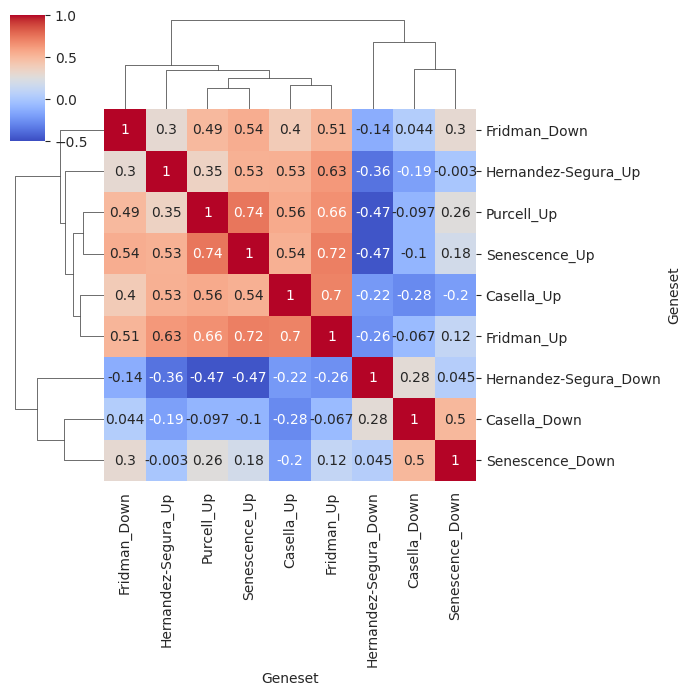

In [ ]:
df = ssgsea_formula(tcga_expressions, gmt_final)
# median scale added
df = median_scale(df.T).T
df.index.name = "Geneset"

clustered_heatmap(df, metric="spearman", vmin=-0.5, vmax=1, figsize=(7, 7))
plt.show()

# df_ranks = pd.concat(list(get_ranks(df)), axis=1).T
# order = df_ranks.sum().sort_values(ascending=False).index
# df_ranks = df_ranks.reindex(order, axis=1)

# _, ax = plt.subplots(figsize=(15,7))
# go = get_hclust_order(df_ranks, metric='spearman')
# sns.heatmap(
#    df_ranks.reindex(go),
#    cbar=False, cmap='coolwarm', xticklabels=False, ax=ax
# )
# plt.show()

### Check if this signature overlaps/correlates with existing signatures from Chess DB

#### Load signatures from CHESS DB, uftp data

In [ ]:
paths = sorted(
    Path("/uftp/shared/signature_database/chess_gmt_vers/").iterdir(),
    key=os.path.getmtime,
)
paths

[PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2022-11-11.09:08.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2022-11-23.01:36.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_blood_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_solid_2022-11-23.01:36.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_blood_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_portrait_solid_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2023-01-19.04:37.gmt'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2023-01-19.04:37.tsv'),
 PosixPath('/uftp/shared/signature_database/chess_gmt_vers/gmt_all_cytokines_2023-03-14

In [ ]:
gmt = read_dataset(
    "/uftp/shared/signature_database/chess_gmt_vers/gmt_all_validated_2023-11-29.08:41.tsv",
    index_col=1,
)
gmt = {j.name: GeneSet(j.name, "", set(j.dropna().values)) for i, j in gmt.iterrows()}

#### Correlations

In [ ]:
print("Checking for overlaps with CHESS signatures...")
for sig_name, sig in gmt.items():
    if len(sig.genes) > 0:
        common_genes = set(signature_of_interest).intersection(set(sig.genes))
        if (
            len(common_genes) / len(signature_of_interest) > 0.75
            or len(common_genes) / len(sig.genes) > 0.75
        ):
            print(f"Your signature looks alike to {sig_name}:")
print("Done")

Checking for overlaps with CHESS signatures...
Your signature looks alike to Main4_Cell_senescence:
Done


In [ ]:
print("Checking for correlation with CHESS signatures...")
solid_pancan = ssgsea_formula(
    tcga_expressions, gmt_genes_alt_names(gmt, tcga_expressions.index, verbose=False)
).T
solid_pancan.corrwith(tcga_ssgsea_unscaled[signature_name]).sort_values().dropna().tail(
    20
)

Checking for correlation with CHESS signatures...


Main4_Suppressive_factors_DLBCL              0.671827
Main4_Pro-inflammatory_cytokines_ccRCC       0.674006
Main4_Matrix_remodeling                      0.714932
Main4_Nph_recruitment_activation_SOLID       0.731848
Main4_Pro-inflammatory_cytokines_FL          0.739823
Main4_Nph_recruitment_activation_ccRCC       0.756278
Main4_Myeloid_cells_recruitment_DLBCL        0.762894
Main4_Protumor_chemokines                    0.764599
Main4_Pro-inflammatory_cytokines_DLBCL       0.764898
Main4_Granulocyte_traffic                    0.767702
Main4_Granulocyte_traffic_Blood              0.767702
Main4_Cancer-promoting_inflammation_DLBCL    0.778792
Main4_Pro-inflammatory_cytokines_SOLID       0.787608
Main4_Metastasis_induction_SOLID             0.799680
Main4_Myeloid_cells_recruitment_FL           0.801638
Main4_Metastasis_promotion_SOLID             0.802971
Main4_Metastasis_induction_ccRCC             0.803316
Main4_MDSC_recruitment_ccRCC                 0.813724
Main4_Induction_of_EMT_SOLID

### Survival

In [243]:
survival = prepare_survival_annotation(tcga_anno.OS, tcga_anno.OS_FLAG)

ACC


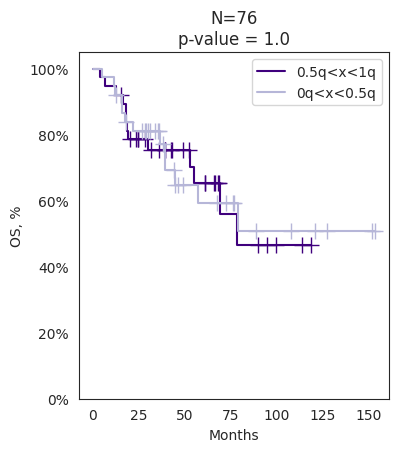

BLCA


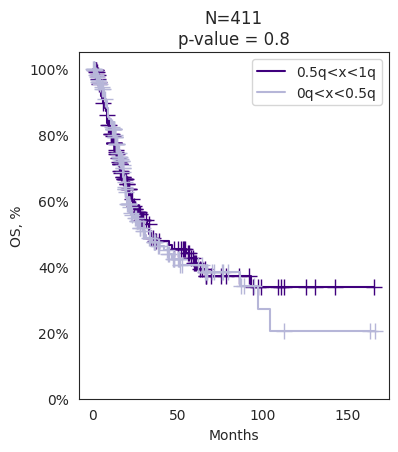

BRCA


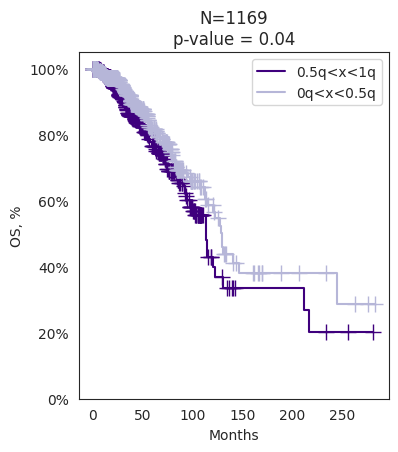

CESC


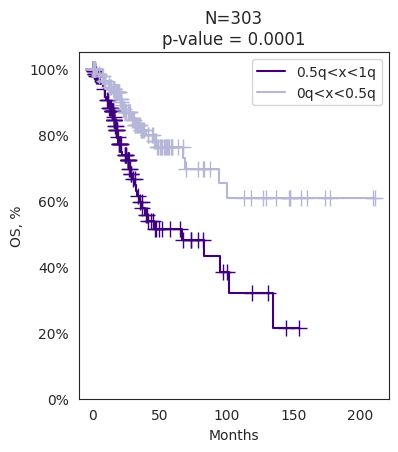

CHOL


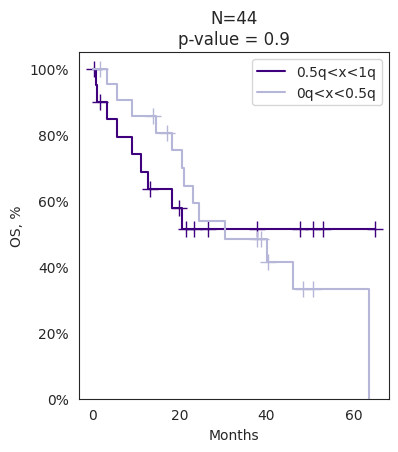

COAD


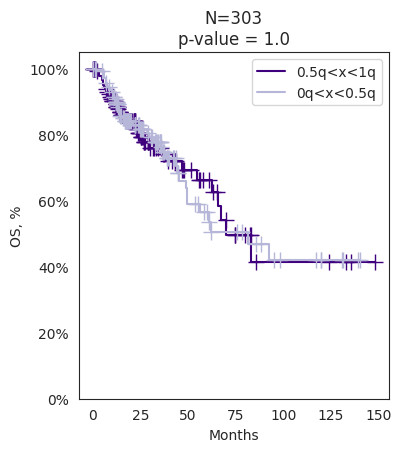

DLBC


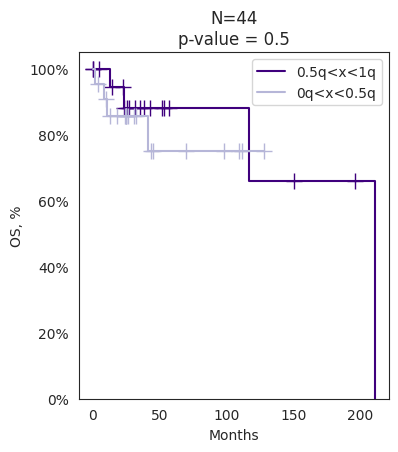

ESCA


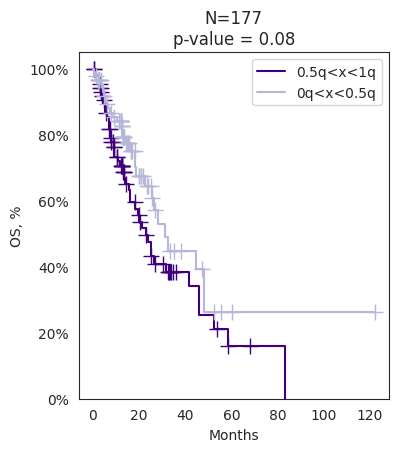

GBM


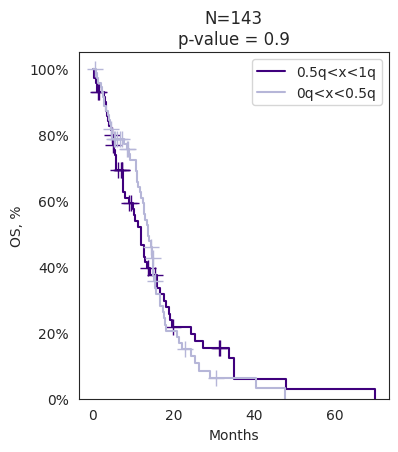

HNSC


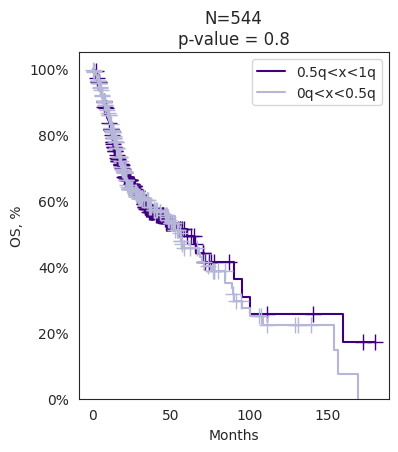

KICH


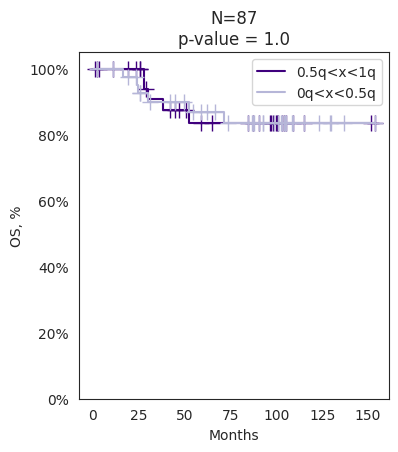

KIRC


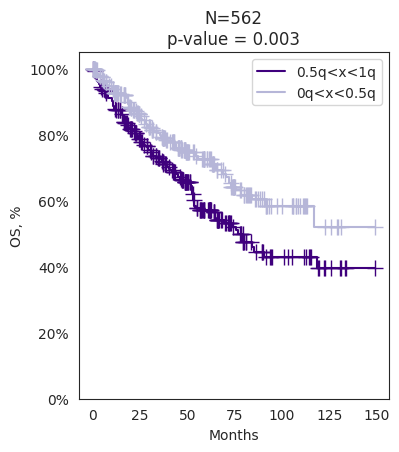

KIRP


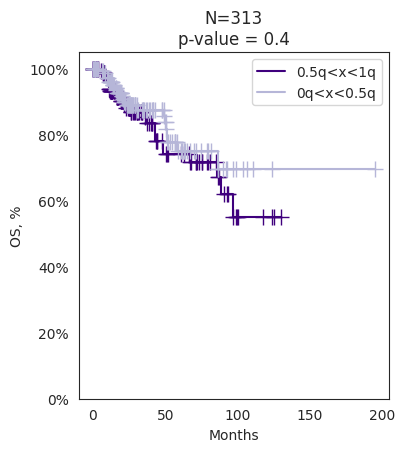

LAML


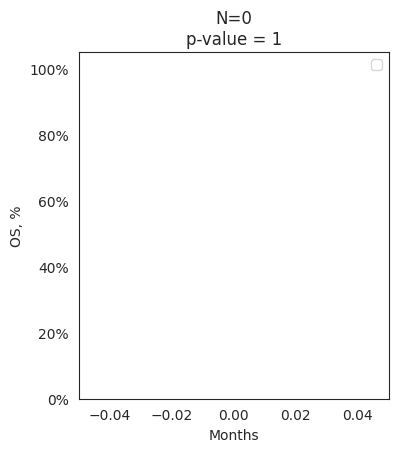

LGG


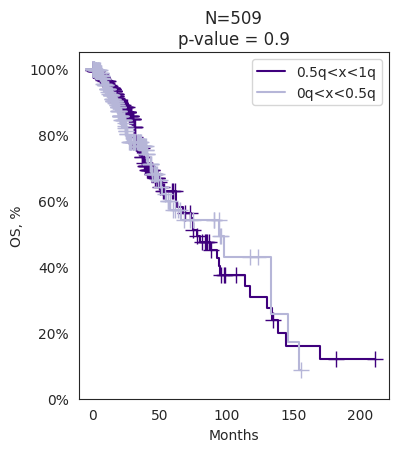

LIHC


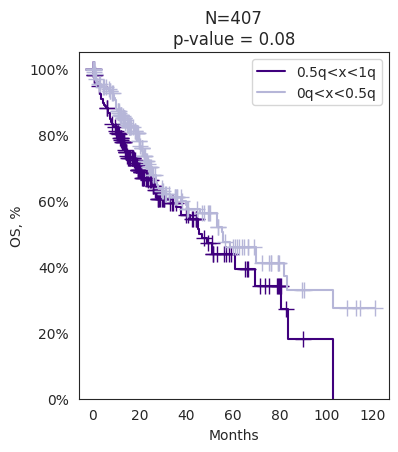

LUAD


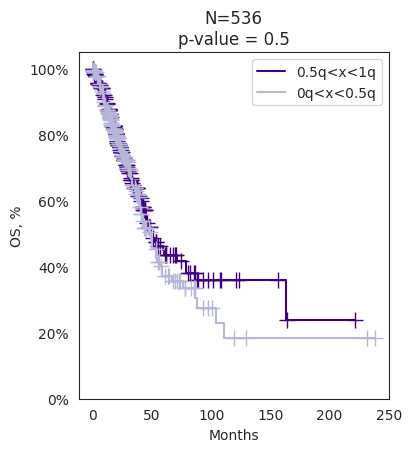

LUSC


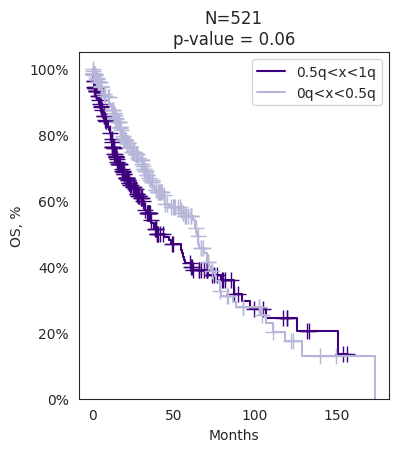

MESO


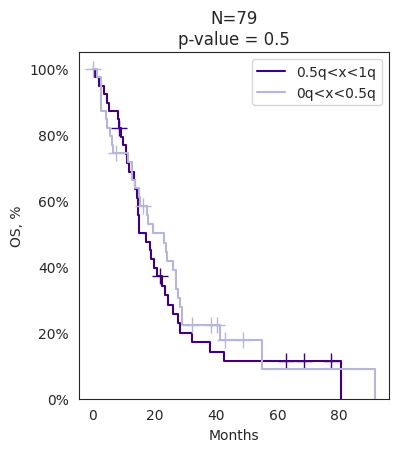

OV


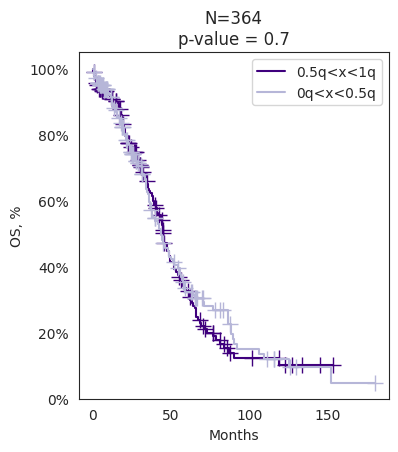

PAAD


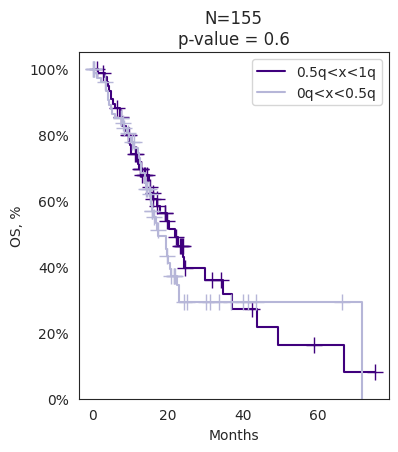

PCPG


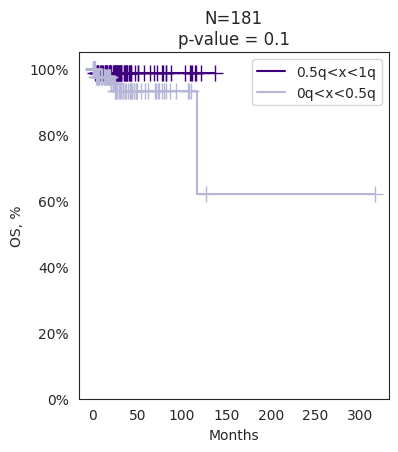

PRAD


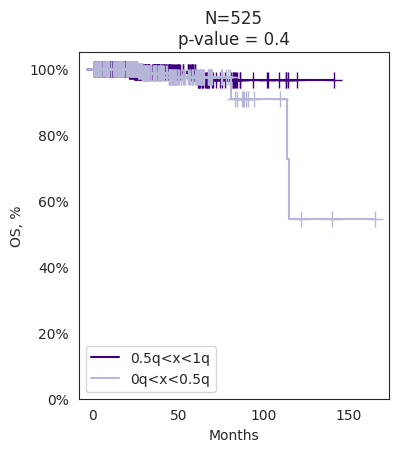

READ


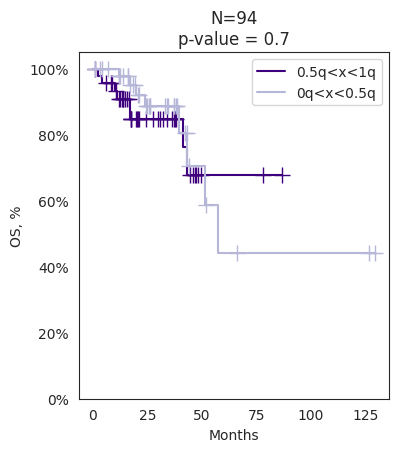

SARC


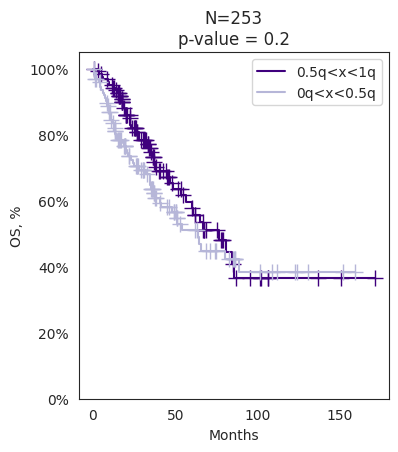

SKCM


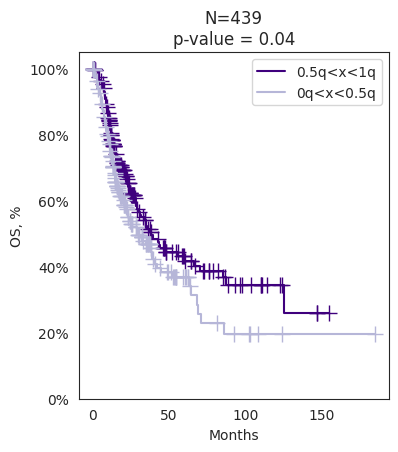

STAD


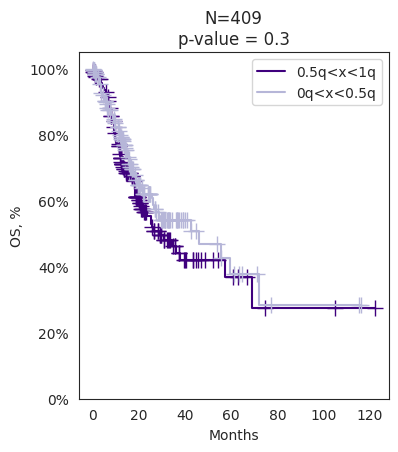

TGCT


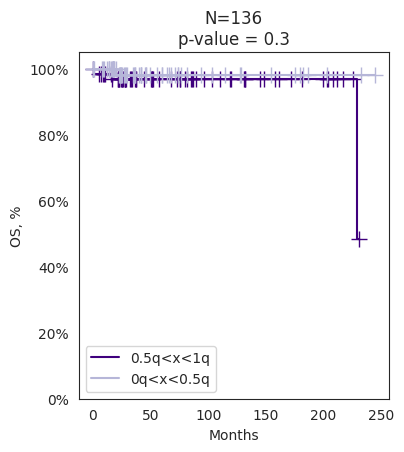

THCA


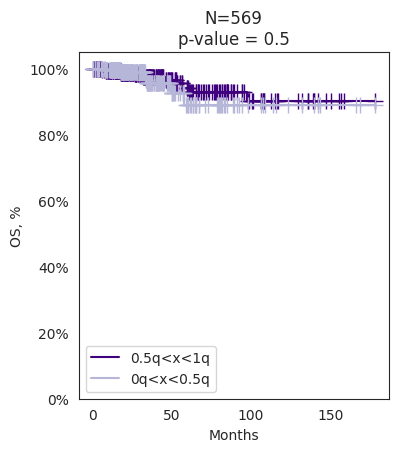

THYM


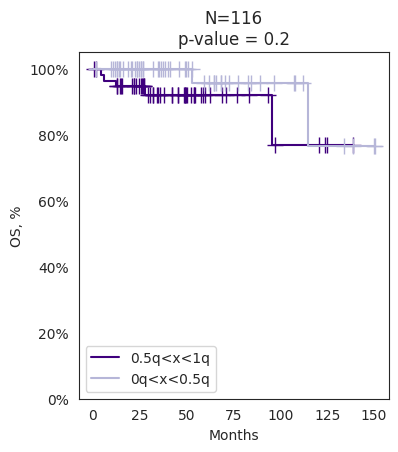

UCEC


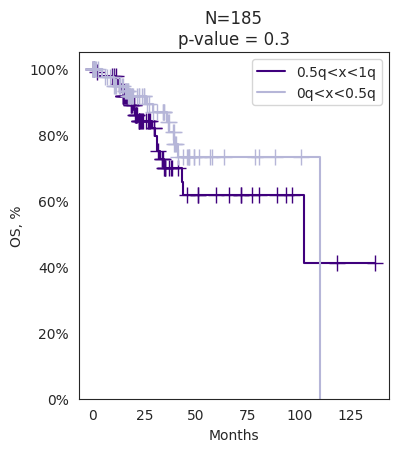

UCS


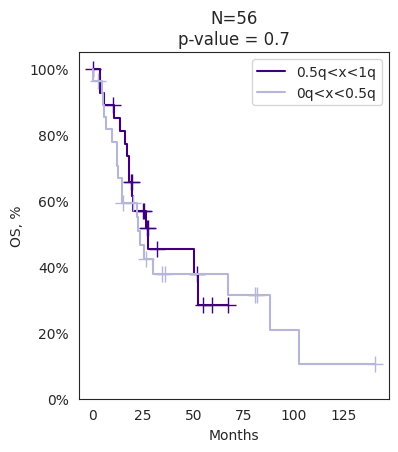

UVM


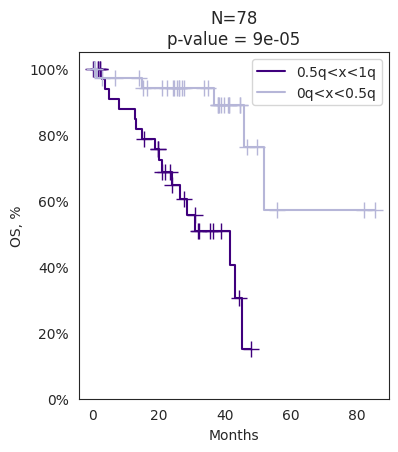

In [ ]:
for diagnosis in tcga_anno.acronym.unique():
    print(diagnosis)
    kaplan_meier_quantiles(
        tcga_ssgsea[signature_name].reindex(
            tcga_anno[tcga_anno.acronym == diagnosis].index
        ),
        survival,
    )
    plt.show()

### Correlation with any celltype from deconvolution

In [ ]:
# list all available celltypes from deconvolution
tcga_deconv.index.tolist()

['B_cells',
 'CD4_T_cells',
 'CD8_T_cells',
 'CD8_T_cells_PD1_high',
 'CD8_T_cells_PD1_low',
 'Central_memory_T_helpers',
 'Class_switched_memory_B_cells',
 'Conventional_T_cells',
 'Cytotoxic_NK_cells',
 'Effector_memory_T_helpers',
 'Endothelium',
 'Fibroblasts',
 'Macrophages',
 'Macrophages_M1',
 'Macrophages_M2',
 'Mature_B_cells',
 'Memory_CD8_T_cells',
 'NK_cells',
 'Naive_B_cells',
 'Naive_CD8_T_cells',
 'Naive_T_helpers',
 'Neutrophils',
 'Non_switched_memory_B_cells',
 'Regulatory_NK_cells',
 'Secreting_B_cells',
 'T_cells',
 'Th17_cells',
 'Th1_cells',
 'Th2_cells',
 'Transitional_memory_T_helpers',
 'Tregs',
 'Other',
 'Lymphoid_cells',
 'Myeloid_cells',
 'Naive_T_cells',
 'Stromal_cells',
 'Memory_T_cells',
 'Tumor']

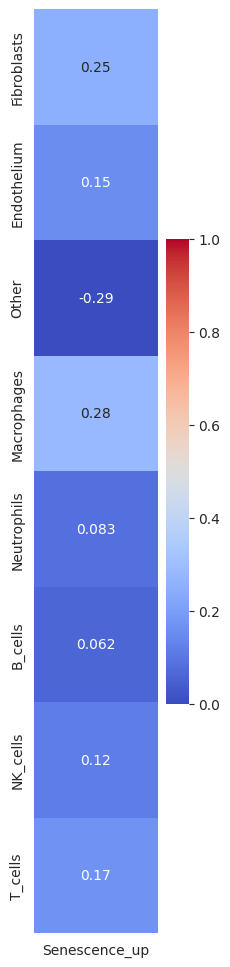

In [ ]:
signatures = geneset_of_interest
cell_types = [
    "Fibroblasts",
    "Endothelium",
    "Other",
    "Macrophages",
    "Neutrophils",
    "B_cells",
    "NK_cells",
    "T_cells",
]
corr_scores = []
for name, genes in signatures.items():
    ssgsea_scores = tcga_ssgsea
    corr = tcga_deconv.T[cell_types].corrwith(
        ssgsea_scores[name], axis="index", method="spearman"
    )
    corr.name = name
    corr_scores.append(corr)
corr_scores = pd.concat(corr_scores, axis=1)
f, ax = plt.subplots(figsize=(len(signatures) * 2, len(cell_types) * 1.5))
sns.heatmap(
    corr_scores,
    cbar=True,
    cmap="coolwarm",
    xticklabels=True,
    annot=True,
    vmin=0,
    vmax=1,
    ax=ax,
)
plt.show()

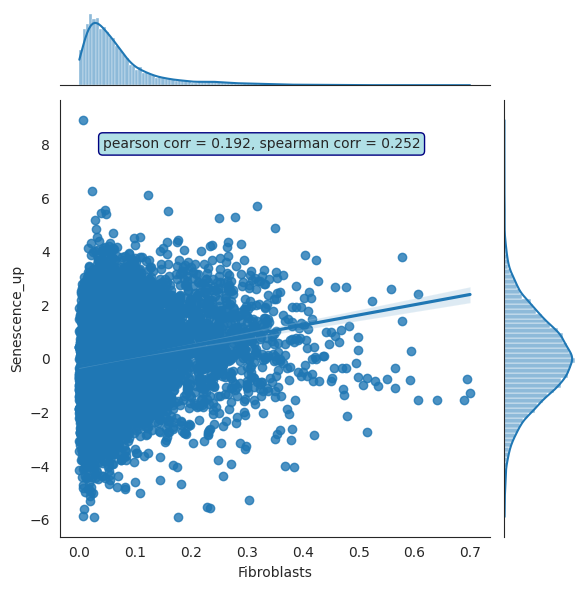

In [ ]:
celltype_from_deconv = "Fibroblasts"

g = sns.jointplot(
    tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name], kind="reg"
)
r, p = scipy.stats.pearsonr(
    tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name]
)
rs, ps = scipy.stats.spearmanr(
    tcga_deconv.loc[celltype_from_deconv], tcga_ssgsea[signature_name]
)

g.ax_joint.annotate(
    f"pearson corr = {r:.3f}, spearman corr = {rs:.3f}",
    xy=(0.1, 0.9),
    xycoords="axes fraction",
    ha="left",
    va="center",
    bbox={"boxstyle": "round", "fc": "powderblue", "ec": "navy"},
)

plt.show()

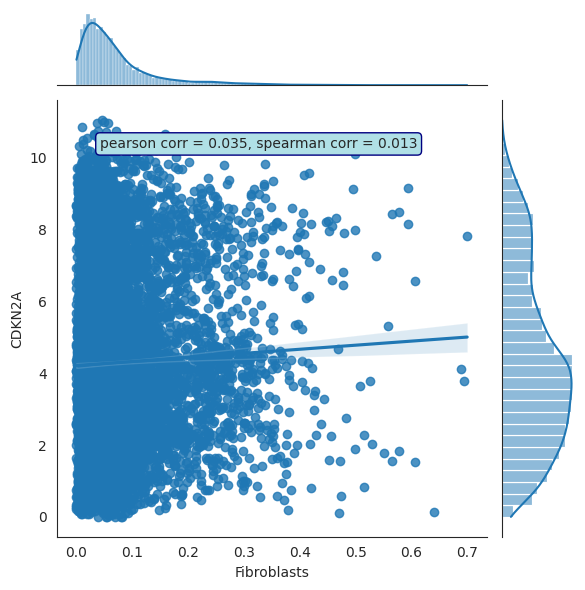

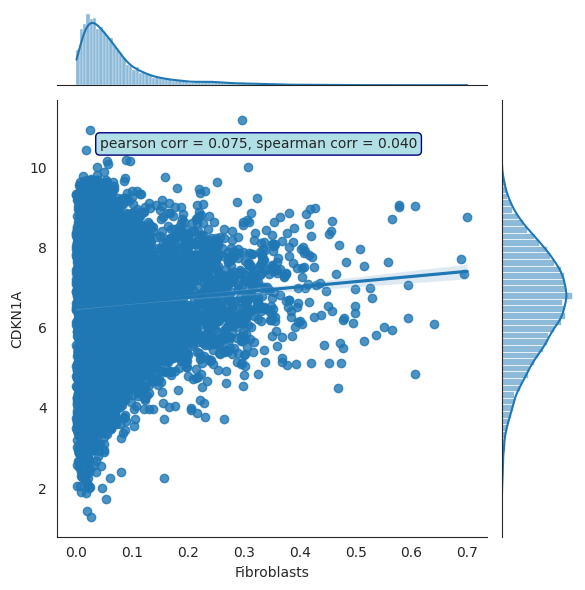

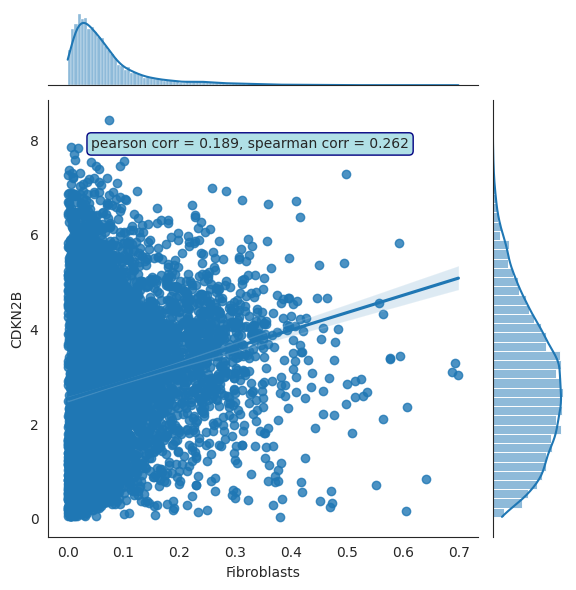

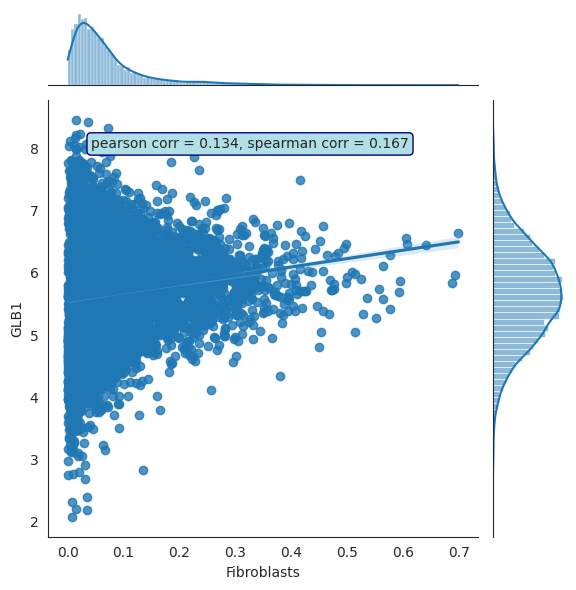

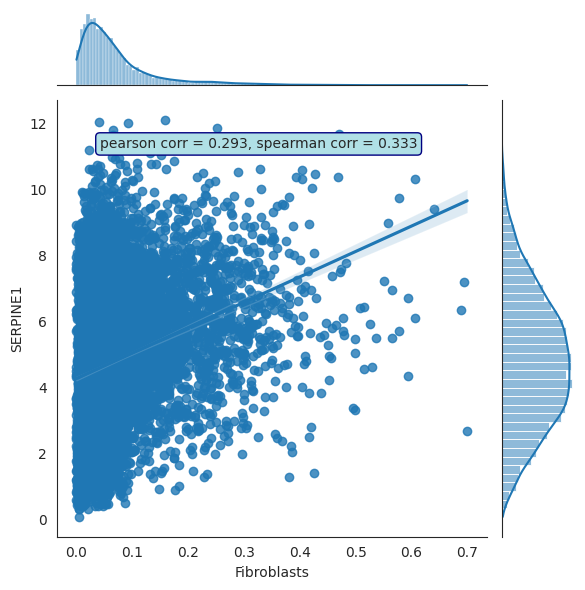

...

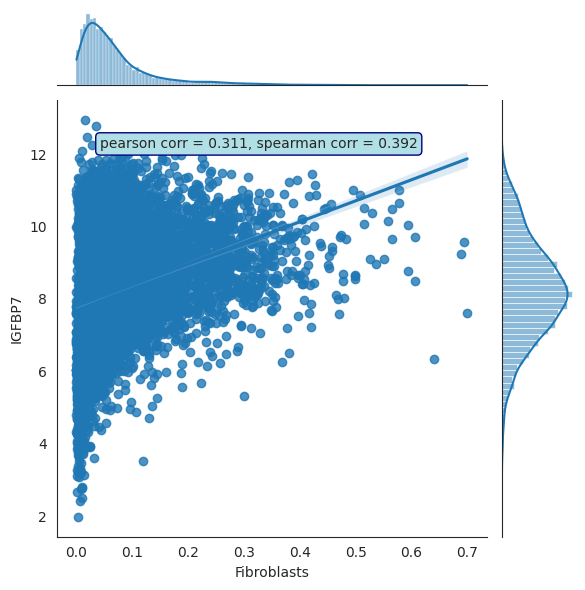

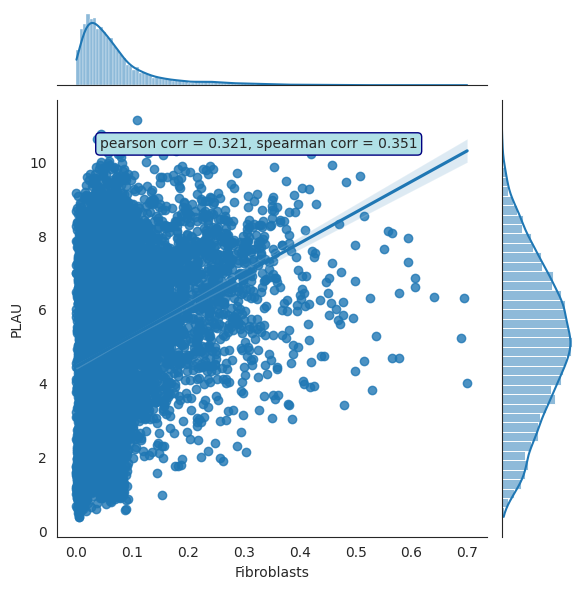

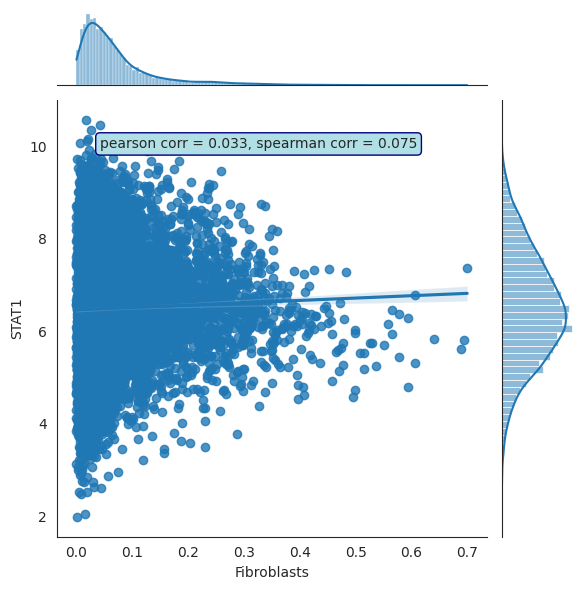

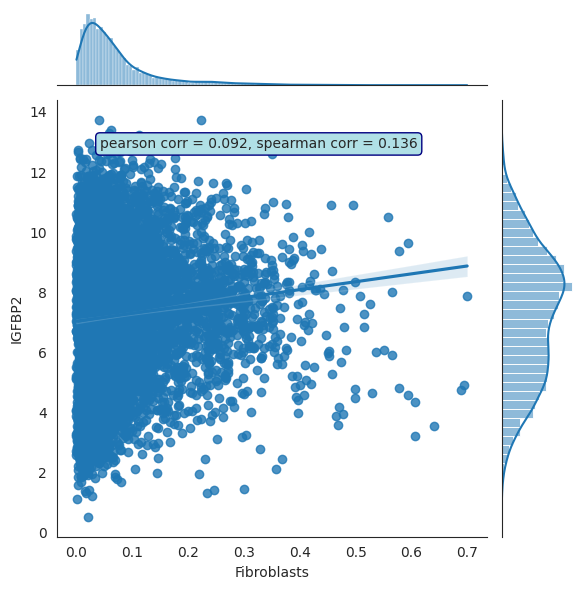

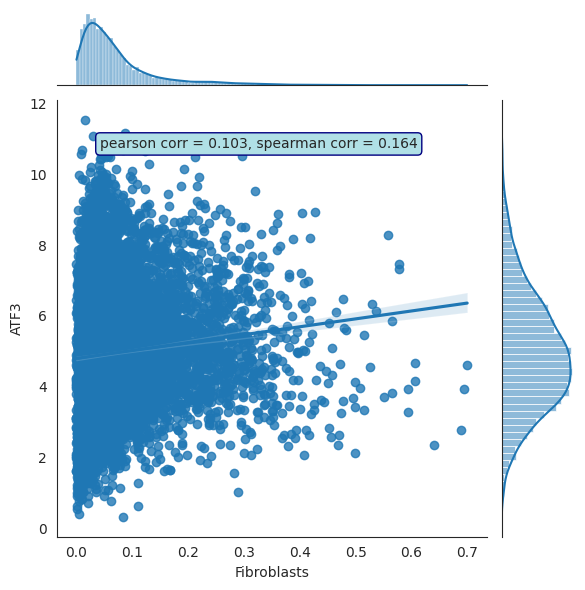

In [ ]:
# comparison with deconvolution for every gene (log2 (TPM+1)) in your signature of interest
for gene in signature_of_interest:
    g = sns.jointplot(
        tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene], kind="reg"
    )

    r, p = scipy.stats.pearsonr(
        tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene]
    )
    rs, ps = scipy.stats.spearmanr(
        tcga_deconv.loc[celltype_from_deconv], tcga_expressions.loc[gene]
    )

    g.ax_joint.annotate(
        f"pearson corr = {r:.3f}, spearman corr = {rs:.3f}",
        xy=(0.1, 0.9),
        xycoords="axes fraction",
        ha="left",
        va="center",
        bbox={"boxstyle": "round", "fc": "powderblue", "ec": "navy"},
    )
    plt.show()

# Signature validation: single cell data

In [252]:
import scanpy as sc

### read annotation and expressions

https://docs.google.com/spreadsheets/d/1OPG6o5rq8lOnP1QZm8gSmgLPjq3Vz-gM6o3i8wzkBbQ/edit#gid=0 - here we have a full list of single cell data, pick anything suitable for your signature. Replace path in cell below with the path you see in H5ad column

In [ ]:
adata = sc.read(
    "/uftp/single_cell/annotations/Public_datasets/Ready/CAF_project/GSE144735_Lee_et_al_Colorectal_cancer/GSE144735.h5ad/"
)

public colorectal cancer single cell. Not very informative in senescence signature validation, but at least this signature is higher in cells from tumor and tumor border than in cells from normal tissue

In [254]:
# check which column describes celltype in your  adata and pick this columns for the next cell in notebook
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,Index,Patient,Class,Sample,Cell_type,Cell_subtype,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
KUL01.T_AAACCTGGTCTTTCAT,KUL01.T,8119.0,2640,KUL01.T_AAACCTGGTCTTTCAT,KUL01,Tumor,KUL01-T,Epithelial cells,CMS1,2640,8119.0,1261.0,15.531470
KUL01.T_AAACGGGTCGGTTAAC,KUL01.T,1058.0,628,KUL01.T_AAACGGGTCGGTTAAC,KUL01,Tumor,KUL01-T,Epithelial cells,CMS3,628,1058.0,34.0,3.213610
KUL01.T_AAAGATGGTATAGGGC,KUL01.T,10935.0,3308,KUL01.T_AAAGATGGTATAGGGC,KUL01,Tumor,KUL01-T,Epithelial cells,CMS3,3308,10935.0,739.0,6.758116
KUL01.T_AAAGATGGTGGCCCTA,KUL01.T,15190.0,3448,KUL01.T_AAAGATGGTGGCCCTA,KUL01,Tumor,KUL01-T,Epithelial cells,CMS1,3448,15190.0,843.0,5.549704
KUL01.T_AAAGCAAGTAAACACA,KUL01.T,12317.0,3125,KUL01.T_AAAGCAAGTAAACACA,KUL01,Tumor,KUL01-T,Epithelial cells,CMS3,3125,12317.0,1236.0,10.034911
...,...,...,...,...,...,...,...,...,...,...,...,...,...
KUL31.N_CGCTTCAGTGGTCCGT,KUL31.N,2184.0,843,KUL31.N_CGCTTCAGTGGTCCGT,KUL31,Normal,KUL31-N,Mast cells,Mast cells,843,2184.0,67.0,3.067765
KUL31.N_CTGTTTAAGGGTTCCC,KUL31.N,3171.0,1205,KUL31.N_CTGTTTAAGGGTTCCC,KUL31,Normal,KUL31-N,Mast cells,Mast cells,1205,3171.0,117.0,3.689688
KUL31.N_GCCTCTATCGCGGATC,KUL31.N,2297.0,892,KUL31.N_GCCTCTATCGCGGATC,KUL31,Normal,KUL31-N,Mast cells,Mast cells,892,2297.0,79.0,3.439269
KUL31.N_GGGATGATCACCTCGT,KUL31.N,1125.0,503,KUL31.N_GGGATGATCACCTCGT,KUL31,Normal,KUL31-N,Mast cells,Mast cells,503,1125.0,50.0,4.444445


In [ ]:
celltype_col = "Cell_subtype"

In [ ]:
# logn TPM+1
adata.X = scipy.sparse.csc_matrix(adata.X)
expr_df = pd.DataFrame.sparse.from_spmatrix(
    adata.X, index=adata.obs_names, columns=adata.var_names
).T
expr_df

,KUL01.T_AAACCTGGTCTTTCAT,KUL01.T_AAACGGGTCGGTTAAC,KUL01.T_AAAGATGGTATAGGGC,KUL01.T_AAAGATGGTGGCCCTA,KUL01.T_AAAGCAAGTAAACACA,KUL01.T_AAAGCAATCACATGCA,KUL01.T_AAAGTAGTCCGTCATC,KUL01.T_AAATGCCAGTCGTTTG,KUL01.T_AAATGCCAGTGACTCT,KUL01.T_AAATGCCCACAGTCGC,...,KUL30.N_TGGACGCCATCCTAGA,KUL30.N_TTAGGACCATCTACGA,KUL30.N_TTTGGTTCAAGCGCTC,KUL31.N_CAACTAGCACATGTGT,KUL31.N_CAGCATAGTCATGCAT,KUL31.N_CGCTTCAGTGGTCCGT,KUL31.N_CTGTTTAAGGGTTCCC,KUL31.N_GCCTCTATCGCGGATC,KUL31.N_GGGATGATCACCTCGT,KUL31.N_TTAGTTCTCGGTCCGA
HES4,-0.410040,-0.179546,-0.297262,1.302737,-0.355327,-0.441104,-0.470187,-0.539889,1.543865,-0.230052,...,-0.217104,-0.271622,-0.269688,-0.214049,3.811194,-0.184741,-0.200508,-0.191038,-0.198395,4.300696
ISG15,0.269847,-0.556944,0.517616,2.249553,2.021425,2.090389,0.787522,0.734121,1.818690,0.297859,...,-0.581486,-0.616924,-0.610919,-0.591813,1.017378,-0.573237,-0.593924,1.323550,2.064263,-0.592932
TNFRSF18,-0.093043,-0.423879,-0.268942,-0.263723,-0.184712,-0.098794,-0.068979,0.066772,-0.063937,-0.363691,...,-0.367982,-0.286806,-0.288790,-0.374857,-0.359305,-0.418586,-0.397081,-0.409369,-0.395684,-0.379723
TNFRSF4,-0.125766,-0.419292,-0.266597,-0.252362,1.125135,-0.076204,-0.036796,0.044871,-0.025115,-0.352529,...,-0.371859,-0.303013,-0.305634,-0.375254,2.351032,-0.412247,-0.391944,-0.404264,-0.395516,-0.378789
TAS1R3,-0.057113,-0.043544,-0.071471,-0.085290,-0.073561,-0.134303,-0.153875,-0.104522,-0.164291,-0.064939,...,-0.042777,-0.041610,-0.040308,-0.046326,-0.049128,-0.047088,-0.049703,-0.047191,-0.042945,-0.047235
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S100B,-0.222796,-0.210456,-0.141868,-0.095162,-0.149715,0.044337,0.106482,-0.087916,0.141489,-0.147455,...,-0.223090,-0.241620,-0.245752,-0.209628,-0.202748,-0.199187,-0.194013,-0.200479,-0.217561,-0.205622
AC136616.3,-0.004256,-0.010241,-0.004195,-0.002055,-0.002876,0.007281,0.010579,0.004778,0.012205,-0.006307,...,-0.009690,-0.008897,-0.009117,-0.009238,-0.008632,-0.009645,-0.008995,-0.009520,-0.009995,-0.009159
AC145212.2,-0.049337,-0.062668,-0.061042,-0.063743,-0.057356,-0.066140,-0.068865,5.189497,2.950643,-0.064293,...,-0.059761,-0.055527,-0.055346,-0.060857,-0.060694,-0.063166,-0.062671,-0.062736,-0.061156,-0.061291
AL592183.1,4.014718,-0.183816,-0.188800,-0.207339,-0.172834,-0.240157,-0.261369,-0.160431,0.814178,3.644679,...,-0.170147,-0.150222,-0.148812,-0.176756,-0.177254,-0.187679,-0.186573,-0.185753,-0.176618,-0.179148


### delete genes w zero counts

In [257]:
row_sums = expr_df.sum(axis=1)
row_sums

HES4         -0.004388
ISG15        -0.000429
TNFRSF18     -0.004050
TNFRSF4       0.001290
TAS1R3        0.001188
                ...   
S100B         0.004291
AC136616.3    0.000039
AC145212.2    0.000752
AL592183.1    0.001438
AC233755.1   -0.000487
Length: 5000, dtype: float32

In [258]:
row_sums = row_sums[row_sums > 0]
row_sums

TNFRSF4          0.001290
TAS1R3           0.001188
VWA1             0.008472
RP1-140A9.1      0.000146
RP11-547D24.1    0.000699
                   ...   
AP001476.2       0.000059
S100B            0.004291
AC136616.3       0.000039
AC145212.2       0.000752
AL592183.1       0.001438
Length: 2595, dtype: float32

In [ ]:
# If the matrix is too big (> 20k cells) it can be better to replace expr_df instead of creating a copy
expr_df_final = expr_df.loc[row_sums.index]
expr_df_final

,KUL01.T_AAACCTGGTCTTTCAT,KUL01.T_AAACGGGTCGGTTAAC,KUL01.T_AAAGATGGTATAGGGC,KUL01.T_AAAGATGGTGGCCCTA,KUL01.T_AAAGCAAGTAAACACA,KUL01.T_AAAGCAATCACATGCA,KUL01.T_AAAGTAGTCCGTCATC,KUL01.T_AAATGCCAGTCGTTTG,KUL01.T_AAATGCCAGTGACTCT,KUL01.T_AAATGCCCACAGTCGC,...,KUL30.N_TGGACGCCATCCTAGA,KUL30.N_TTAGGACCATCTACGA,KUL30.N_TTTGGTTCAAGCGCTC,KUL31.N_CAACTAGCACATGTGT,KUL31.N_CAGCATAGTCATGCAT,KUL31.N_CGCTTCAGTGGTCCGT,KUL31.N_CTGTTTAAGGGTTCCC,KUL31.N_GCCTCTATCGCGGATC,KUL31.N_GGGATGATCACCTCGT,KUL31.N_TTAGTTCTCGGTCCGA
TNFRSF4,-0.125766,-0.419292,-0.266597,-0.252362,1.125135,-0.076204,-0.036796,0.044871,-0.025115,-0.352529,...,-0.371859,-0.303013,-0.305634,-0.375254,2.351032,-0.412247,-0.391944,-0.404264,-0.395516,-0.378789
TAS1R3,-0.057113,-0.043544,-0.071471,-0.085290,-0.073561,-0.134303,-0.153875,-0.104522,-0.164291,-0.064939,...,-0.042777,-0.041610,-0.040308,-0.046326,-0.049128,-0.047088,-0.049703,-0.047191,-0.042945,-0.047235
VWA1,1.730425,-0.125580,-0.314983,1.148769,-0.437529,0.331777,-0.490089,-0.766443,0.610327,-0.183384,...,-0.210127,-0.332989,-0.331975,-0.194563,-0.213576,-0.128179,-0.156352,-0.141776,-0.168545,-0.185941
RP1-140A9.1,-0.007792,-0.035895,-0.033456,-0.039775,-0.025623,-0.046766,-0.053353,-0.014523,-0.058000,-0.040190,...,-0.029626,-0.020496,-0.020058,-0.032114,-0.031869,-0.037099,-0.036134,-0.036179,-0.032628,-0.033079
RP11-547D24.1,-0.087625,-0.009966,-0.037168,-0.032612,-0.057520,-0.053372,-0.052573,-0.107778,-0.049418,-0.016051,...,-0.024388,-0.045353,-0.045406,-0.021146,-0.023877,-0.009795,-0.014106,-0.012076,-0.017331,-0.019532
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AP001476.2,-0.013772,-0.021179,-0.014088,-0.011687,-0.012432,-0.000901,0.002848,-0.003334,0.004675,-0.016654,...,-0.020442,-0.019379,-0.019628,-0.019952,-0.019241,-0.020503,-0.019730,-0.020342,-0.020843,-0.019875
S100B,-0.222796,-0.210456,-0.141868,-0.095162,-0.149715,0.044337,0.106482,-0.087916,0.141489,-0.147455,...,-0.223090,-0.241620,-0.245752,-0.209628,-0.202748,-0.199187,-0.194013,-0.200479,-0.217561,-0.205622
AC136616.3,-0.004256,-0.010241,-0.004195,-0.002055,-0.002876,0.007281,0.010579,0.004778,0.012205,-0.006307,...,-0.009690,-0.008897,-0.009117,-0.009238,-0.008632,-0.009645,-0.008995,-0.009520,-0.009995,-0.009159
AC145212.2,-0.049337,-0.062668,-0.061042,-0.063743,-0.057356,-0.066140,-0.068865,5.189497,2.950643,-0.064293,...,-0.059761,-0.055527,-0.055346,-0.060857,-0.060694,-0.063166,-0.062671,-0.062736,-0.061156,-0.061291


### ssgsea

In [ ]:
cgenes = expr_df_final
# cgenes = cgenes.fillna(cgenes.median(axis=1))

cprocesses = ssgsea_formula(
    cgenes,
    gmt_genes_alt_names(geneset_of_interest, cgenes.index, verbose=False),
    rank_method="average",
).T
cprocesses_sc = median_scale(cprocesses)
# if we don't want to scale ssgsea scores:
# cprocesses_sc = cprocesses

In [261]:
cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
cprocesses_sc["Cell_name"] = cprocesses_sc.index
cprocesses_sc

,Senescence_up,Cell_types,Cell_name
KUL01.T_AAACCTGGTCTTTCAT,1.377561,CMS1,KUL01.T_AAACCTGGTCTTTCAT
KUL01.T_AAACGGGTCGGTTAAC,1.173593,CMS3,KUL01.T_AAACGGGTCGGTTAAC
KUL01.T_AAAGATGGTATAGGGC,3.961574,CMS3,KUL01.T_AAAGATGGTATAGGGC
KUL01.T_AAAGATGGTGGCCCTA,3.929450,CMS1,KUL01.T_AAAGATGGTGGCCCTA
KUL01.T_AAAGCAAGTAAACACA,1.569623,CMS3,KUL01.T_AAAGCAAGTAAACACA
...,...,...,...
KUL31.N_CGCTTCAGTGGTCCGT,1.099029,Mast cells,KUL31.N_CGCTTCAGTGGTCCGT
KUL31.N_CTGTTTAAGGGTTCCC,0.232704,Mast cells,KUL31.N_CTGTTTAAGGGTTCCC
KUL31.N_GCCTCTATCGCGGATC,1.058270,Mast cells,KUL31.N_GCCTCTATCGCGGATC
KUL31.N_GGGATGATCACCTCGT,1.071250,Mast cells,KUL31.N_GGGATGATCACCTCGT


In [262]:
df_all = cprocesses_sc

In [ ]:
# sort all ssdata according to signature abundance
ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))

for type_name in df_all["Cell_types"]:
    ctypes_median[type_name] = df_all.loc[df_all["Cell_types"] == type_name][
        signature_name
    ].median()

In [ ]:
df_median = ctypes_median.sort_values(ascending=False)
df_median

SPP1+A                 2.796341
SPP1+B                 1.345077
CMS3                   1.340504
BEST4+ Enterocytes     1.327775
Stem-like/TA           1.313494
                         ...   
Smooth muscle cells   -0.622198
Stromal 3             -0.638082
gamma delta T cells   -0.640711
Stromal 2             -0.652772
IgA+ Plasma            -0.86898
Length: 40, dtype: object

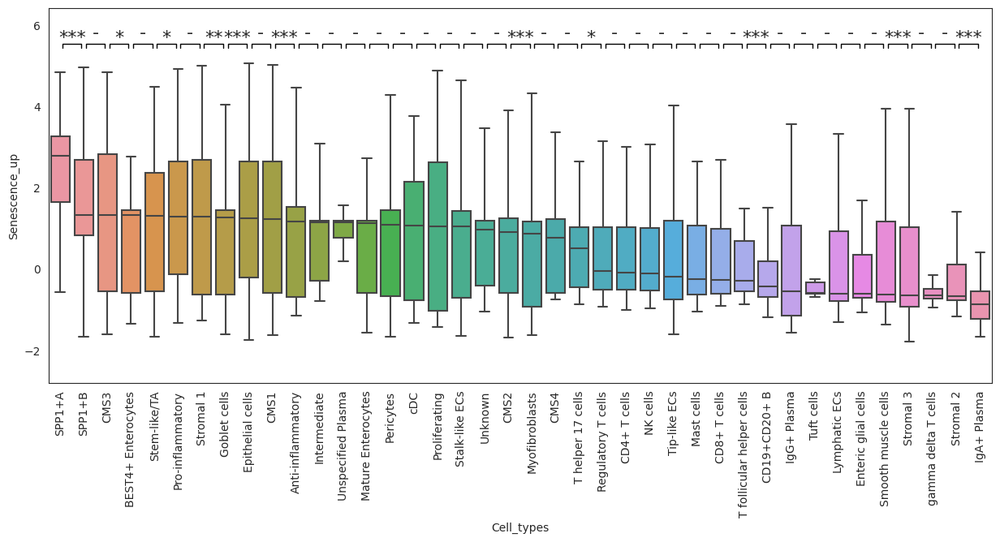

In [ ]:
ax = boxplot_with_pvalue(
    cprocesses_sc[signature_name],
    df_all["Cell_types"],
    order=df_median.index,
    swarm=False,
    figsize=[15, 6],
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

In [ ]:
celltype_col = "Class"

In [267]:
cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
cprocesses_sc["Cell_name"] = cprocesses_sc.index
cprocesses_sc

,Senescence_up,Cell_types,Cell_name
KUL01.T_AAACCTGGTCTTTCAT,1.377561,Tumor,KUL01.T_AAACCTGGTCTTTCAT
KUL01.T_AAACGGGTCGGTTAAC,1.173593,Tumor,KUL01.T_AAACGGGTCGGTTAAC
KUL01.T_AAAGATGGTATAGGGC,3.961574,Tumor,KUL01.T_AAAGATGGTATAGGGC
KUL01.T_AAAGATGGTGGCCCTA,3.929450,Tumor,KUL01.T_AAAGATGGTGGCCCTA
KUL01.T_AAAGCAAGTAAACACA,1.569623,Tumor,KUL01.T_AAAGCAAGTAAACACA
...,...,...,...
KUL31.N_CGCTTCAGTGGTCCGT,1.099029,Normal,KUL31.N_CGCTTCAGTGGTCCGT
KUL31.N_CTGTTTAAGGGTTCCC,0.232704,Normal,KUL31.N_CTGTTTAAGGGTTCCC
KUL31.N_GCCTCTATCGCGGATC,1.058270,Normal,KUL31.N_GCCTCTATCGCGGATC
KUL31.N_GGGATGATCACCTCGT,1.071250,Normal,KUL31.N_GGGATGATCACCTCGT


In [268]:
df_all = cprocesses_sc

In [ ]:
# sort all ssdata according to signature abundance
ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))

for type_name in df_all["Cell_types"]:
    ctypes_median[type_name] = df_all.loc[df_all["Cell_types"] == type_name][
        signature_name
    ].median()

In [ ]:
df_median = ctypes_median.sort_values(ascending=False)
df_median

Tumor     0.926326
Border     0.90927
Normal   -0.555173
dtype: object

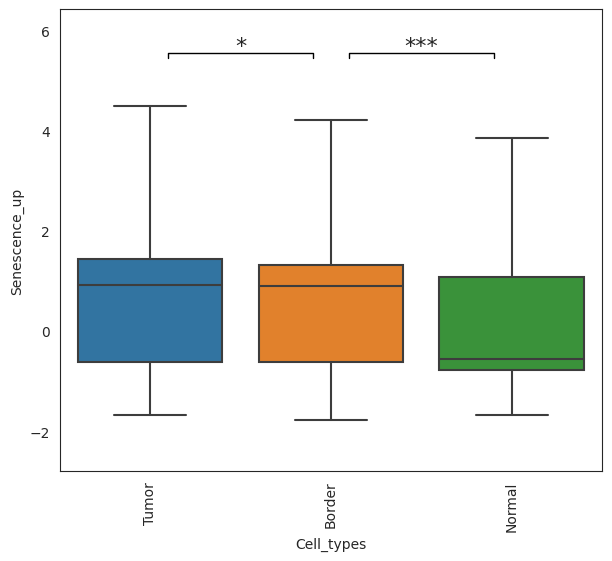

In [ ]:
ax = boxplot_with_pvalue(
    cprocesses_sc[signature_name],
    df_all["Cell_types"],
    order=df_median.index,
    swarm=False,
    figsize=[7, 6],
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

### UMAP plots

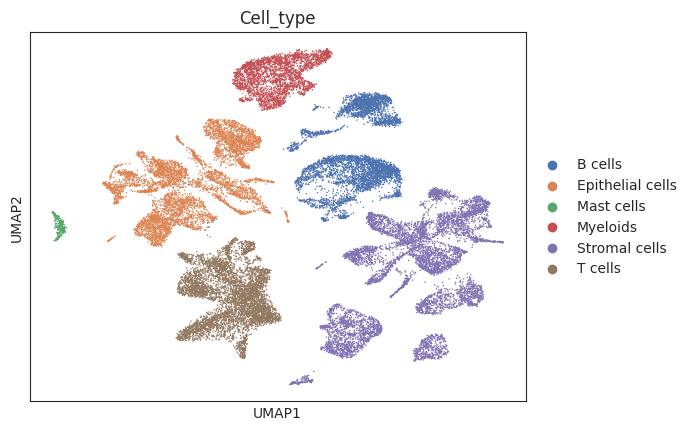

In [ ]:
sc.pl.umap(adata, color=["Cell_type"])

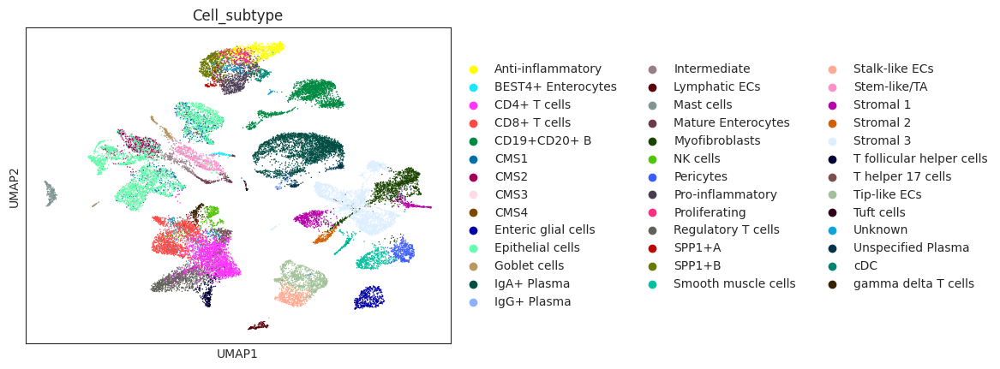

In [ ]:
sc.pl.umap(adata, color=["Cell_subtype"])

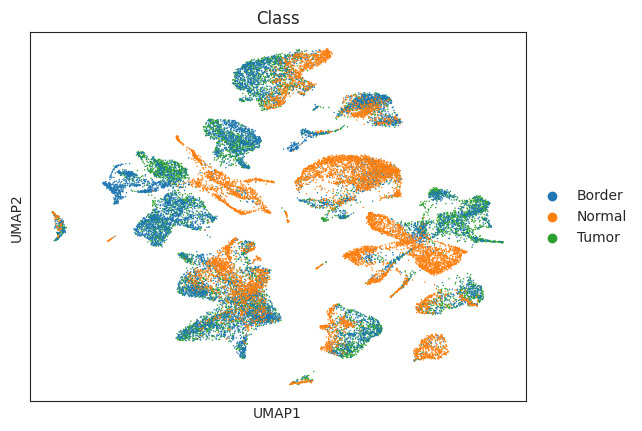

In [274]:
sc.pl.umap(adata, color=[celltype_col])

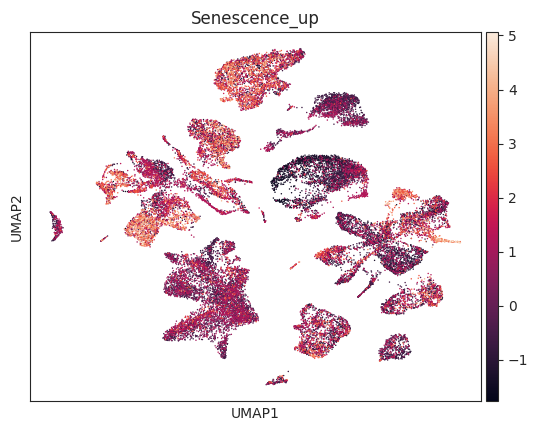

In [ ]:
# umap with ssgsea score
adata.obs[signature_name] = cprocesses_sc[signature_name]
sc.pl.umap(adata, color=[signature_name])

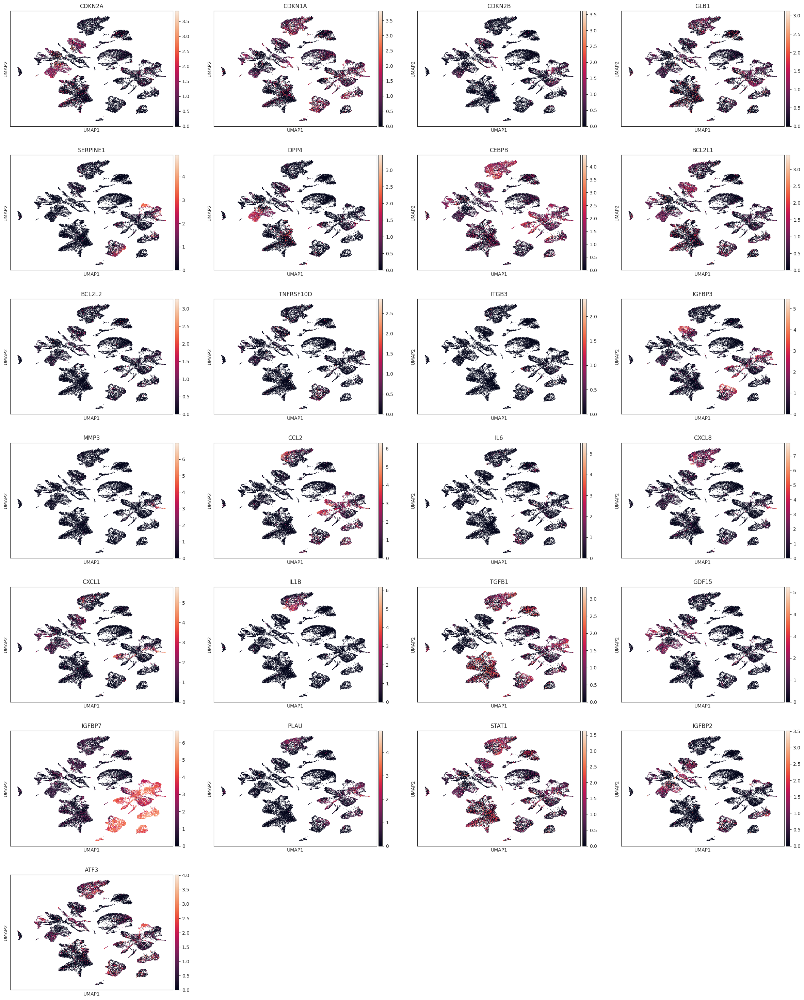

In [ ]:
# umap with custom genes (ln expressions)
genes_of_interest = signature_of_interest
sc.pl.umap(adata, color=genes_of_interest)

## Stromal cells only

In [ ]:
adata = sc.read(
    "/uftp/single_cell/annotations/Public_datasets/Ready/CAF_project/GSE144735_Lee_et_al_Colorectal_cancer/GSE144735_stromal.h5ad"
)
# check which column describes celltype in your  adata and pick this columns for the next cell in notebook
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,Index,Patient,Class,Sample,Cell_type,Cell_subtype,n_genes_by_counts,...,tumor_growth_promotion_cytokine_genes,invasion_and_metastasis_induction_cytokine_genes,CAF_genes,senescence_up_genes,NFKB_genes,WNT_genes,TGFb_genes,hypoxia_genes,BG_Subtype,BG_Classification_old
KUL21.B_TAAGTGCCAGCCAATT,KUL21.B,1136.0,689,KUL21.B_TAAGTGCCAGCCAATT,KUL21,Border,KUL21-B,Epithelial cells,Epithelial cells,689,...,-0.099881,-0.080157,0.876662,0.151596,0.073346,-0.006334,-0.123108,0.251759,myCAF,myCAF
KUL01.T_AAACCTGTCTGGGCCA,KUL01.T,23972.0,4912,KUL01.T_AAACCTGTCTGGGCCA,KUL01,Tumor,KUL01-T,Stromal cells,Myofibroblasts,4912,...,-0.164995,-0.169358,1.561118,0.225987,-0.084980,-0.099032,0.141083,0.271754,myCAF,myCAF
KUL01.T_AAACGGGAGTGAAGTT,KUL01.T,11716.0,3037,KUL01.T_AAACGGGAGTGAAGTT,KUL01,Tumor,KUL01-T,Stromal cells,Stromal 3,3037,...,0.244740,0.081259,1.175219,0.300397,0.052827,-0.105182,0.027528,0.144876,CXCL12_iCAF,CXCL12_iCAF
KUL01.T_AAAGATGGTTGTCTTT,KUL01.T,20776.0,3885,KUL01.T_AAAGATGGTTGTCTTT,KUL01,Tumor,KUL01-T,Stromal cells,Stromal 1,3885,...,0.617123,0.198233,1.267308,0.371525,0.017350,-0.066712,0.054433,0.834450,myCAF,myCAF
KUL01.T_AAAGATGTCCAGAGGA,KUL01.T,8441.0,2543,KUL01.T_AAAGATGTCCAGAGGA,KUL01,Tumor,KUL01-T,Stromal cells,Smooth muscle cells,2543,...,-0.207171,-0.177619,0.025107,0.113981,0.128734,-0.055818,-0.181011,0.445209,PVL,PVL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
KUL31.B_TTAGTTCGTGCGAAAC,KUL31.B,15019.0,3864,KUL31.B_TTAGTTCGTGCGAAAC,KUL31,Border,KUL31-B,Stromal cells,Myofibroblasts,3864,...,-0.226670,-0.174662,1.044347,0.219033,0.162814,-0.073167,-0.034256,0.541868,CXCL14_iCAF,CXCL1_iCAF
KUL31.B_TTCCCAGTCGTTACGA,KUL31.B,2960.0,1471,KUL31.B_TTCCCAGTCGTTACGA,KUL31,Border,KUL31-B,Stromal cells,Myofibroblasts,1471,...,0.126179,-0.133371,1.013423,0.713283,-0.035296,0.099755,0.292676,0.113366,IL6_iCAF,CXCL1_iCAF
KUL31.B_TTCTTAGGTATAGGGC,KUL31.B,26012.0,5309,KUL31.B_TTCTTAGGTATAGGGC,KUL31,Border,KUL31-B,Stromal cells,Myofibroblasts,5309,...,-0.106069,-0.113357,1.471067,0.283946,0.110556,-0.002497,0.051176,0.208431,myCAF,myCAF
KUL31.B_TTCTTAGTCTATCCTA,KUL31.B,9334.0,2973,KUL31.B_TTCTTAGTCTATCCTA,KUL31,Border,KUL31-B,Stromal cells,Myofibroblasts,2973,...,-0.203557,-0.045439,0.874907,0.307063,-0.023393,-0.035342,-0.028637,0.985747,IL6_iCAF,CXCL1_iCAF


In [ ]:
celltype_col = "BG_Subtype"

In [ ]:
# logn TPM+1
adata.X = scipy.sparse.csc_matrix(adata.X)
expr_df = pd.DataFrame.sparse.from_spmatrix(
    adata.X, index=adata.obs_names, columns=adata.var_names
).T
expr_df

,KUL21.B_TAAGTGCCAGCCAATT,KUL01.T_AAACCTGTCTGGGCCA,KUL01.T_AAACGGGAGTGAAGTT,KUL01.T_AAAGATGGTTGTCTTT,KUL01.T_AAAGATGTCCAGAGGA,KUL01.T_AAAGTAGAGCACGCCT,KUL01.T_AAAGTAGGTCGGCACT,KUL01.T_AACACGTCACACGCTG,KUL01.T_AACACGTTCGCCCTTA,KUL01.T_AACCATGCATTACCTT,...,KUL31.B_TGCCAAAGTAGCCTAT,KUL31.B_TGCCCTATCGAGCCCA,KUL31.B_TGGCCAGCATTGAGCT,KUL31.B_TGGTTCCAGTGTTGAA,KUL31.B_TGTATTCTCTCAAACG,KUL31.B_TTAGTTCGTGCGAAAC,KUL31.B_TTCCCAGTCGTTACGA,KUL31.B_TTCTTAGGTATAGGGC,KUL31.B_TTCTTAGTCTATCCTA,KUL19.T_GGTGCGTCACTAAGTC
HES4,-0.316322,-0.344349,-0.238064,-0.310608,3.227641,1.285437,-0.286556,-0.361989,-0.315468,-0.320606,...,1.705840,-0.204502,5.721194,2.430778,-0.280201,-0.265855,-0.304122,2.986817,-0.206364,-0.288925
ISG15,1.936415,0.348686,-0.716500,-0.005380,0.245595,0.481125,0.773300,-0.329362,0.278449,-0.765542,...,0.828229,-0.577519,-0.708526,0.410703,-0.140250,0.682531,-0.650612,0.114497,0.173029,-0.641801
TNFRSF18,-0.218364,-0.227287,-0.359714,-0.270882,-0.339750,-0.367397,-0.298307,-0.211154,-0.268303,1.850483,...,0.392592,-0.387544,-0.304604,-0.313734,-0.303143,-0.325307,-0.240790,-0.234721,-0.402058,-0.263620
TNFRSF4,-0.246941,-0.201480,-0.340832,-0.245410,-0.331698,-0.334032,-0.277449,-0.177190,-0.238347,-0.236770,...,-0.193440,-0.387614,-0.299946,-0.313114,0.773367,-0.304350,-0.261500,-0.202980,-0.381827,-0.280651
TAS1R3,-0.037828,-0.113064,-0.076673,-0.103838,-0.065340,-0.095644,-0.091797,-0.127856,-0.110707,-0.073601,...,-0.130946,-0.044242,-0.067589,-0.060037,-0.085007,-0.086518,-0.044469,-0.119978,-0.070083,-0.045096
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
S100B,-0.266887,-0.005921,-0.107714,-0.029938,-0.150351,-0.040941,-0.066547,0.042190,-0.006718,-0.140420,...,0.056680,-0.214545,-0.148879,-0.173283,-0.089092,-0.079923,-0.239987,0.019243,-0.122867,-0.233745
AC136616.3,-0.008650,0.002556,-0.004495,0.000649,-0.005961,-0.001734,-0.001489,0.004972,0.001712,-0.003481,...,0.005180,-0.009703,-0.005204,-0.006448,-0.002567,-0.002604,-0.007919,0.003506,-0.005991,-0.008097
AC145212.2,-0.051359,-0.067900,-0.066609,-0.068064,-0.063204,-0.071046,-0.066833,-0.070274,-0.069408,-0.059878,...,3.873765,-0.061034,-0.061961,-0.060792,-0.065617,-0.067028,-0.053881,-0.069744,-0.067277,-0.055136
AL592183.1,-0.129432,-0.238764,-0.216640,-0.235409,-0.195983,-0.245430,-0.224402,-0.256235,-0.244627,-0.184416,...,-0.265474,-0.176637,-0.191285,-0.182565,-0.215803,-0.222944,-0.143949,1.286415,-0.216764,-0.149980


In [280]:
row_sums = expr_df.sum(axis=1)
row_sums = row_sums[row_sums > 0]
row_sums

HES4             1623.783447
ISG15             622.578979
RP4-758J18.13     159.746872
RP1-286D6.5         0.463523
ERRFI1           2563.512695
                    ...     
COL6A1           4382.217285
AP001476.2         63.449883
COL6A2           4814.171387
FTCD               45.805508
AC145212.2        161.687759
Length: 1644, dtype: float32

In [ ]:
# If the matrix is too big (> 20k cells) it can be better to replace expr_df instead of creating a copy
expr_df_final = expr_df.loc[row_sums.index]
expr_df_final

,KUL21.B_TAAGTGCCAGCCAATT,KUL01.T_AAACCTGTCTGGGCCA,KUL01.T_AAACGGGAGTGAAGTT,KUL01.T_AAAGATGGTTGTCTTT,KUL01.T_AAAGATGTCCAGAGGA,KUL01.T_AAAGTAGAGCACGCCT,KUL01.T_AAAGTAGGTCGGCACT,KUL01.T_AACACGTCACACGCTG,KUL01.T_AACACGTTCGCCCTTA,KUL01.T_AACCATGCATTACCTT,...,KUL31.B_TGCCAAAGTAGCCTAT,KUL31.B_TGCCCTATCGAGCCCA,KUL31.B_TGGCCAGCATTGAGCT,KUL31.B_TGGTTCCAGTGTTGAA,KUL31.B_TGTATTCTCTCAAACG,KUL31.B_TTAGTTCGTGCGAAAC,KUL31.B_TTCCCAGTCGTTACGA,KUL31.B_TTCTTAGGTATAGGGC,KUL31.B_TTCTTAGTCTATCCTA,KUL19.T_GGTGCGTCACTAAGTC
HES4,-0.316322,-0.344349,-0.238064,-0.310608,3.227641,1.285437,-0.286556,-0.361989,-0.315468,-0.320606,...,1.705840,-0.204502,5.721194,2.430778,-0.280201,-0.265855,-0.304122,2.986817,-0.206364,-0.288925
ISG15,1.936415,0.348686,-0.716500,-0.005380,0.245595,0.481125,0.773300,-0.329362,0.278449,-0.765542,...,0.828229,-0.577519,-0.708526,0.410703,-0.140250,0.682531,-0.650612,0.114497,0.173029,-0.641801
RP4-758J18.13,-0.049266,-0.083741,-0.040340,-0.070779,-0.038786,-0.047971,-0.059623,-0.094015,-0.074590,-0.063052,...,-0.091305,-0.019289,-0.046738,-0.041318,-0.055408,-0.051804,-0.048079,-0.085616,-0.028892,-0.043919
RP1-286D6.5,-0.021079,-0.011583,-0.014119,-0.012075,-0.015829,-0.011642,-0.013161,-0.009985,-0.011259,-0.016363,...,-0.009277,-0.017735,-0.016078,-0.016881,-0.013933,-0.013411,-0.019915,-0.010610,-0.014302,-0.019494
ERRFI1,-0.249246,-0.643824,-0.407863,0.502259,1.579454,-0.505563,0.682117,2.049397,0.304824,2.055087,...,0.556536,-0.227329,2.903435,-0.335130,-0.470556,-0.471228,3.218020,1.159013,-0.359075,-0.272718
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
COL6A1,2.209142,1.724954,2.690796,1.817432,-0.546284,1.704405,1.604848,2.073708,2.391518,2.426906,...,2.411741,-0.453425,1.327091,1.953714,0.438568,1.230981,1.876812,1.716551,0.337562,-0.494884
AP001476.2,-0.018953,-0.006459,-0.014622,-0.008684,-0.016216,-0.011556,-0.011131,-0.003725,-0.007491,-0.013219,...,-0.003539,-0.020499,-0.015293,-0.016703,-0.012346,-0.012436,-0.018186,-0.005413,-0.016385,-0.018434
COL6A2,-0.445151,1.371492,2.273062,2.122849,0.643077,2.035429,1.687609,1.806372,1.470762,2.815250,...,2.681285,1.856251,1.292655,2.127414,1.277728,1.426575,1.470006,2.039095,1.150497,1.966702
FTCD,-0.046020,-0.005274,-0.008220,-0.004793,-0.016640,0.002720,-0.007776,0.000544,-0.001489,-0.025012,...,0.004805,-0.021900,-0.019763,-0.022624,-0.010762,-0.007249,-0.039771,-0.000719,-0.006502,-0.036642


In [ ]:
cgenes = expr_df_final
# cgenes = cgenes.fillna(cgenes.median(axis=1))

cprocesses = ssgsea_formula(
    cgenes,
    gmt_genes_alt_names(geneset_of_interest, cgenes.index, verbose=False),
    rank_method="average",
).T
cprocesses_sc = median_scale(cprocesses)
# if we don't want to scale ssgsea scores:
# cprocesses_sc = cprocesses

In [283]:
cprocesses_sc["Cell_types"] = adata.obs[celltype_col].tolist()
cprocesses_sc["Cell_name"] = cprocesses_sc.index
cprocesses_sc

,Senescence_up,Cell_types,Cell_name
KUL21.B_TAAGTGCCAGCCAATT,-0.257188,myCAF,KUL21.B_TAAGTGCCAGCCAATT
KUL01.T_AAACCTGTCTGGGCCA,1.297254,myCAF,KUL01.T_AAACCTGTCTGGGCCA
KUL01.T_AAACGGGAGTGAAGTT,0.430939,CXCL12_iCAF,KUL01.T_AAACGGGAGTGAAGTT
KUL01.T_AAAGATGGTTGTCTTT,1.639118,myCAF,KUL01.T_AAAGATGGTTGTCTTT
KUL01.T_AAAGATGTCCAGAGGA,-1.287351,PVL,KUL01.T_AAAGATGTCCAGAGGA
...,...,...,...
KUL31.B_TTAGTTCGTGCGAAAC,-0.243431,CXCL14_iCAF,KUL31.B_TTAGTTCGTGCGAAAC
KUL31.B_TTCCCAGTCGTTACGA,2.382905,IL6_iCAF,KUL31.B_TTCCCAGTCGTTACGA
KUL31.B_TTCTTAGGTATAGGGC,1.641220,myCAF,KUL31.B_TTCTTAGGTATAGGGC
KUL31.B_TTCTTAGTCTATCCTA,-1.224595,IL6_iCAF,KUL31.B_TTCTTAGTCTATCCTA


In [284]:
df_all = cprocesses_sc

In [ ]:
# sort all ssdata according to signature abundance
ctypes_median = pd.Series(data="NA", index=set(adata.obs[celltype_col].tolist()))

for type_name in df_all["Cell_types"]:
    ctypes_median[type_name] = df_all.loc[df_all["Cell_types"] == type_name][
        signature_name
    ].median()

In [ ]:
df_median = ctypes_median.sort_values(ascending=False)
df_median

IL6_iCAF       1.329005
iCAF_myCAF     1.285176
CXCL14_iCAF    0.340467
myCAF         -0.009179
CXCL12_iCAF   -0.536856
PVL           -0.642539
dtype: object

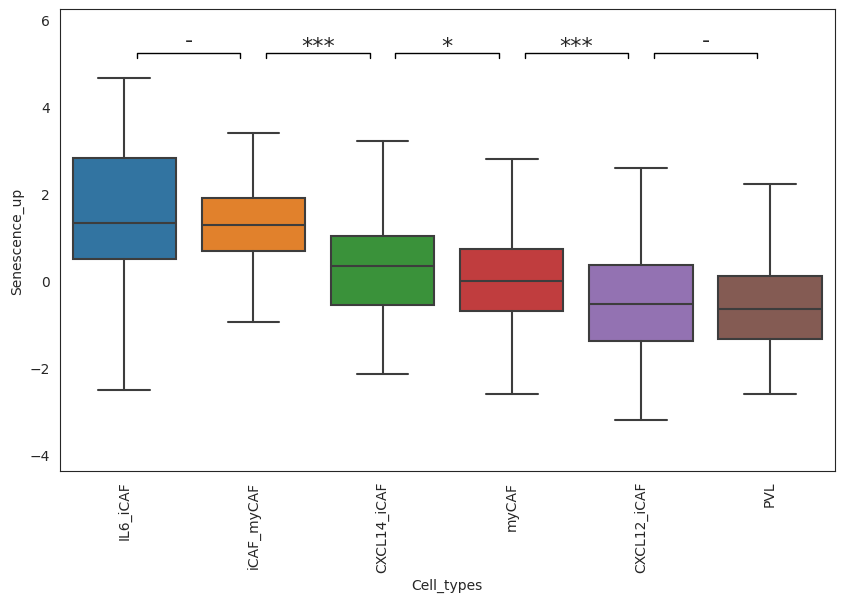

In [ ]:
ax = boxplot_with_pvalue(
    cprocesses_sc[signature_name],
    df_all["Cell_types"],
    order=df_median.index,
    swarm=False,
    figsize=[10, 6],
)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.show()

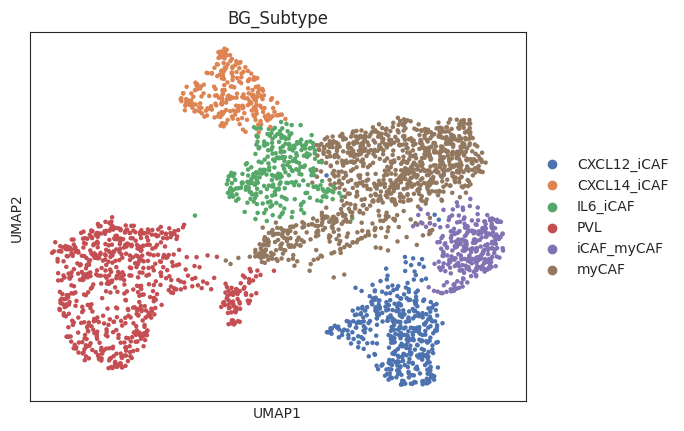

In [293]:
sc.pl.umap(adata, color=[celltype_col])

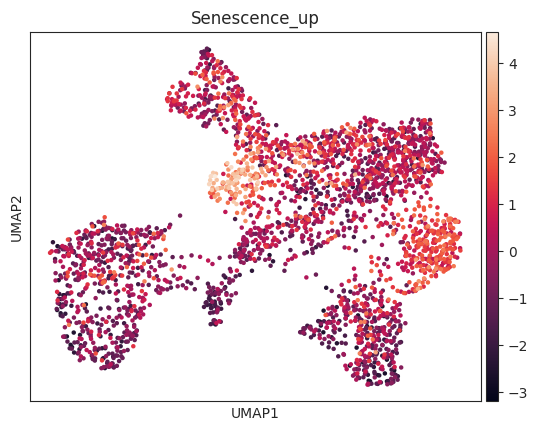

In [ ]:
# umap with ssgsea score
adata.obs[signature_name] = cprocesses_sc[signature_name]
sc.pl.umap(adata, color=[signature_name])

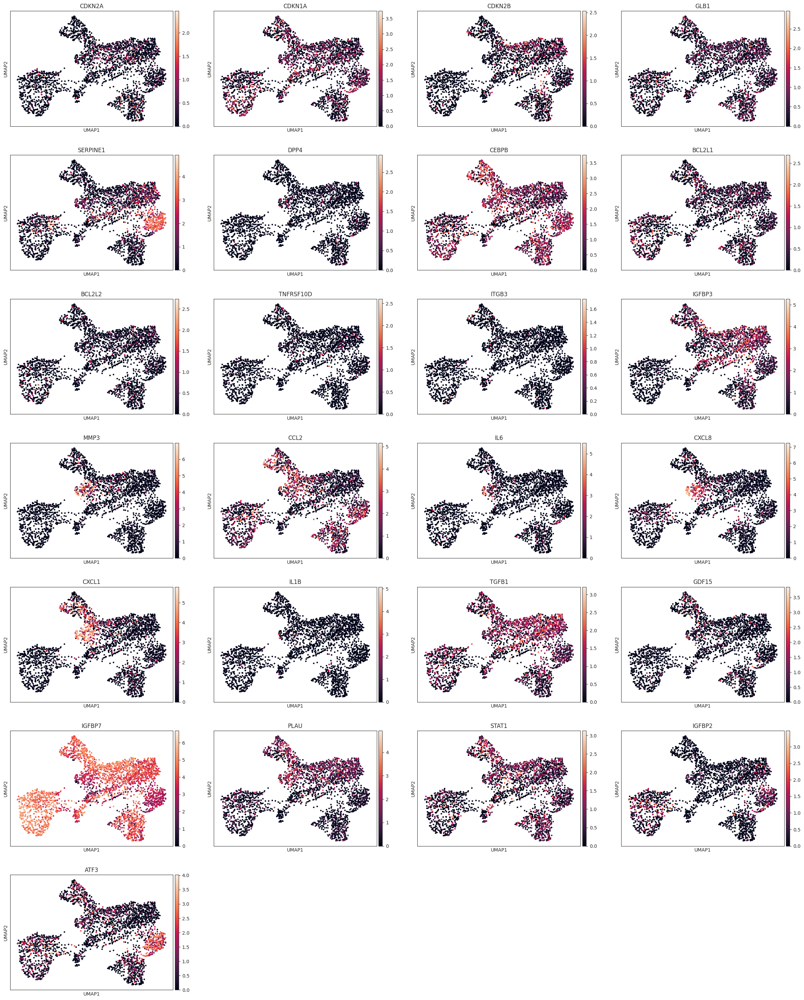

In [ ]:
# umap with custom genes (ln expressions)
genes_of_interest = signature_of_interest
sc.pl.umap(adata, color=genes_of_interest)

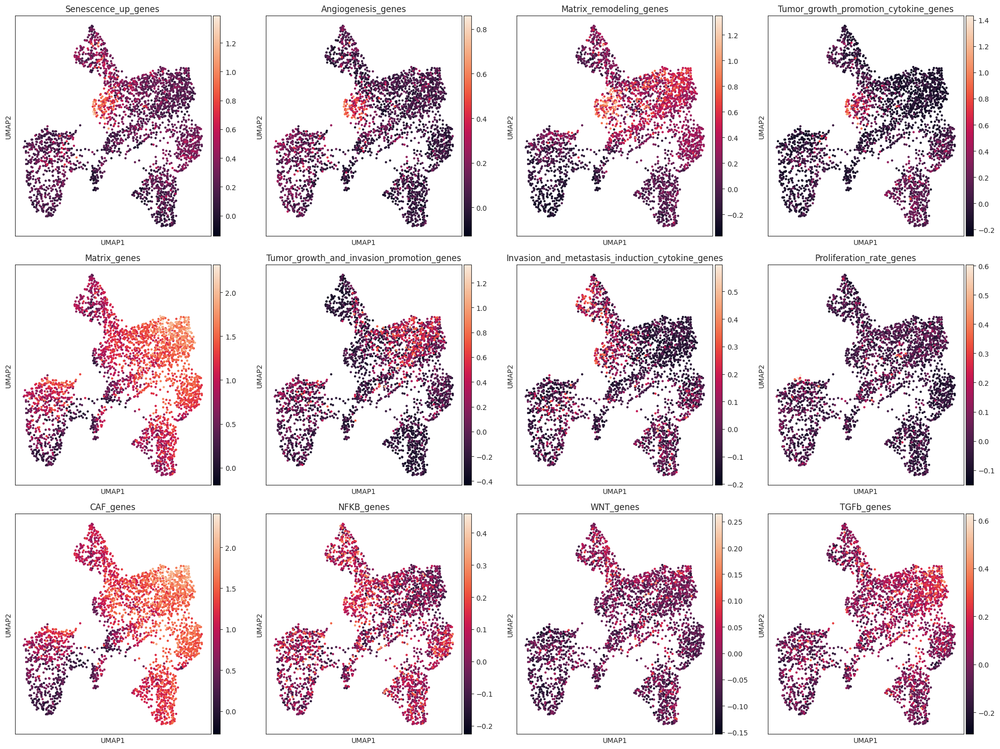

In [ ]:
CHESS_CAF_genes = [
    "LGALS1",
    "COL1A1",
    "COL1A2",
    "COL5A1",
    "ACTA2",
    "FGF2",
    "FAP",
    "LRP1",
    "CD248",
    "COL6A1",
    "COL6A2",
    "COL6A3",
    "COL11A1",
    "CXCL12",
    "FBLN1",
    "LUM",
    "MFAP5",
    "MMP3",
    "MMP2",
    "PDGFRB",
    "PDGFRA",
    "FN1",
]

matrix_genes = [
    "FN1",
    "COL1A1",
    "COL1A2",
    "COL4A1",
    "COL3A1",
    "VTN",
    "LGALS7",
    "LGALS9",
    "LAMA3",
    "LAMB3",
    "LAMC2",
    "TNC",
    "ELN",
    "COL5A1",
    "COL11A1",
    "LGALS3",
    "VCAN",
]

matrix_remodeling_genes = [
    "CA9",
    "MMP9",
    "MMP2",
    "MMP1",
    "MMP3",
    "MMP12",
    "MMP7",
    "MMP11",
    "PLOD2",
    "ADAMTS4",
    "ADAMTS5",
    "LOX",
]

angiogenesis_genes = [
    "VEGFA",
    "VEGFB",
    "VEGFC",
    "PDGFC",
    "CXCL8",
    "CXCR2",
    "FLT1",
    "PGF",
    "CXCL5",
    "KDR",
    "ANGPT1",
    "ANGPT2",
    "TEK",
    "VWF",
    "CDH5",
]

senescence_genes = [
    "CDKN2A",
    "CDKN1A",
    "CDKN2B",
    "GLB1",
    "SERPINE1",
    "DPP4",
    "CEBPB",
    "BCL2L1",
    "BCL2L2",
    "TNFRSF10D",
    "ITGB3",
    "IGFBP3",
    "MMP3",
    "CCL2",
    "IL6",
    "CXCL8",
    "CXCL1",
    "IL1B",
    "TGFB1",
    "GDF15",
    "IGFBP7",
    "PLAU",
    "STAT1",
    "IGFBP2",
    "ATF3",
]

tumor_growth_and_invasion_promotion_genes = [
    "IGFBP2",
    "PNPLA2",
    "MMP11",
    "UCP1",
    "CIDEA",
]

tumor_growth_promotion_cytokine_genes = [
    "IL1B",
    "TNF",
    "IL6",
    "IL33",
    "CCL2",
    "CXCL8",
    "CCL5",
    "CCL20",
    "CXCL12",
    "CX3CL1",
    "CCL3",
    "CCR5",
    "CCR7",
]

invasion_and_metastasis_induction_cytokine_genes = [
    "IL6",
    "OSM",
    "IL1B",
    "CCL2",
    "CCL5",
    "CCL8",
    "CCL17",
    "CCL18",
    "CCR4",
    "CCR5",
    "CCR6",
    "CCR7",
    "CXCR4",
    "ACKR3",
]

proliferation_genes = [
    "MKI67",
    "ESCO2",
    "CETN3",
    "CDK2",
    "CCND1",
    "CCNE1",
    "AURKA",
    "AURKB",
    "E2F1",
    "MYBL2",
    "BUB1",
    "PLK1",
    "CCNB1",
    "MCM2",
    "MCM6",
]

nfkb_genes = [
    "CD40",
    "TNFRSF11A",
    "TNFRSF8",
    "TRAF2",
    "IKBKG",
    "CHUK",
    "PDPK1",
    "NFKB1",
    "NFKBIA",
    "NFKBIE",
    "TRAF3",
    "RELA",
    "IKBKB",
    "TRAF6",
    "MAP3K7",
    "REL",
    "NFKB2",
]

wnt_genes = [
    "CTNNB1",
    "DVL1",
    "DVL2",
    "DVL3",
    "FRAT1",
    "FRAT2",
    "FZD1",
    "FZD10",
    "FZD2",
    "FZD3",
    "FZD4",
    "FZD5",
    "FZD6",
    "FZD7",
    "FZD8",
    "FZD9",
    "LEF1",
    "LGR4",
    "LGR5",
    "LRP5",
    "LRP6",
    "PORCN",
    "RSPO1",
    "WNT1",
    "WNT10A",
    "WNT10B",
    "WNT11",
    "WNT16",
    "WNT2",
    "WNT3A",
    "WNT4",
    "WNT5A",
    "WNT5B",
    "WNT6",
    "WNT7A",
    "WNT7B",
    "WNT8A",
    "WNT8B",
    "WNT9A",
    "WNT9B",
    "LGR6",
    "WNT2B",
    "WNT3",
]

tgfb_genes = [
    "TGFBR1",
    "TGFBR2",
    "ACVR2A",
    "ACVR1B",
    "SMAD2",
    "SMAD3",
    "SMAD4",
    "ACVR1C",
    "ACVR2B",
    "ZFYVE9",
    "TGFB1",
    "TGFB2",
    "TGFB3",
    "INHBA",
    "INHBB",
]

CHESS_CAF_signature = GeneSet("CHESS_CAF_genes", "desc", CHESS_CAF_genes)
matrix_signature = GeneSet("matrix_genes", "desc", matrix_genes)
matrix_remodeling_signature = GeneSet(
    "matrix_remodeling_genes", "desc", matrix_remodeling_genes
)
angiogenesis_signature = GeneSet("angiogenesis_genes", "desc", angiogenesis_genes)
senescence_signature = GeneSet("senescence_genes", "desc", senescence_genes)
tumor_growth_and_invasion_promotion_signature = GeneSet(
    "tumor_growth_and_invasion_promotion_genes",
    "desc",
    tumor_growth_and_invasion_promotion_genes,
)
tumor_growth_promotion_cytokine_signature = GeneSet(
    "tumor_growth_promotion_cytokine_genes",
    "desc",
    tumor_growth_promotion_cytokine_genes,
)
invasion_and_metastasis_induction_cytokine_signature = GeneSet(
    "invasion_and_metastasis_induction_cytokine_genes",
    "desc",
    invasion_and_metastasis_induction_cytokine_genes,
)
proliferation_signature = GeneSet("proliferation_genes", "desc", proliferation_genes)
nfkb_signature = GeneSet("NFKB_genes", "desc", nfkb_genes)
wnt_signature = GeneSet("WNT_genes", "desc", wnt_genes)
tgfb_signature = GeneSet("TGFb_genes", "desc", tgfb_genes)

TNBC_CAF_types_sig = {
    "Senescence_up_genes": senescence_signature,
    "Angiogenesis_genes": angiogenesis_signature,
    "Matrix_remodeling_genes": matrix_remodeling_signature,
    "Tumor_growth_promotion_cytokine_genes": tumor_growth_promotion_cytokine_signature,
    "Matrix_genes": matrix_signature,
    "Tumor_growth_and_invasion_promotion_genes": tumor_growth_and_invasion_promotion_signature,
    "Invasion_and_metastasis_induction_cytokine_genes": invasion_and_metastasis_induction_cytokine_signature,
    "Proliferation_rate_genes": proliferation_signature,
    "CAF_genes": CHESS_CAF_signature,
    "NFKB_genes": nfkb_signature,
    "WNT_genes": wnt_signature,
    "TGFb_genes": tgfb_signature,
}

fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(20, 15))
axes = axes.flatten()

keys = list(TNBC_CAF_types_sig.keys())

for ax, signature in zip(axes, keys):

    geneset = TNBC_CAF_types_sig[signature].genes
    sc.tl.score_genes(adata, gene_list=geneset, score_name=signature, use_raw=True)
    sc.pl.umap(adata, color=signature, show=False, ax=ax)

plt.tight_layout()
plt.show()

# Venn diagram

In [299]:
%matplotlib inline
import venn

In [ ]:
senescence = set(
    [
        "CDKN2A",
        "CDKN1A",
        "CDKN2B",
        "GLB1",
        "SERPINE1",
        "DPP4",
        # 'NOX4',
        "CEBPB",
        # 'BHLHE40',
        "BCL2L1",
        "BCL2L2",
        "TNFRSF10D",
        # 'CAV1',
        "ITGB3",
        "IGFBP3",
        "MMP3",
        "CCL2",
        "IL6",
        "CXCL8",
        "CXCL1",
        "IL1B",
        "TGFB1",
        "GDF15",
        "IGFBP7",
        "PLAU",
        "STAT1",
        "IGFBP2",
        "ATF3",
    ]
)
fridman = set(
    """ALDH1A3	CCND1	CD44	CDKN1A	CDKN1C	CDKN2A	CDKN2B	CDKN2D	CITED2	CLTB	COL1A2	CREG1	CRYAB	CXCL14	CYP1B1	EIF2S2	ESM1	F3	FILIP1L	FN1	GSN	GUK1	HBS1L	HPS5	HSPA2	HTATIP2	IFI16	IFNG	IGFBP1	IGFBP2	IGFBP3	IGFBP4	IGFBP5	IGFBP6	IGFBP7	IGSF3	ING1	IRF5	IRF7	ISG15	MAP1LC3B	MAP2K3	MDM2	MMP1	NDN	NME2	NRG1	OPTN	PEA15	RAB13	RAB31	RAB5B	RABGGTA	RAC1	RBL2	RGL2	RHOB	RRAS	S100A11	SERPINB2	SERPINE1	SMPD1	SMURF2	SOD1	SPARC	STAT1	TES	TFAP2A	TGFB1I1	THBS1	TNFAIP2	TNFAIP3	TP53	TSPYL5	VIM""".split(
        "\t"
    )
)
casella = set(
    """ARRDC4	BLCAP	CCND3	CHPF2	CLDN1	CLSTN2	DHRS7	DIO2	ELMOD1	FAM234B	FILIP1L	GPR155	H2AFJ	JCAD	KIAA1671	LRP10	NCSTN	PAM	PDLIM1	PLOD1	POFUT2	PTCHD4	RND3	SAMD9L	SARAF	SLC16A14	SLC9A7	SLCO2B1	SMCO3	SRPX	SRPX2	STAT1	TAP1	TMEM159	TMEM30A	TMEM59	TNFRSF10C	TNFSF13B	WDR63	WDR78""".split(
        "\t"
    )
)
hernandez = set(
    """ACADVL	ADPGK	B4GALT7	BCL2L2	CCND1	CHMP5	DDA1	DGKA	DYNLT3	FAM214B	GBE1	GDNF	KLC1	MT-CYB	NOL3	P4HA2	PDLIM4	PLK3	PLXNA3	POFUT2	RAI14	SCOC	SLC10A3	SLC16A3	SUSD6	TAF13	TMEM87B	TOLLIP	TSPAN13	UFM1	ZBTB7A	ZNHIT1""".split(
        "\t"
    )
)
purcell = set(
    """APOL1	GBP4	COL17A1	GNG11	BIRC3	CTSS	EPSTI1	S1PR3	PMAIP1	TNFAIP3	APOL3	DUSP6	LCP1	ATF3	RSPO3	IDO1	LGALS9	CD163L1	MLKL	MYD88	BATF2	OASL	RTP4	C3	ISG20	CXCL2	ICAM1	IFI27	IL1B	GCA	IL32	IL1A	CD82	MMP12	IL1RN	HERC5	TNFAIP6	TNFRSF1B	PLAU	IFI30	CLDN1	CCDC80	NEGR1	ODZ2	GMPR	ITGB3	SCN3A	CYP1A1""".split(
        "\t"
    )
)

Suppl figure 3A

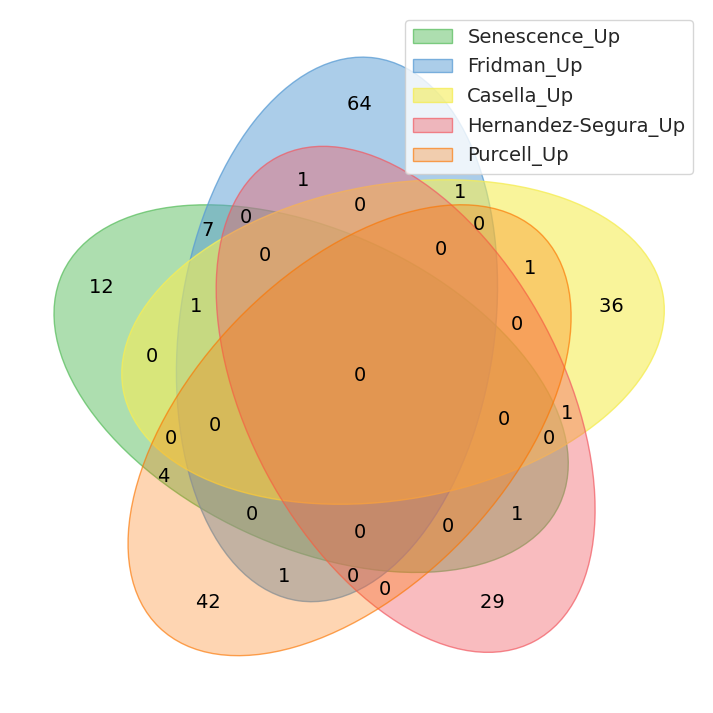

In [ ]:
labels = venn.get_labels(
    [senescence, fridman, casella, hernandez, purcell], fill=["number"]
)
fig, ax = venn.venn5(
    labels,
    names=[
        "Senescence_Up",
        "Fridman_Up",
        "Casella_Up",
        "Hernandez-Segura_Up",
        "Purcell_Up",
    ],
)
# fig.rcParams['svg.fonttype'] = 'none'
fig.savefig(
    "/uftp/users/msavchenko/figures/Senescence_signatures_venn.svg", format="svg"
)
fig.show()